In [2]:
from astropy.table import Table
from dendrocat import RadioSource
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from scipy import interpolate
import pandas as pd
import sympy as syp
from astropy import units as u
import radio_beam
from astropy.table import Table
from radio_beam import Beam
from astropy import coordinates
from astropy import wcs
from astropy.nddata.utils import Cutout2D
from dendrocat.aperture import Ellipse
from astropy.io import ascii
import astropy.constants as c

from functools import reduce
from itertools import chain
import Paths.Paths as paths

Path = paths.filepaths()


class core_catdata():
    def __init__(self,catfile, almaimf_beam, hrfits, band='B3', recommend_criteria='b6',corr_factor_max=4, ):
        catdata_w51e = ascii.read(catfile,data_start=0,format='commented_header', header_start=120,  comment="!")
        geo_avg_beam = np.sqrt(almaimf_beam.major.to(u.arcsec).value*almaimf_beam.minor.to(u.arcsec).value)
        corr_factor = catdata_w51e['AFWHM02'] * catdata_w51e['BFWHM02'] / catdata_w51e['AFWHM03'] / catdata_w51e['BFWHM03']
        rescaled_3mmflux = catdata_w51e['FXT_BST03'] * corr_factor
        """
        #isdetectedB3 = np.where((catdata_w51e['SIGNM03']>0.1)&
                                (catdata_w51e['FXP_BST03']>0)&
                                (catdata_w51e['FXT_BST03']>0)&
                                (corr_factor>=1/corr_factor_max)&
                                (corr_factor<=corr_factor_max))[0]
        #print(len(np.where(isdetectedB3)[0]), len(catdata_w51e['SIGNM03']))                    
        """ 
        gamma = np.log10(catdata_w51e['FXT_BST02'] / rescaled_3mmflux)/np.log10(228.918/101.426)
        self.rec_ind_b6 = np.where((np.abs(catdata_w51e['GOODM02'])>1)&
                           (np.abs(catdata_w51e['SIGNM02'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (gamma>2)
                           )[0]
        self.rec_ind_b6b3 = np.where((np.abs(catdata_w51e['GOODM02'])>1)&
                           (np.abs(catdata_w51e['SIGNM02'])>1)&
                           (catdata_w51e['FXP_BST02']/catdata_w51e['FXP_ERR02']>2)&
                           (catdata_w51e['FXT_BST02']/catdata_w51e['FXT_ERR02']>2)&
                           (catdata_w51e['AFWHM02']/catdata_w51e['BFWHM02']<2)&
                           (catdata_w51e['FOOA02']/catdata_w51e['AFWHM02']>1.15)&
                           (np.sqrt(catdata_w51e['AFWHM03']*catdata_w51e['BFWHM03']) <4 * geo_avg_beam )&
                           (catdata_w51e['AFWHM03']/catdata_w51e['BFWHM03']<=2)&
                           (np.abs(catdata_w51e['SIGNM03'])>1)&
                           (catdata_w51e['FXP_BST03']/catdata_w51e['FXP_ERR03']>1)&
                           (catdata_w51e['FXT_BST03']/catdata_w51e['FXT_ERR03']>1)&
                           (gamma>2)
                           )[0]
        if recommend_criteria == 'b6':
            rec_ind_prep = self.rec_ind_b6
        elif recommend_criteria == 'b6b3':
            rec_ind_prep = self.rec_ind_b6b3

        

       
        yso_image = fits.open(hrfits)[0].data[0][0]
        hrhdr = fits.open(hrfits)[0].header
        inside_idx = exist_inside_FOV(catdata_w51e['WCS_ACOOR'], catdata_w51e['WCS_DCOOR'], yso_image, hrhdr)
   
        rec_ind = np.intersect1d(rec_ind_prep, inside_idx)
        print('total core number = ', len(catdata_w51e['WCS_ACOOR']))
        print(hrfits)
        print('robust %s measurement before applying FoV criteria = '%recommend_criteria, len(rec_ind_prep))
        print('robust %s measurement after applying FoV criteria = '%recommend_criteria, len(rec_ind))
       
        self.sky_ra = catdata_w51e['WCS_ACOOR'][rec_ind]
        slf.sky_dec = catdata_w51e['WCS_DCOOR'][rec_ind]
        self.pix_x = catdata_w51e['XCO_P'][rec_ind]
        self.pix_y = catdata_w51e['YCO_P'][rec_ind]
        
        if band=='B3':
            bandind = 3
        else:
            bandind = 2

        self.afwhm = catdata_w51e['AFWHM0%d'%bandind][rec_ind] #arcsec
        self.bfwhm = catdata_w51e['BFWHM0%d'%bandind][rec_ind]

        self.asize = catdata_w51e['ASIZE0%d'%bandind][rec_ind]
        self.bsize = catdata_w51e['BSIZE0%d'%bandind][rec_ind]

        self.theta = catdata_w51e['THETA0%d'%bandind][rec_ind]
        
        self.flux = catdata_w51e['FXT_BST0%d'%bandind][rec_ind]
        self.fluxerr = catdata_w51e['FXT_ERR0%d'%bandind][rec_ind]
        self.flux_g = catdata_w51e['FXT_ALT0%d'%bandind][rec_ind]

        self.fooa = catdata_w51e['FOOA0%d'%bandind][rec_ind]
        self.foob = catdata_w51e['FOOB0%d'%bandind][rec_ind]
        
        self.int_peak = catdata_w51e['FXP_BST0%d'%bandind][rec_ind]
        self.interr_peak = catdata_w51e['FXP_ERR0%d'%bandind][rec_ind]
        
        self.size = (catdata_w51e['AFWHM0%d'%bandind][rec_ind]*catdata_w51e['BFWHM0%d'%bandind][rec_ind]**2)**(1/3)


        self.no = catdata_w51e['NO'][rec_ind]

        
        
        rescaled_3mmflux = catdata_w51e['FXT_BST03'][rec_ind] * catdata_w51e['AFWHM02'][rec_ind] * catdata_w51e['BFWHM02'][rec_ind] / catdata_w51e['AFWHM03'][rec_ind]/catdata_w51e['BFWHM03'][rec_ind]
        gamma = np.log10(catdata_w51e['FXT_BST02'][rec_ind] / rescaled_3mmflux)/np.log10(228.918/101.426)
        self.woffind = np.where(gamma>2)[0]
        self.wffind = np.where(gamma<2)[0]
        self.rec_ind = rec_ind

        
    def get_temperature(self,tempfile,threshold=2e-4):
        tab = ascii.read(tempfile, data_start=4)
        ra = tab['col2']
        dec = tab['col3']
        temp = tab['col4']

        temparr = []
        for i in range(len(self.sky_ra)):
            dist = np.sqrt((self.sky_ra[i]-ra)**2+(self.sky_dec[i]-dec)**2) #deg
            mindist = np.min(dist)
            if mindist<threshold:
                index = np.argmin(dist)
                temparr.append(temp[index])
            else:
                temparr.append(np.nan)
        self.temp = np.array(temparr)*u.K
        return np.array(temparr)
    
    def get_coremass(self,freq, kappa, dist):
       
        mass = - 1 / kappa * dist**2 * self.flux  / self.int_peak * np.log(1 - (self.int_peak *u.Jy  / BB(freq,self.temp)).to(u.cm/u.cm).value)
        self.mass = mass.to(u.Msun)
        return mass.to(u.Msun)
    
    def get_coremasserr(self):
        
        masserr = np.abs(self.mass * np.sqrt((self.fluxerr/self.flux)**2+(self.interr_peak/self.int_peak)**2))
        self.masserr = masserr
        return masserr.to(u.Msun)   
    def get_Jeansmass(self, dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3) #arcsec -> au
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)
        c_s = np.sqrt(c.k_B*self.temp/2.8/c.m_p)
        jeans_mass = np.pi**(5/2)/6/c.G**(3/2) * c_s.to(u.cm/u.s)**3 * rho.to(u.g/u.cm**3)**(-1/2)
        
        return jeans_mass.to(u.Msun)

    def get_Jeansmasserr(self,dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3) #arcsec -> au
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)
        c_s = np.sqrt(c.k_B*self.temp/2.8/c.m_p)
        jeans_mass = np.pi**(5/2)/6/c.G**(3/2) * c_s.to(u.cm/u.s)**3 * rho.to(u.g/u.cm**3)**(-1/2)
        rho_err = self.masserr / (4/3*np.pi * (rad*u.au)**3)

        jeans_mass_err = 0.5*jeans_mass * (rho_err/rho)

        return jeans_mass_err.to(u.Msun)
    def get_BE_mass(self, dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3)
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)

        BE_mass = 1.18 * np.sqrt((c.k_B*self.temp/2.33/c.m_p/c.G)**3/rho).to(u.Msun)
        return BE_mass.to(u.Msun)
    
    def get_BE_masserr(self, dist=5410):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3)
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)

        BE_mass = 1.18 * np.sqrt((c.k_B*self.temp/2.33/c.m_p/c.G)**3/rho).to(u.Msun)
        rho_err = self.masserr / (4/3*np.pi * (rad*u.au)**3)

        BE_mass_err = 0.5*BE_mass * (rho_err/rho)
        return BE_mass_err.to(u.Msun)
    
    
    def multiplicity(self, hdrhr, xysource, almaimf_beam=None,issky=True, label=None,
                 aperture='fwhm+beam',limitarea=None,  maxrad=1e3, verbose=False):
        ncat = len(self.no)
        if limitarea is not None:
            posind = np.where((sky_ra>limitarea[0])&(sky_ra<limitarea[1])&
                              (sky_dec>limitarea[2])&(sky_dec<limitarea[3]))[0]
        else:
            posind = np.arange(ncat)
        if label is None:
            label=np.arange(ncat)
        coreidx = np.arange(ncat)

        totalind = np.intersect1d(posind, label)
        print('totalind',totalind)
        sky_ra = self.sky_ra[totalind]
        sky_dec = self.sky_dec[totalind]
        fooa = self.fooa[totalind]
        foob = self.foob[totalind]
        theta = self.theta[totalind]
        no = self.no[totalind]
        afwhm =self.afwhm[totalind]
        bfwhm = self.bfwhm[totalind]

        skypos = np.vstack((sky_ra,sky_dec)).T


        wcshr = WCS(hdrhr,naxis=2)
        scalehr = wcshr.proj_plane_pixel_scales()[0]

        xypos_core = wcshr.wcs_world2pix(skypos,0)
        xpos_core = xypos_core[:,0]
        ypos_core = xypos_core[:,1]

        if issky:
            xysource_pix = wcshr.wcs_world2pix(xysource,0)
        else:
            xysource_pix = xysource
        ysonumarr=[] ; coreindarr=[]; ysoindarr=[]
        prestellar_ind = []
        protostellar_ind = []
        #print(xysource)
        for i in range(len(xypos_core)):
            if aperture is 'footprint':
                major = fooa[i]/3600/scalehr.value
                minor = foob[i]/3600/scalehr.value
                pa = theta[i]+90
            elif aperture is 'fwhm+beam':
                meanbeamsize = (almaimf_beam.major.value+almaimf_beam.minor.value)/4
                major = (afwhm[i]/3600+meanbeamsize)/scalehr.value
                minor = (bfwhm[i]/3600+meanbeamsize)/scalehr.value
                pa = theta[i]+90
            elif aperture is 'beam':
                major = almaimf_beam.major.value/scalehr.value
                minor = almaimf_beam.minor.value/scalehr.value
                pa = almaimf_beam.pa.value+90
            #if major > maxrad:
            #    continue

            numsource, indsource = count_points_in_ellipse(xpos_core[i],ypos_core[i],major,minor,pa,xysource_pix[:,0],xysource_pix[:,1])
            print(totalind[i], indsource, numsource)
            ysonumarr.append(numsource)
            coreindarr.append(totalind[i])
            ysoindarr.append(indsource)
            if numsource==0:
                prestellar_ind.append(totalind[i])
            elif numsource>0:
                protostellar_ind.append(totalind[i])
            
            
      
        ysoindarr_flat = []
        for arr in ysoindarr:
            ysoindarr_flat.extend(arr)
       
        print('cores with/without YSOs ', len(np.where(np.array(ysonumarr)!=0)[0]), len(xpos_core)-len(np.where(np.array(ysonumarr)!=0)[0]))
        print('YSOs associated with cores',len(np.unique(ysoindarr_flat)),' out of ',len(xysource_pix[:,0]))
              
        self.ysonumarr = ysonumarr
        self.coreindarr = coreindarr
        self.ysoindarr = ysoindarr
        self.prestellar_ind = prestellar_ind
        self.protostellar_ind = protostellar_ind
        print('pre,pro',self.prestellar_ind, self.protostellar_ind)
        return ysonumarr, coreindarr, ysoindarr, prestellar_ind, protostellar_ind
        
        
    
        
        
    

                
            
def BB(freq, temp):
    B_nu = (2 * freq**3 *c.h / (c.c**2) * 1 / (np.e**(c.h*freq/(c.k_B*temp))-1))
    return B_nu        

def kappa(nu, nu0=271.1*u.GHz, kappa0=0.0114*u.cm**2*u.g**-1, beta=1.75):
    """
    Compute the opacity $\kappa$ given a reference frequency (or wavelength)
    and a power law governing the opacity as a fuction of frequency:
    $$ \kappa = \kappa_0 \left(\\frac{\\nu}{\\nu_0}\\right)^{\\beta} $$
    The default kappa=0.0114 at 271.1 GHz comes from extrapolating the
    Ossenkopf & Henning 1994 opacities for the thin-ice-mantle, 10^6 year model
    anchored at 1.0 mm with an assumed beta of 1.75.
    Parameters
    ----------
    nu: astropy.Quantity [u.spectral() equivalent]
        The frequency at which to evaluate kappa
    nu0: astropy.Quantity [u.spectral() equivalent]
        The reference frequency at which $\kappa$ is defined
    kappa0: astropy.Quantity [cm^2/g]
        The dust opacity per gram of H2 along the line of sight.  Because of
        the H2 conversion, this factor implicitly includes a dust to gas ratio
        (usually assumed 100)
    beta: float
        The power-law index governing kappa as a function of nu
    """
    return (kappa0*(nu.to(u.GHz,u.spectral())/nu0.to(u.GHz,u.spectral()))**(beta)).to(u.cm**2/u.g)        

     
"""
def get_BEmass(major, minor, temp ):
    rad = (major * minor**2)**(1/3)
    sigma_th = np.sqrt(c.k_B*temp*u.K/(2.4*c.m_p))
    return (2.4*rad*u.au*sigma_th**2/c.G).to(u.Msun)


"""
def count_points_in_ellipse(xcen,ycen,major,minor,pa,xpos,ypos):
    # caclulate foci positions 
    # must be full major, minor not semi major, minor
    fodx = np.cos(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    fody = np.sin(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    
    fox1 = xcen + fodx
    foy1 = ycen + fody
    
    fox2 = xcen - fodx
    foy2 = ycen - fody
    
    dist1 = np.sqrt((xpos-fox1)**2+(ypos-foy1)**2)
    dist2 = np.sqrt((xpos-fox2)**2+(ypos-foy2)**2)
    
    isinside = np.where(dist1+dist2<major)[0]
    
    return len(isinside), list(isinside)



def exist_inside_FOV(xcore_sky, ycore_sky, yso_image, hrhdr):
    isfinite = np.where(np.isfinite(yso_image))
    xfinite1 = np.min(isfinite[0])
    xfinite2 = np.max(isfinite[0])
    yfinite1 = np.min(isfinite[1])
    yfinite2 = np.max(isfinite[1])
     
    xcen = (xfinite1 + xfinite2)/2
    ycen = (yfinite1 + yfinite2)/2

    wcs_hr = WCS(hrhdr,naxis=2)
    xypos = wcs_hr.wcs_world2pix(np.vstack((xcore_sky,ycore_sky)).T,0)
    
    rad = np.abs(xfinite2 - xcen)
    
    
    dist = np.sqrt((xypos[:,0]- xcen)**2+(xypos[:,1]-ycen)**2)
    isinside = np.where(dist<rad)[0]
    
    return isinside
     

<>:235: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:239: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:244: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:235: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:239: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:244: SyntaxWarning: "is" with a literal. Did you mean "=="?


In [3]:
fitsdata_b3 = fits.open(Path.w51e_b3_tt0)
image_b3_w51e = fitsdata_b3[0].data
if len(image_b3_w51e.shape)>2:
    image_b3_w51e = fitsdata_b3[0].data[0][0]
hdrB3_w51e_hr = fits.getheader(Path.w51e_b3_tt0)  
    
fitsdata_b3 = fits.open(Path.w51n_b3_tt0)
image_b3_w51n = fitsdata_b3[0].data
if len(image_b3_w51n.shape)>2:
    image_b3_w51n = fitsdata_b3[0].data[0][0]
hdrB3_w51n_hr = fits.getheader(Path.w51n_b3_tt0)  

fitsdata_b6 = fits.open(Path.w51e_b6_cont)
image_b6_w51e = fitsdata_b6[0].data
if len(image_b6_w51e.shape)>2:
    image_b6_w51e = fitsdata_b6[0].data[0][0]
hdrB6_w51e_hr = fits.getheader(Path.w51e_b6_cont)  
    
fitsdata_b6 = fits.open(Path.w51n_b6_cont)
image_b6_w51n = fitsdata_b6[0].data
if len(image_b6_w51n.shape)>2:
    image_b6_w51n = fitsdata_b6[0].data[0][0]
hdrB6_w51n_hr = fits.getheader(Path.w51n_b6_cont)  

hdrB6_w51e_almaimf = fits.getheader(Path.w51e_b6_almaimf)  
wcsB6_w51e_almaimf = WCS(hdrB6_w51e_almaimf,naxis=2)
beamb6_w51e_almaimf = Beam.from_fits_header(hdrB6_w51e_almaimf)  

hdrB3_w51e_almaimf = fits.getheader(Path.w51e_b3_almaimf)  
wcsB3_w51e_almaimf = WCS(hdrB3_w51e_almaimf,naxis=2)
beamb3_w51e_almaimf = Beam.from_fits_header(hdrB3_w51e_almaimf) 

hdrB6_w51n_almaimf = fits.getheader(Path.w51n_b6_almaimf)  
wcsB6_w51n_almaimf = WCS(hdrB6_w51n_almaimf,naxis=2)
beamb6_w51n_almaimf = Beam.from_fits_header(hdrB6_w51n_almaimf)  

hdrB3_w51n_almaimf = fits.getheader(Path.w51n_b3_almaimf)  
wcsB3_w51n_almaimf = WCS(hdrB3_w51n_almaimf,naxis=2)
beamb3_w51n_almaimf = Beam.from_fits_header(hdrB3_w51n_almaimf)  

freqb3=92982346121.91989*u.Hz
freqb6=226691598706.70853*u.Hz
kappa_b3 = kappa(freqb3)
kappa_b6 = kappa(freqb6)

core_catdata_w51e_b3_b6crit_b3fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b3_tt0)
core_catdata_w51e_b3_b6crit_b6fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b6_cont)

core_catdata_w51e_b6_b6crit_b3fov = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf, Path.w51e_b3_tt0,band='B6',)
core_catdata_w51e_b6_b6crit_b6fov = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf, Path.w51e_b6_cont, band='B6')

core_catdata_w51e_b3_b6b3crit_b3fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b3_tt0, recommend_criteria='b6b3')
core_catdata_w51e_b3_b6b3crit_b6fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b6_cont, recommend_criteria='b6b3')

core_catdata_w51e_b6_b6b3crit_b3fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b3_tt0, band='B6', recommend_criteria='b6b3')
core_catdata_w51e_b6_b6b3crit_b6fov = core_catdata(Path.w51e_almaimf_catalog, beamb3_w51e_almaimf, Path.w51e_b6_cont,band='B6', recommend_criteria='b6b3')

core_catdata_w51n_b3_b6crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,Path.w51n_b3_tt0)
core_catdata_w51n_b3_b6crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,Path.w51n_b6_cont)

core_catdata_w51n_b6_b6crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,Path.w51n_b3_tt0, band='B6')
core_catdata_w51n_b6_b6crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf,Path.w51n_b6_cont, band='B6')

core_catdata_w51n_b3_b6b3crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b3_tt0, recommend_criteria='b6b3')
core_catdata_w51n_b3_b6b3crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b6_cont, recommend_criteria='b6b3')

core_catdata_w51n_b6_b6b3crit_b3fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b3_tt0,band='B6', recommend_criteria='b6b3')
core_catdata_w51n_b6_b6b3crit_b6fov = core_catdata(Path.w51n_almaimf_catalog, beamb3_w51n_almaimf, Path.w51n_b6_cont, band='B6', recommend_criteria='b6b3')

"""
coretemp_w51e_b6crit = core_catdata_w51e_b6_b6crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51e_b6crit = core_catdata_w51e_b6_b6crit.get_temperature(Path.w51e_almaimf_coretemp)

coretemp_w51n_b6crit = core_catdata_w51n_b6_b6crit.get_temperature(Path.w51n_almaimf_coretemp)
coretemp_w51e_b6crit = core_catdata_w51e_b6_b6crit.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51n_b6crit = core_catdata_w51n_b6_b6crit.get_temperature(Path.w51n_almaimf_coretemp)

coremass_w51e = core_catdata_w51e_b6_b6crit.get_coremass(freqb6, kappa_b6, 5.41*u.kpc)
coremass_w51n = core_catdata_w51n_b6_b6crit.get_coremass(freqb6, kappa_b6, 5.1*u.kpc)
coremasserr_w51e = core_catdata_w51e_b6_b6crit.get_coremasserr()
coremasserr_w51n = core_catdata_w51n_b6_b6crit.get_coremasserr()
"""
#b3fov
"""
multiplicity_w51e_b3fov = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b3fov)

multiplicity_w51n_b3fov = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                
                                label=isinside_w51n_b3fov)

multiplicity_w51e_b6crit_b3fov = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b3fov_woff)
multiplicity_w51n_b3fov_woff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b3fov_woff)

multiplicity_w51e_b3fov_wff = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b3fov_wff)
multiplicity_w51n_b3fov_wff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b3fov_wff)

#b6fov
multiplicity_w51e_b6fov = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b6fov)
multiplicity_w51n_b6fov = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b6fov)

multiplicity_w51e_b6fov_woff = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b6fov_woff)
multiplicity_w51n_b6fov_woff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b6fov_woff)

multiplicity_w51e_b6fov_wff = core_catdata_w51e_b3.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,
                                 
                                 label=isinside_w51e_b6fov_wff)
multiplicity_w51n_b6fov_wff = core_catdata_w51n_b3.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,
                                 
                                label=isinside_w51n_b6fov_wff)

"""
catalog_w51e_yso = Table.read(Path.w51e_dendro_matched_catalog ,format='fits')
yso_w51e_xsky_b6 = catalog_w51e_yso['b6_xsky'] ; yso_w51e_ysky_b6 = catalog_w51e_yso['b6_ysky']
yso_w51e_xsky_b3 = catalog_w51e_yso['b3_xsky'] ; yso_w51e_ysky_b3 = catalog_w51e_yso['b3_ysky']

yso_detect_w51e_b6 = np.where(yso_w51e_xsky_b6>0)[0]
yso_detect_w51e_b3 = np.where(yso_w51e_xsky_b3>0)[0]


catalog_w51n_yso = Table.read(Path.w51n_dendro_matched_catalog ,format='fits')
yso_w51n_xsky_b6 = catalog_w51n_yso['b6_xsky'] ; yso_w51n_ysky_b6 = catalog_w51n_yso['b6_ysky']
yso_w51n_xsky_b3 = catalog_w51n_yso['b3_xsky'] ; yso_w51n_ysky_b3 = catalog_w51n_yso['b3_ysky']


yso_xsky_w51e = []
for i,x in enumerate(yso_w51e_xsky_b6):
    if x > 0:
        yso_xsky_w51e.append(x)
    else:
        yso_xsky_w51e.append(yso_w51e_xsky_b3[i])
yso_ysky_w51e = []
for i,x in enumerate(yso_w51e_ysky_b6):
    if x > 0:
        yso_ysky_w51e.append(x)
    else:
        yso_ysky_w51e.append(yso_w51e_ysky_b3[i])

yso_xsky_w51n = []
for i,x in enumerate(yso_w51n_xsky_b6):
    if x > 0:
        yso_xsky_w51n.append(x)
    else:
        yso_xsky_w51n.append(yso_w51n_xsky_b3[i])
yso_ysky_w51n = []
for i,x in enumerate(yso_w51n_ysky_b6):
    if x > 0:
        yso_ysky_w51n.append(x)
    else:
        yso_ysky_w51n.append(yso_w51n_ysky_b3[i])
"""
#whether the core is inside the FOV
isinside_w51e_b3fov_b6crit = exist_inside_FOV(core_catdata_w51e_b6_b6crit.sky_ra, core_catdata_w51e_b6_b6crit.sky_dec, image_b3_w51e, hdrB3_w51e_hr) 
isinside_w51e_b6fov_b6crit = exist_inside_FOV(core_catdata_w51e_b6_b6crit.sky_ra, core_catdata_w51e_b6_b6crit.sky_dec, image_b6_w51e, hdrB6_w51e_hr)
isinside_w51n_b3fov_b6crit = exist_inside_FOV(core_sky_ra_w51n_b6, core_sky_dec_w51n_b6, image_b3_w51n, hdrB3_w51n_hr)
isinside_w51n_b6fov_b6crit = exist_inside_FOV(core_sky_ra_w51n_b6, core_sky_dec_w51n_b6, image_b6_w51n, hdrB6_w51n_hr)


#print('ho',isinside_w51e_b3)
isinside_w51e_b3fov_woff = np.intersect1d(isinside_w51e_b3fov,  core_catdata_w51e_b3.woffind)
isinside_w51n_b3fov_woff = np.intersect1d(isinside_w51n_b3fov,  core_catdata_w51n_b3.woffind)
isinside_w51e_b6fov_woff = np.intersect1d(isinside_w51e_b6fov,  core_catdata_w51e_b6.woffind)
isinside_w51n_b6fov_woff = np.intersect1d(isinside_w51n_b6fov,  core_catdata_w51n_b6.woffind)
#print(isinside_w51e_b3_woff)

isinside_w51e_b3fov_wff = np.intersect1d(isinside_w51e_b3fov,  core_catdata_w51e_b3.wffind)
isinside_w51n_b3fov_wff = np.intersect1d(isinside_w51n_b3fov,  core_catdata_w51n_b3.wffind)
isinside_w51e_b6fov_wff = np.intersect1d(isinside_w51e_b6fov,  core_catdata_w51e_b6.wffind)
isinside_w51n_b6fov_wff = np.intersect1d(isinside_w51n_b6fov,  core_catdata_w51n_b6.wffind)
"""

yso_xysource_w51e= np.vstack((yso_xsky_w51e, yso_ysky_w51e)).T
yso_xysource_w51n= np.vstack((yso_xsky_w51n, yso_ysky_w51n)).T

hdrhr_w51n_b3= fits.getheader(Path.w51n_b3_tt0) 
hdrhr_w51e_b3= fits.getheader(Path.w51e_b3_tt0) 
hdrhr_w51n_b6= fits.getheader(Path.w51n_b6_cont) 
hdrhr_w51e_b6= fits.getheader(Path.w51e_b6_cont) 

ysogroup_w51e = catalog_w51e_yso['group']
ysogroup_w51n = catalog_w51n_yso['group']


total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits
robust b6 measurement before applying FoV criteria =  18
robust b6 measurement after applying FoV criteria =  18
total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/w51e2.spw0thru19.14500.robust0.thr0.15mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits
robust b6 measurement before applying FoV criteria =  18
robust b6 measurement after applying FoV criteria =  10
total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits
robust b6 measurement before applying FoV criteria =  18
robust b6 measurement after applying FoV criteria =  18
total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/w51e2.spw0thru19.14500.robust0.thr0.15mJy.mfs.I.startmod.s

In [4]:
import seaborn as sns
import matplotlib as mpl
plt.rcParams['axes.labelsize']=25
plt.rcParams['xtick.labelsize']=25
plt.rcParams['ytick.labelsize']=25
plt.rcParams['axes.titlesize']=25
mpl.rcParams['axes.linewidth'] = 5
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['xtick.major.width'] = 4
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['xtick.minor.width'] = 2
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['ytick.major.width'] = 4
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['ytick.minor.width'] = 2
params = {"xtick.top": True, "ytick.right": True, "xtick.direction": "in", "ytick.direction": "in"}
plt.rcParams.update(params)
bins = np.arange(11)
"""
print(multiplicity_w51e_b3fov)
numarr_w51e = multiplicity_w51e_b3fov[0]
numarr_w51n = multiplicity_w51n_b3fov[0]
numarr_w51e_woff = multiplicity_w51e_b3fov_woff[0]
numarr_w51n_woff = multiplicity_w51n_b3fov_woff[0]

cmap = sns.color_palette("colorblind")

fig = plt.figure(figsize=(10,7))
ax1 = fig.add_axes([0.1,0.17,0.35,0.75])
ax2 = fig.add_axes([0.55,0.17,0.35,0.75])

#ax1.hist(numarr_w51e_b3fov, bins = bins, facecolor='none',edgecolor='b', histtype='step',label='W51-E',lw=4,alpha=0.8)
#ax1.hist(numarr_w51n_b3fov, bins = bins, facecolor='none',edgecolor='orange', histtype='step',label='W51-IRS2',lw=4,alpha=0.8)
ax1.hist(numarr_w51e, bins=bins, alpha=0.7, color=cmap[0], label='W51-E',lw=4, histtype='step',hatch='\\')
ax1.hist(numarr_w51n, bins=bins, alpha=0.7, color=cmap[1], label='W51-IRS2',lw=4, histtype='step')
ax2.hist(numarr_w51e_woff, bins=bins, alpha=0.7, color=cmap[0], label='W51-E',lw=4, histtype='step',hatch='\\')
ax2.hist(numarr_w51n_woff, bins=bins, alpha=0.7, color=cmap[1], label='W51-IRS2',lw=4, histtype='step')
print(np.histogram(numarr_w51e,bins=bins)[0],np.histogram(numarr_w51n,bins=bins)[0])
print(np.histogram(numarr_w51e_woff,bins=bins)[0],np.histogram(numarr_w51n_woff,bins=bins)[0])

ax1.set_xlabel('number of fragments')
ax2.set_xlabel('number of fragments')

ax1.set_ylabel('core number')
ax1.set_title('Total')
ax2.set_title('without free-free')
ax1.legend(fontsize=18)
ax1.set_ylim(0,55)
ax2.set_ylim(0,55)
ax1.set_xlim(-0.5,8.5)
ax2.set_xlim(-0.5,8.5)
ax1.set_xticks([0,2,4,6,8])
ax2.set_xticks([0,2,4,6,8])

plt.savefig('frag_count.pdf')
"""




'\nprint(multiplicity_w51e_b3fov)\nnumarr_w51e = multiplicity_w51e_b3fov[0]\nnumarr_w51n = multiplicity_w51n_b3fov[0]\nnumarr_w51e_woff = multiplicity_w51e_b3fov_woff[0]\nnumarr_w51n_woff = multiplicity_w51n_b3fov_woff[0]\n\ncmap = sns.color_palette("colorblind")\n\nfig = plt.figure(figsize=(10,7))\nax1 = fig.add_axes([0.1,0.17,0.35,0.75])\nax2 = fig.add_axes([0.55,0.17,0.35,0.75])\n\n#ax1.hist(numarr_w51e_b3fov, bins = bins, facecolor=\'none\',edgecolor=\'b\', histtype=\'step\',label=\'W51-E\',lw=4,alpha=0.8)\n#ax1.hist(numarr_w51n_b3fov, bins = bins, facecolor=\'none\',edgecolor=\'orange\', histtype=\'step\',label=\'W51-IRS2\',lw=4,alpha=0.8)\nax1.hist(numarr_w51e, bins=bins, alpha=0.7, color=cmap[0], label=\'W51-E\',lw=4, histtype=\'step\',hatch=\'\\\')\nax1.hist(numarr_w51n, bins=bins, alpha=0.7, color=cmap[1], label=\'W51-IRS2\',lw=4, histtype=\'step\')\nax2.hist(numarr_w51e_woff, bins=bins, alpha=0.7, color=cmap[0], label=\'W51-E\',lw=4, histtype=\'step\',hatch=\'\\\')\nax2.hist(

totalind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
0 [40] 1
1 [29, 30, 31, 32, 33, 34] 6
2 [52, 55, 58, 59, 60, 61] 6
3 [120] 1
4 [37, 102] 2
5 [1, 2, 3, 83] 4
6 [53, 57] 2
7 [45, 47] 2
8 [19, 20, 22, 23, 24, 90] 6
9 [70, 71, 82, 123] 4
10 [65] 1
11 [] 0
12 [118] 1
13 [127] 1
14 [35] 1
15 [129] 1
16 [132] 1
17 [] 0
cores with/without YSOs  16 2
YSOs associated with cores 40  out of  137
pre,pro [11, 17] [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15, 16]
totalind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60]
0 [10, 11, 13, 24] 4
1 [9] 1
2 [44, 45] 2
3 [19, 20, 30, 31] 4
4 [4, 8, 14] 3
5 [66] 1
6 [42] 1
7 [48, 49] 2
8 [] 0
9 [65] 1
10 [33, 34] 2
11 [36, 37, 38] 3
12 [] 0
13 [67] 1
14 [] 0
15 [25] 1
16 [0] 1
17 [] 0
18 [] 0
19 [] 0
20 [41] 1
21 [] 0
22 [57] 1
23 [] 0
24 [5] 1
25 [50] 1
26 [] 0
27 [] 0
28 [] 0
29 [] 0
30 [39] 1
31 [3

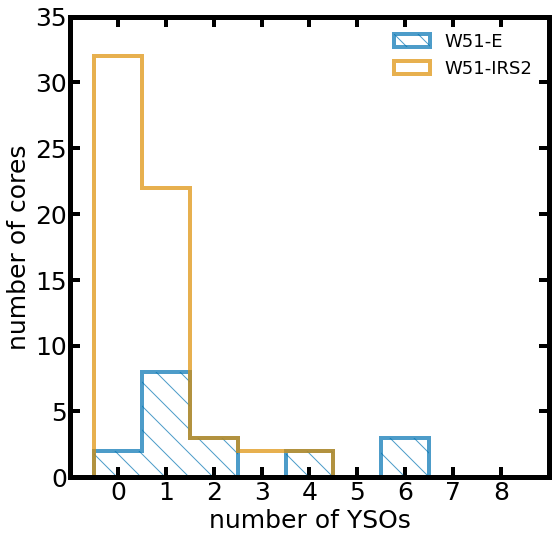

In [5]:
import seaborn as sns
import matplotlib as mpl
plt.rcParams['axes.labelsize']=25
plt.rcParams['xtick.labelsize']=25
plt.rcParams['ytick.labelsize']=25
plt.rcParams['axes.titlesize']=25
mpl.rcParams['axes.linewidth'] = 5
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['xtick.major.width'] = 4
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['xtick.minor.width'] = 2
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['ytick.major.width'] = 4
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['ytick.minor.width'] = 2
params = {"xtick.top": True, "ytick.right": True, "xtick.direction": "in", "ytick.direction": "in"}
plt.rcParams.update(params)
bins = np.arange(11)

multiplicity_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf)

multiplicity_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,)
numarr_w51e = multiplicity_w51e_b6crit_b3fov[0]
numarr_w51n = multiplicity_w51n_b6crit_b3fov[0]
print('ho',np.histogram(numarr_w51e, bins=bins)[0],np.histogram(numarr_w51n, bins=bins)[0])

#numarr_w51e_woff = multiplicity_w51e_b3fov_woff[0]
#numarr_w51n_woff = multiplicity_w51n_b3fov_woff[0]

cmap = sns.color_palette("colorblind")

fig = plt.figure(figsize=(8,8))
ax1 = fig.add_axes([0.15,0.17,0.83,0.8])

#ax1.hist(numarr_w51e_b3fov, bins = bins, facecolor='none',edgecolor='b', histtype='step',label='W51-E',lw=4,alpha=0.8)
#ax1.hist(numarr_w51n_b3fov, bins = bins, facecolor='none',edgecolor='orange', histtype='step',label='W51-IRS2',lw=4,alpha=0.8)
#ax1.hist(numarr_w51e, bins=bins, alpha=0.7, color=cmap[0], label='W51-E',lw=4, histtype='step',hatch='\\')
#ax1.hist(numarr_w51n, bins=bins, alpha=0.7, color=cmap[1], label='W51-IRS2',lw=4, histtype='step')
ax1.hist(numarr_w51e, bins=bins, alpha=0.7, color=cmap[0], label='W51-E',lw=4, histtype='step',hatch='\\', align='left')
ax1.hist(numarr_w51n, bins=bins, alpha=0.7, color=cmap[1], label='W51-IRS2',lw=4, histtype='step', align='left')

ax1.set_xlabel('number of YSOs')
#ax2.set_xlabel('number of fragments')

ax1.set_ylabel('number of cores')
#ax1.set_title('Total')
#ax2.set_title('without free-free')
ax1.legend(fontsize=18, frameon=False)
ax1.set_ylim(0,35)
#ax2.set_ylim(0,55)
ax1.set_xlim(-1,9)
#ax2.set_xlim(-0.5,8.5)
ax1.set_xticks([0,1,2,3,4,5,6,7,8])
#ax2.set_xticks([0,2,4,6,8])

plt.savefig('frag_count.pdf')

 
multiplicity_w51e_b6b3crit_b3fov = core_catdata_w51e_b6_b6b3crit_b3fov.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf)

multiplicity_w51n_b6b3crit_b3fov = core_catdata_w51n_b6_b6b3crit_b3fov.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,)


totalind [0 1 2 3 4 5 6 7 8 9]
0 [40] 1
1 [29, 30, 31, 32, 33, 34] 6
2 [52, 55, 58, 59, 60, 61] 6
3 [37, 102] 2
4 [1, 2, 3, 83] 4
5 [53, 57] 2
6 [45, 47] 2
7 [19, 20, 22, 23, 24, 90] 6
8 [65] 1
9 [35] 1
cores with/without YSOs  10 0
YSOs associated with cores 31  out of  137
pre,pro [] [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
totalind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16]
0 [10, 11, 13, 24] 4
1 [9] 1
2 [19, 20, 30, 31] 4
3 [4, 8, 14] 3
4 [] 0
5 [25] 1
6 [0] 1
7 [5] 1
8 [] 0
9 [21] 1
10 [1] 1
11 [] 0
12 [] 0
13 [] 0
14 [] 0
15 [22] 1
16 [] 0
cores with/without YSOs  10 7
YSOs associated with cores 18  out of  74
pre,pro [4, 8, 11, 12, 13, 14, 16] [0, 1, 2, 3, 5, 6, 7, 9, 10, 15]
plot_core_yso_all_frags
0.04866729341968129 8.959612116856016e-07
0.00525196964259134 2.464781228649977e-07
0.013735573669970589 7.340319058057402e-05
0.0038943612257362485 2.1058354025756319e-07
0.030484202743520792 4.8195400663484055e-05
0.027670524183772176 4.438385006931635e-06
0.0030438763848371123 5.3

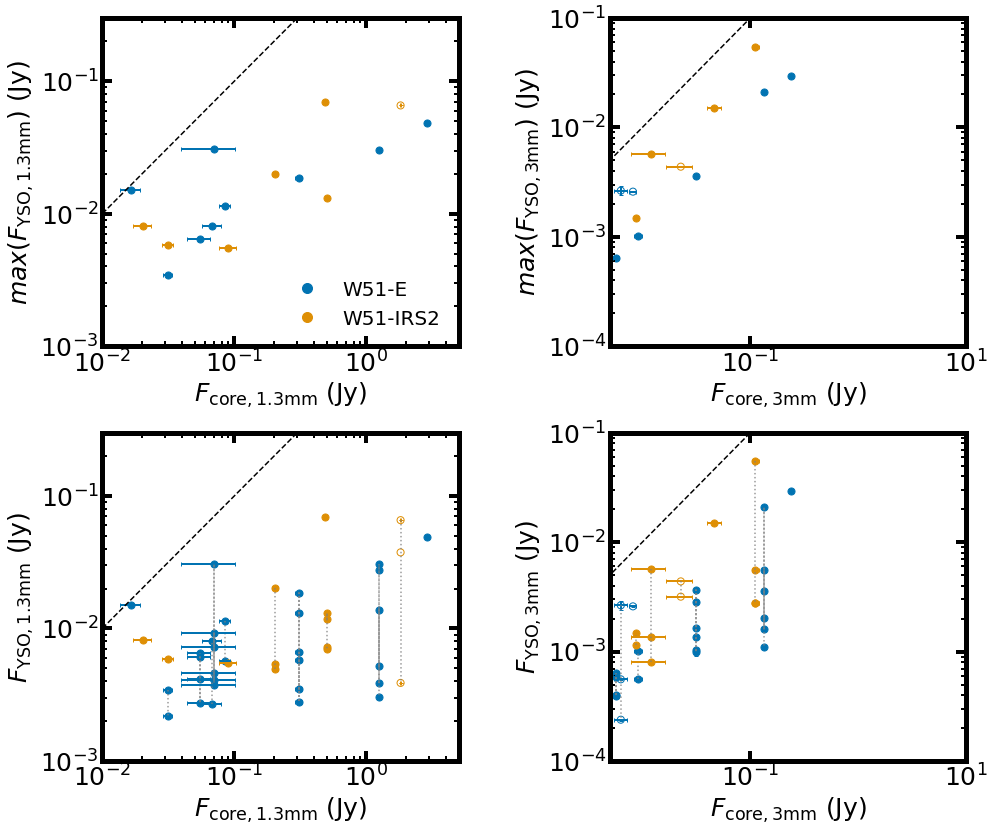

In [6]:
from matplotlib.lines import Line2D
from add_asym import add_asym

w51e_b6_flux_file = '/home/t.yoo/w51/catalogue/photometry/flux_new/w51e_b6_test.fits'
w51e_b3_flux_file = '/home/t.yoo/w51/catalogue/photometry/flux_new/w51e_b3_test.fits'
w51n_b6_flux_file= '/home/t.yoo/w51/catalogue/photometry/flux_new/w51n_b6_test.fits'
w51n_b3_flux_file = '/home/t.yoo/w51/catalogue/photometry/flux_new/w51n_b3_test.fits'
w51e_b6_conv_flux_file = '/home/t.yoo/w51/catalogue/photometry/flux_new/w51e_b6_conv_test.fits'
w51n_b6_conv_flux_file = '/home/t.yoo/w51/catalogue/photometry/flux_new/w51n_b6_conv_test.fits'

w51e_b6_flux_fits = Table.read(w51e_b6_flux_file)
w51e_b3_flux_fits = Table.read(w51e_b3_flux_file)
w51n_b6_flux_fits = Table.read(w51n_b6_flux_file)
w51n_b3_flux_fits = Table.read(w51n_b3_flux_file)
w51e_b6_conv_flux_fits = Table.read(w51e_b6_conv_flux_file)
w51n_b6_conv_flux_fits = Table.read(w51n_b6_conv_flux_file)



ysoflux_err_b6_w51e = w51e_b6_flux_fits['flux_err'] 
ysoflux_err_b3_w51e = w51e_b3_flux_fits['flux_err'] 


ysoflux_err_b6_w51n =  w51n_b6_flux_fits['flux_err'] 
ysoflux_err_b3_w51n =  w51n_b3_flux_fits['flux_err']  

ysoflux_b6_w51e = w51e_b6_flux_fits['flux']
ysoflux_b3_w51e = w51e_b3_flux_fits['flux']
ysoflux_b6_w51n = w51n_b6_flux_fits['flux']
ysoflux_b3_w51n = w51n_b3_flux_fits['flux']




ysoflux_b6_w51e = np.array([np.nan if flux<0 else flux for flux in ysoflux_b6_w51e])
ysoflux_b3_w51e = np.array([np.nan if flux<0 else flux for flux in ysoflux_b3_w51e])
ysoflux_b6_w51n = np.array([np.nan if flux<0 else flux for flux in ysoflux_b6_w51n])
ysoflux_b3_w51n = np.array([np.nan if flux<0 else flux for flux in ysoflux_b3_w51n])
"""
coreindarr_w51e_b3fov = multiplicity_w51e_b3fov[1]
coreindarr_w51n_b3fov = multiplicity_w51n_b3fov[1]

coreindarr_w51e_b3fov_woff = multiplicity_w51e_b3fov_woff[1]
coreindarr_w51n_b3fov_woff = multiplicity_w51n_b3fov_woff[1]

coreindarr_w51e_b3fov_wff = multiplicity_w51e_b3fov_wff[1]
coreindarr_w51n_b3fov_wff = multiplicity_w51n_b3fov_wff[1]

coreindarr_w51e_b6fov = multiplicity_w51e_b6fov[1]
coreindarr_w51n_b6fov = multiplicity_w51n_b6fov[1]

coreindarr_w51e_b6fov_woff = multiplicity_w51e_b6fov_woff[1]
coreindarr_w51n_b6fov_woff = multiplicity_w51n_b6fov_woff[1]

coreindarr_w51e_b6fov_wff = multiplicity_w51e_b6fov_wff[1]
coreindarr_w51n_b6fov_wff = multiplicity_w51n_b6fov_wff[1]

ysoindarr_w51e_b3fov = multiplicity_w51e_b3fov[2]
ysoindarr_w51n_b3fov = multiplicity_w51n_b3fov[2]

ysoindarr_w51e_b3fov_woff = multiplicity_w51e_b3fov_woff[2]
ysoindarr_w51n_b3fov_woff = multiplicity_w51n_b3fov_woff[2]

ysoindarr_w51e_b3fov_wff = multiplicity_w51e_b3fov_wff[2]
ysoindarr_w51n_b3fov_wff = multiplicity_w51n_b3fov_wff[2]

ysoindarr_w51e_b6fov = multiplicity_w51e_b6fov[2]
ysoindarr_w51n_b6fov = multiplicity_w51n_b6fov[2]

ysoindarr_w51e_b6fov_woff = multiplicity_w51e_b6fov_woff[2]
ysoindarr_w51n_b6fov_woff = multiplicity_w51n_b6fov_woff[2]

ysoindarr_w51e_b6fov_wff = multiplicity_w51e_b6fov_wff[2]
ysoindarr_w51n_b6fov_wff = multiplicity_w51n_b6fov_wff[2]



def flatten(xss):
    return [x for xs in xss for x in xs]

### save the data

isinsidecore_w51e_b3fov_woff = np.zeros(len(catalog_w51e_yso['b3_xsky']),dtype=bool)
isinsidecore_w51e_b3fov_woff[flatten(ysoindarr_w51e_b3fov_woff)] = True
catalog_w51e_yso['isinsidecore_woff_b3fov'] = isinsidecore_w51e_b3fov_woff

isinsidecore_w51e_b3fov = np.zeros(len(catalog_w51e_yso['b3_xsky']),dtype=bool)
isinsidecore_w51e_b3fov[flatten(ysoindarr_w51e_b3fov)] = True
catalog_w51e_yso['isinsidecore_b3fov'] = isinsidecore_w51e_b3fov

isinsidecore_w51e_b6fov_woff = np.zeros(len(catalog_w51e_yso['b6_xsky']),dtype=bool)
isinsidecore_w51e_b6fov_woff[flatten(ysoindarr_w51e_b6fov_woff) ] = True
catalog_w51e_yso['isinsidecore_woff_b6fov'] = isinsidecore_w51e_b6fov_woff

isinsidecore_w51e_b6fov = np.zeros(len(catalog_w51e_yso['b6_xsky']),dtype=bool)
isinsidecore_w51e_b6fov[flatten(ysoindarr_w51e_b6fov)] = True
catalog_w51e_yso['isinsidecore_b6fov'] = isinsidecore_w51e_b6fov

isinsidecore_w51n_b3fov_woff = np.zeros(len(catalog_w51n_yso['b3_xsky']),dtype=bool)
isinsidecore_w51n_b3fov_woff[flatten(ysoindarr_w51n_b3fov_woff) ] = True
catalog_w51n_yso['isinsidecore_woff_b3fov'] = isinsidecore_w51n_b3fov_woff

isinsidecore_w51n_b3fov = np.zeros(len(catalog_w51n_yso['b3_xsky']),dtype=bool)
isinsidecore_w51n_b3fov[flatten(ysoindarr_w51n_b3fov)] = True
catalog_w51n_yso['isinsidecore_b3fov'] = isinsidecore_w51n_b3fov

isinsidecore_w51n_b6fov_woff = np.zeros(len(catalog_w51n_yso['b6_xsky']),dtype=bool)
isinsidecore_w51n_b6fov_woff[flatten(ysoindarr_w51n_b6fov_woff) ] = True
catalog_w51n_yso['isinsidecore_woff_b6fov'] = isinsidecore_w51n_b6fov_woff

isinsidecore_w51n_b6fov = np.zeros(len(catalog_w51n_yso['b6_xsky']),dtype=bool)
isinsidecore_w51n_b6fov[flatten(ysoindarr_w51n_b6fov)] = True
catalog_w51n_yso['isinsidecore_b6fov'] = isinsidecore_w51n_b6fov

catalog_w51e_yso.write(Path.w51e_dendro_matched_catalog, overwrite=True)
catalog_w51n_yso.write(Path.w51n_dendro_matched_catalog, overwrite=True)

###

coreflux_w51e_b6_b6fov_woff = core_flux_w51e_b6[coreindarr_w51e_b6fov_woff]


coreflux_w51e_b3_b3fov_woff = core_flux_w51e_b3[coreindarr_w51e_b3fov_woff]
coreflux_w51n_b6_b6fov_woff = core_flux_w51n_b6[coreindarr_w51n_b6fov_woff]
coreflux_w51n_b3_b3fov_woff = core_flux_w51n_b3[coreindarr_w51n_b3fov_woff]

coreflux_w51e_b6_b6fov_wff = core_flux_w51e_b6[coreindarr_w51e_b6fov_wff]
coreflux_w51e_b3_b3fov_wff = core_flux_w51e_b3[coreindarr_w51e_b3fov_wff]
coreflux_w51n_b6_b6fov_wff = core_flux_w51n_b6[coreindarr_w51n_b6fov_wff]
coreflux_w51n_b3_b3fov_wff = core_flux_w51n_b3[coreindarr_w51n_b3fov_wff]
print('hoho')
print(len(coreflux_w51e_b6_b6fov_woff))
print(len(coreflux_w51e_b3_b3fov_woff))
print('hoho')
print(len(coreflux_w51n_b6_b6fov_woff))
print(len(coreflux_w51n_b3_b3fov_woff))
corefluxerr_w51e_b6_b6fov_woff = core_fluxerr_w51e_b6[coreindarr_w51e_b6fov_woff]
corefluxerr_w51e_b3_b3fov_woff = core_fluxerr_w51e_b3[coreindarr_w51e_b3fov_woff]

corefluxerr_w51n_b6_b6fov_woff = core_fluxerr_w51n_b6[coreindarr_w51n_b6fov_woff]
corefluxerr_w51n_b3_b3fov_woff = core_fluxerr_w51n_b3[coreindarr_w51n_b3fov_woff]

corefluxerr_w51e_b6_b6fov_wff = core_fluxerr_w51e_b6[coreindarr_w51e_b6fov_woff]
corefluxerr_w51e_b3_b3fov_wff = core_fluxerr_w51e_b3[coreindarr_w51e_b3fov_woff]

corefluxerr_w51n_b6_b6fov_wff = core_fluxerr_w51n_b6[coreindarr_w51n_b6fov_wff]
corefluxerr_w51n_b3_b3fov_wff = core_fluxerr_w51n_b3[coreindarr_w51n_b3fov_wff]

coremass_w51e_b6fov_woff = coremass_w51e[coreindarr_w51e_b6fov_woff]
coremass_w51e_b3fov_woff = coremass_w51e[coreindarr_w51e_b3fov_woff]

coremass_w51n_b6fov_woff = coremass_w51n[coreindarr_w51n_b6fov_woff]
coremass_w51n_b3fov_woff = coremass_w51n[coreindarr_w51n_b3fov_woff]

coremass_w51e_b6fov_wff = coremass_w51e[coreindarr_w51e_b6fov_wff]
coremass_w51e_b3fov_wff = coremass_w51e[coreindarr_w51e_b3fov_wff]

coremass_w51n_b6fov_wff = coremass_w51n[coreindarr_w51n_b6fov_wff]
coremass_w51n_b3fov_wff = coremass_w51n[coreindarr_w51n_b3fov_wff]

coremasserr_w51e_b6fov_woff = coremasserr_w51e[coreindarr_w51e_b6fov_woff]
coremasserr_w51e_b3fov_woff = coremasserr_w51e[coreindarr_w51e_b3fov_woff]

coremasserr_w51n_b6fov_woff = coremasserr_w51n[coreindarr_w51n_b6fov_woff]
coremasserr_w51n_b3fov_woff = coremasserr_w51n[coreindarr_w51n_b3fov_woff]

coremasserr_w51e_b6fov_wff = coremasserr_w51e[coreindarr_w51e_b6fov_wff]
coremasserr_w51e_b3fov_wff = coremasserr_w51e[coreindarr_w51e_b3fov_wff]

coremasserr_w51n_b6fov_wff = coremasserr_w51n[coreindarr_w51n_b6fov_wff]
coremasserr_w51n_b3fov_wff = coremasserr_w51n[coreindarr_w51n_b3fov_wff]

coretemp_w51e_b6fov_woff = coretemp_w51e[coreindarr_w51e_b6fov_woff]
coretemp_w51e_b3fov_woff = coretemp_w51e[coreindarr_w51e_b3fov_woff]
coretemp_w51n_b6fov_woff = coretemp_w51n[coreindarr_w51n_b6fov_woff]
coretemp_w51n_b3fov_woff = coretemp_w51n[coreindarr_w51n_b3fov_woff]

coretemp_w51e_b6fov_wff = coretemp_w51e[coreindarr_w51e_b6fov_wff]
coretemp_w51e_b3fov_wff = coretemp_w51e[coreindarr_w51e_b3fov_wff]
coretemp_w51n_b6fov_wff = coretemp_w51n[coreindarr_w51n_b6fov_wff]
coretemp_w51n_b3fov_wff = coretemp_w51n[coreindarr_w51n_b3fov_wff]


ysomass_constT_w51e = catalog_w51e_yso['constT_mass']
ysomass_constT_w51n = catalog_w51n_yso['constT_mass']
ysomass_MBBT_w51e = catalog_w51e_yso['MBBT_mass']
ysomass_MBBT_w51n = catalog_w51n_yso['MBBT_mass']

ysomass_err_constT_w51e = catalog_w51e_yso['constT_mass_err']
ysomass_err_constT_w51n = catalog_w51n_yso['constT_mass_err']
ysomass_err_MBBT_w51e = catalog_w51e_yso['MBBT_mass_err']
ysomass_err_MBBT_w51n = catalog_w51n_yso['MBBT_mass_err']

ysoflux_w51e_b6_b6fov_woff = [ysoflux_b6_w51e[ind] for ind in ysoindarr_w51e_b6fov_woff]
ysoflux_w51e_b3_b3fov_woff = [ysoflux_b3_w51e[ind] for ind in ysoindarr_w51e_b3fov_woff] 
ysoflux_w51e_b6_b6fov_woff = [ysoflux_b6_w51e[ind] for ind in ysoindarr_w51e_b6fov_woff]
ysoflux_w51e_b3_b3fov_woff = [ysoflux_b3_w51e[ind] for ind in ysoindarr_w51e_b3fov_woff] 




ysoflux_w51n_b6_b6fov_woff = [ysoflux_b6_w51n[ind] for ind in ysoindarr_w51n_b6fov_woff]
ysoflux_w51n_b3_b3fov_woff = [ysoflux_b3_w51n[ind] for ind in ysoindarr_w51n_b3fov_woff] 
ysoflux_w51n_b6_b6fov_woff = [ysoflux_b6_w51n[ind] for ind in ysoindarr_w51n_b6fov_woff]
ysoflux_w51n_b3_b3fov_woff = [ysoflux_b3_w51n[ind] for ind in ysoindarr_w51n_b3fov_woff] 

ysoflux_err_w51e_b6_b6fov_woff = [ysoflux_err_b6_w51e[ind].value for ind in ysoindarr_w51e_b6fov_woff]
ysoflux_err_w51e_b3_b3fov_woff = [ysoflux_err_b3_w51e[ind].value for ind in ysoindarr_w51e_b3fov_woff] 

ysoflux_err_w51n_b6_b6fov_woff = [ysoflux_err_b6_w51n[ind].value for ind in ysoindarr_w51n_b6fov_woff]
ysoflux_err_w51n_b3_b3fov_woff = [ysoflux_err_b3_w51n[ind].value for ind in ysoindarr_w51n_b3fov_woff] 

ysoflux_w51e_b6_b6fov_wff = [ysoflux_b6_w51e[ind] for ind in ysoindarr_w51e_b6fov_wff]
ysoflux_w51e_b3_b3fov_wff = [ysoflux_b3_w51e[ind] for ind in ysoindarr_w51e_b3fov_wff] 
ysoflux_w51e_b6_b6fov_wff = [ysoflux_b6_w51e[ind] for ind in ysoindarr_w51e_b6fov_wff]
ysoflux_w51e_b3_b3fov_wff = [ysoflux_b3_w51e[ind] for ind in ysoindarr_w51e_b3fov_wff] 

ysoflux_w51n_b6_b6fov_wff = [ysoflux_b6_w51n[ind] for ind in ysoindarr_w51n_b6fov_wff]
ysoflux_w51n_b3_b3fov_wff = [ysoflux_b3_w51n[ind] for ind in ysoindarr_w51n_b3fov_wff] 
ysoflux_w51n_b6_b6fov_wff = [ysoflux_b6_w51n[ind] for ind in ysoindarr_w51n_b6fov_wff]
ysoflux_w51n_b3_b3fov_wff = [ysoflux_b3_w51n[ind] for ind in ysoindarr_w51n_b3fov_wff] 

ysoflux_err_w51e_b6_b6fov_wff = [ysoflux_err_b6_w51e[ind].value for ind in ysoindarr_w51e_b6fov_wff]
ysoflux_err_w51e_b3_b3fov_wff = [ysoflux_err_b3_w51e[ind].value for ind in ysoindarr_w51e_b3fov_wff] 

ysoflux_err_w51n_b6_b6fov_wff = [ysoflux_err_b6_w51n[ind].value for ind in ysoindarr_w51n_b6fov_wff]
ysoflux_err_w51n_b3_b3fov_wff = [ysoflux_err_b3_w51n[ind].value for ind in ysoindarr_w51n_b3fov_wff] 
print('ysoindarr_w51e_b3fov_woff ', ysoindarr_w51e_b3fov_woff, )
for ind in ysoindarr_w51e_b3fov_woff:
    print('id, mass',ind, ysomass_MBBT_w51e[ind])
for ind in ysoindarr_w51e_b3fov:
    print('id2, mas2s',ind, ysomass_MBBT_w51e[ind])
ysomass_constT_w51e_b6fov_woff = [ysomass_constT_w51e[ind].value for ind in ysoindarr_w51e_b6fov_woff]
ysomass_constT_w51e_b3fov_woff = [ysomass_constT_w51e[ind].value for ind in ysoindarr_w51e_b3fov_woff] 
ysomass_MBBT_w51e_b6fov_woff = [ysomass_MBBT_w51e[ind].value for ind in ysoindarr_w51e_b6fov_woff]
ysomass_MBBT_w51e_b3fov_woff = [ysomass_MBBT_w51e[ind].value for ind in ysoindarr_w51e_b3fov_woff] 

ysomass_constT_w51n_b6fov_woff = [ysomass_constT_w51n[ind].value for ind in ysoindarr_w51n_b6fov_woff]
ysomass_constT_w51n_b3fov_woff = [ysomass_constT_w51n[ind].value for ind in ysoindarr_w51n_b3fov_woff] 
ysomass_MBBT_w51n_b6fov_woff = [ysomass_MBBT_w51n[ind].value for ind in ysoindarr_w51n_b6fov_woff]
ysomass_MBBT_w51n_b3fov_woff = [ysomass_MBBT_w51n[ind].value for ind in ysoindarr_w51n_b3fov_woff] 


ysomass_err_constT_w51e_b6fov_woff = [ysomass_err_constT_w51e[ind].value for ind in ysoindarr_w51e_b6fov_woff]
ysomass_err_constT_w51e_b3fov_woff = [ysomass_err_constT_w51e[ind].value for ind in ysoindarr_w51e_b3fov_woff] 
ysomass_err_constT_w51n_b6fov_woff = [ysomass_err_constT_w51n[ind].value for ind in ysoindarr_w51n_b6fov_woff]
ysomass_err_constT_w51n_b3fov_woff = [ysomass_err_constT_w51n[ind].value for ind in ysoindarr_w51n_b3fov_woff] 

ysomass_err_MBBT_w51e_b6fov_woff = [ysomass_err_MBBT_w51e[ind].value for ind in ysoindarr_w51e_b6fov_woff]
ysomass_err_MBBT_w51e_b3fov_woff = [ysomass_err_MBBT_w51e[ind].value for ind in ysoindarr_w51e_b3fov_woff] 
ysomass_err_MBBT_w51n_b6fov_woff = [ysomass_err_MBBT_w51n[ind].value for ind in ysoindarr_w51n_b6fov_woff]
ysomass_err_MBBT_w51n_b3fov_woff = [ysomass_err_MBBT_w51n[ind].value for ind in ysoindarr_w51n_b3fov_woff] 
    
"""
def plot_core_yso_all_frags(ax, coredats, ysodats, coredats_err, ysodats_err, grouparr=None, color='c'):
    count=0
    print('plot_core_yso_all_frags')
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            count =count+1
            lenx = len(ysodats[i])
            #if not any(~np.isfinite(ysodats[i])):
            #    print(np.max(ysodats[i])/np.sort(ysodats[i]))

         
            for j in range(lenx):
                if np.isfinite(ysodats[i][j]) and np.isfinite(ysodats_err[i][j]):
                    ax.errorbar(coredat, ysodats[i][j], xerr = coredats_err[i], 
                                yerr=ysodats_err[i][j],
                                capsize=2.0, elinewidth=2, ecolor=color)
                    print(ysodats[i][j],ysodats_err[i][j])
                if grouparr is not None:
                    if grouparr[i][j]==0:
                        marker = 'o'
                    elif grouparr[i][j]==1:
                        marker = '^'
                    elif grouparr[i][j]==2:
                        marker = 'x'
                else:
                    marker = 'o'
                if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                    ax.scatter(coredat, ysodats[i][j], marker=marker, facecolor='none', color=color, s=50)

                else:
                    ax.scatter(coredat, ysodats[i][j],marker=marker, color=color, s=50)


          
            if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                ax.plot(np.ones(lenx)*coredat, ysodats[i], ls='dotted', color='gray',alpha=0.8)
                
            else:
                ax.plot(np.ones(lenx)*coredat, ysodats[i], ls='dotted', color='gray',alpha=0.8)
def plot_core_yso_sum_frags(ax, coredats, ysodats, coredats_err,ysodats_err, color='c'):
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            finiteind = np.isfinite(ysodats[i])
            #yerrset = add_asym.add_asym(ysodats[i][finiteind], ysodats[i][finiteind]-ysodats_err_low[i][finiteind], ysodats_err_high[i][finiteind]-ysodats[i][finiteind], order=1)

            if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                ax.scatter(coredat, np.nansum(ysodats[i]),color=color, marker='o', facecolor='none',s=50)
                ax.errorbar(coredat, np.nansum(ysodats[i]), xerr=coredats_err[i], 
                            yerr=np.linalg.norm(ysodats_err[i]),
                           capsize=2.0, elinewidth=2, ecolor=color)
            else:
                ax.scatter(coredat, np.nansum(ysodats[i]),color=color, marker='o',s=50)
                ax.errorbar(coredat, np.nansum(ysodats[i]), xerr=coredats_err[i], 
                           yerr=np.linalg.norm(ysodats_err[i]),
                           capsize=2.0, elinewidth=2, ecolor=color)
            """
            else:
                ax.scatter(coredat, np.nansum(ysodats[i]),color=color, marker='o',s=50)
                ax.errorbar(coredat, yerrset[0], xerr=coredats_err[i], 
                            yerr=np.array([[np.abs(yerrset[1]),yerrset[2]]]).T,
                           capsize=2.0, elinewidth=2, ecolor=color)
            """
                
            
def plot_core_yso_max_frags(ax, coredats, ysodats, coredats_err, ysodats_err, color='c'):
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            if any(np.isfinite(ysodats[i])):
                maxidx = np.nanargmax(ysodats[i])
                if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                    ax.errorbar(coredat, np.nanmax(ysodats[i]), xerr = coredats_err[i], 
                                    yerr=ysodats_err[i][np.nanargmax(ysodats[i])],
                                capsize=2.0, elinewidth=2, ecolor=color)
                    ax.scatter(coredat, np.nanmax(ysodats[i]),color=color,s=50, marker='o', facecolor='none')

                else:
                    ax.errorbar(coredat, np.nanmax(ysodats[i]), xerr = coredats_err[i], 
                                    yerr=ysodats_err[i][np.nanargmax(ysodats[i])],
                                capsize=2.0, elinewidth=2, ecolor=color)
                    ax.scatter(coredat, np.nanmax(ysodats[i]),color=color,s=50, marker='o')
                """
                if any(~np.isfinite(ysodats[i])):
                    ax.errorbar(coredat, np.nanmax(ysodats[i]), xerr = coredats_err[i], 
                                    yerr=np.array([[ysodats[i][maxidx] - ysodats_err_low[i][maxidx], 
                                                    ysodats_err_high[i][maxidx] - ysodats[i][maxidx]]]).T,
                                capsize=2.0, elinewidth=2, ecolor=color)
                    ax.scatter(coredat, np.nanmax(ysodats[i]),color=color,s=50, marker='o', facecolor='none')

                else:
                    ax.errorbar(coredat, np.nanmax(ysodats[i]), xerr = coredats_err[i], 
                                    yerr=np.array([[ysodats[i][maxidx] - ysodats_err_low[i][maxidx], 
                                                    ysodats_err_high[i][maxidx] - ysodats[i][maxidx]]]).T,
                                capsize=2.0, elinewidth=2, ecolor=color)
                    ax.scatter(coredat, np.nanmax(ysodats[i]),color=color,s=50, marker='o')
                """

            

fig = plt.figure(figsize=(15,12))
ax1 = fig.add_axes([0.15,0.1,0.33,0.38])
ax2 = fig.add_axes([0.62,0.1,0.33,0.38])

#ax3 = fig.add_axes([0.1,0.41,0.38,0.25])
#ax4 = fig.add_axes([0.58,0.41,0.38,0.25])

ax5 = fig.add_axes([0.15,0.58,0.33,0.38])
ax6 = fig.add_axes([0.62,0.58,0.33,0.38])
multiplicity_w51e_b6crit_b6fov = core_catdata_w51e_b6_b6crit_b6fov.multiplicity(hdrhr_w51e_b6,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf,)
multiplicity_w51n_b6crit_b6fov = core_catdata_w51n_b6_b6crit_b6fov.multiplicity(hdrhr_w51n_b6,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,)

coreflux_w51e_b6_b6crit_b6fov = core_catdata_w51e_b6_b6crit_b6fov.flux[multiplicity_w51e_b6crit_b6fov[1]]
corefluxerr_w51e_b6_b6crit_b6fov = core_catdata_w51e_b6_b6crit_b6fov.fluxerr[multiplicity_w51e_b6crit_b6fov[1]]

ysoflux_w51e_b6_b6crit_b6fov = [ysoflux_b6_w51e[ind] for ind in multiplicity_w51e_b6crit_b6fov[2]]
ysoflux_err_w51e_b6_b6crit_b6fov = [ysoflux_err_b6_w51e[ind] for ind in multiplicity_w51e_b6crit_b6fov[2]]
ysogroup_w51e_b6crit_b6fov = [ysogroup_w51e[ind] for ind in multiplicity_w51e_b6crit_b6fov[2]]

coreflux_w51e_b3_b6b3crit_b3fov = core_catdata_w51e_b3_b6b3crit_b3fov.flux[multiplicity_w51e_b6b3crit_b3fov[1]]
corefluxerr_w51e_b3_b6b3crit_b3fov = core_catdata_w51e_b3_b6b3crit_b3fov.fluxerr[multiplicity_w51e_b6b3crit_b3fov[1]]

ysoflux_w51e_b3_b6b3crit_b3fov = [ysoflux_b3_w51e[ind] for ind in multiplicity_w51e_b6b3crit_b3fov[2]]
ysoflux_err_w51e_b3_b6b3crit_b3fov = [ysoflux_err_b3_w51e[ind] for ind in multiplicity_w51e_b6b3crit_b3fov[2]]
ysogroup_w51e_b6b3crit_b3fov = [ysogroup_w51e[ind] for ind in multiplicity_w51e_b6b3crit_b3fov[2]]


coreflux_w51n_b6_b6crit_b6fov = core_catdata_w51n_b6_b6crit_b6fov.flux[multiplicity_w51n_b6crit_b6fov[1]]
corefluxerr_w51n_b6_b6crit_b6fov = core_catdata_w51n_b6_b6crit_b6fov.fluxerr[multiplicity_w51n_b6crit_b6fov[1]]

ysoflux_w51n_b6_b6crit_b6fov = [ysoflux_b6_w51n[ind] for ind in multiplicity_w51n_b6crit_b6fov[2]]
ysoflux_err_w51n_b6_b6crit_b6fov = [ysoflux_err_b6_w51n[ind] for ind in multiplicity_w51n_b6crit_b6fov[2]]
ysogroup_w51n_b6crit_b6fov = [ysogroup_w51n[ind] for ind in multiplicity_w51n_b6crit_b6fov[2]]


coreflux_w51n_b3_b6b3crit_b3fov = core_catdata_w51n_b3_b6b3crit_b3fov.flux[multiplicity_w51n_b6b3crit_b3fov[1]]
corefluxerr_w51n_b3_b6b3crit_b3fov = core_catdata_w51n_b3_b6b3crit_b3fov.fluxerr[multiplicity_w51n_b6b3crit_b3fov[1]]

ysoflux_w51n_b3_b6b3crit_b3fov = [ysoflux_b3_w51n[ind] for ind in multiplicity_w51n_b6b3crit_b3fov[2]]
ysoflux_err_w51n_b3_b6b3crit_b3fov = [ysoflux_err_b3_w51n[ind] for ind in multiplicity_w51n_b6b3crit_b3fov[2]]
ysogroup_w51n_b6b3crit_b3fov = [ysogroup_w51n[ind] for ind in multiplicity_w51n_b6b3crit_b3fov[2]]


plot_core_yso_all_frags(ax1, coreflux_w51e_b6_b6crit_b6fov, ysoflux_w51e_b6_b6crit_b6fov, corefluxerr_w51e_b6_b6crit_b6fov,  ysoflux_err_w51e_b6_b6crit_b6fov  ,color=cmap[0])
plot_core_yso_all_frags(ax2, coreflux_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov, corefluxerr_w51e_b3_b6b3crit_b3fov,  ysoflux_err_w51e_b3_b6b3crit_b3fov ,color=cmap[0])
plot_core_yso_all_frags(ax1, coreflux_w51n_b6_b6crit_b6fov, ysoflux_w51n_b6_b6crit_b6fov, corefluxerr_w51n_b6_b6crit_b6fov,  ysoflux_err_w51n_b6_b6crit_b6fov  ,color=cmap[1])
plot_core_yso_all_frags(ax2, coreflux_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov, corefluxerr_w51n_b3_b6b3crit_b3fov,  ysoflux_err_w51n_b3_b6b3crit_b3fov ,color=cmap[1])


#plot_core_yso_sum_frags(ax3, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff, color=cmap[0])
#plot_core_yso_sum_frags(ax4, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff, color=cmap[0])
#plot_core_yso_sum_frags(ax3, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff, color=cmap[1])
#plot_core_yso_sum_frags(ax4, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff, color=cmap[1])

plot_core_yso_max_frags(ax5, coreflux_w51e_b6_b6crit_b6fov, ysoflux_w51e_b6_b6crit_b6fov, corefluxerr_w51e_b6_b6crit_b6fov,  ysoflux_err_w51e_b6_b6crit_b6fov  ,color=cmap[0])
plot_core_yso_max_frags(ax6, coreflux_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov, corefluxerr_w51e_b3_b6b3crit_b3fov,  ysoflux_err_w51e_b3_b6b3crit_b3fov ,color=cmap[0])
plot_core_yso_max_frags(ax5, coreflux_w51n_b6_b6crit_b6fov, ysoflux_w51n_b6_b6crit_b6fov, corefluxerr_w51n_b6_b6crit_b6fov,  ysoflux_err_w51n_b6_b6crit_b6fov  ,color=cmap[1])
plot_core_yso_max_frags(ax6, coreflux_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov, corefluxerr_w51n_b3_b6b3crit_b3fov,  ysoflux_err_w51n_b3_b6b3crit_b3fov ,color=cmap[1])

#plot_core_yso_max_frags(ax5, coreflux_w51e_b6_b6fov_woff, ysoflux_w51e_b6_b6fov_woff, corefluxerr_w51e_b6_b6fov_woff,  ysoflux_err_w51e_b6_b6fov_woff, color=cmap[0])
#plot_core_yso_max_frags(ax6, coreflux_w51e_b3_b3fov_woff, ysoflux_w51e_b3_b3fov_woff, corefluxerr_w51e_b3_b3fov_woff,  ysoflux_err_w51e_b3_b3fov_woff, color=cmap[0])
#plot_core_yso_max_frags(ax5, coreflux_w51n_b6_b6fov_woff, ysoflux_w51n_b6_b6fov_woff, corefluxerr_w51n_b6_b6fov_woff,  ysoflux_err_w51n_b6_b6fov_woff, color=cmap[1])
#plot_core_yso_max_frags(ax6, coreflux_w51n_b3_b3fov_woff, ysoflux_w51n_b3_b3fov_woff, corefluxerr_w51n_b3_b3fov_woff,  ysoflux_err_w51n_b3_b3fov_woff, color=cmap[1])


ax1.set_xscale('log')
ax1.set_yscale('log')
ax2.set_xscale('log')
ax2.set_yscale('log')
ax1.set_ylim(1e-3,3e-1)
ax1.set_xlim(1e-2,5)
ax2.set_ylim(1e-4,1e-1)
ax2.set_xlim(5e-3,1e1)
ax1.set_xlabel(r'$F_{\rm core, 1.3mm}$ (Jy)')
ax2.set_xlabel(r'$F_{\rm core, 3mm}$ (Jy)')
ax1.set_ylabel(r'$F_{\rm YSO, 1.3mm}$ (Jy)')
ax2.set_ylabel(r'$F_{\rm YSO, 3mm}$ (Jy)')


ax1.plot([1e-2,5],[1e-2,5], ls='dashed', c='k')
ax2.plot([1e-5,5e-1],[1e-5,5e-1], ls='dashed', c='k')
ax5.plot([1e-2,5],[1e-2,5], ls='dashed', c='k')
ax6.plot([1e-5,5e-1],[1e-5,5e-1], ls='dashed', c='k')


"""
ax3.set_xscale('log')
ax3.set_yscale('log')
ax4.set_xscale('log')
ax4.set_yscale('log')
ax3.set_ylim(1e-3,3e-1)
ax3.set_xlim(1e-2,5)
ax4.set_ylim(1e-4,1e-1)
ax4.set_xlim(5e-4,5e-1)
ax3.set_xlabel(r'$F_{\rm core, 1.3mm}$ (Jy)')
ax4.set_xlabel(r'$F_{\rm core, 3mm}$ (Jy)')
ax3.set_ylabel(r'$sum(F_{\rm YSO, 1.3mm})$ (Jy)')
ax4.set_ylabel(r'$sum(F_{\rm YSO, 3mm})$ (Jy)')

"""
ax5.set_xscale('log')
ax5.set_yscale('log')
ax6.set_xscale('log')
ax6.set_yscale('log')
ax5.set_ylim(1e-3,3e-1)
ax5.set_xlim(1e-2,5)
ax6.set_ylim(1e-4,1e-1)
ax6.set_xlim(5e-3,1e1)
ax5.set_xlabel(r'$F_{\rm core, 1.3mm}$ (Jy)')
ax6.set_xlabel(r'$F_{\rm core, 3mm}$ (Jy)')
ax5.set_ylabel(r'$max(F_{\rm YSO, 1.3mm})$ (Jy)')
ax6.set_ylabel(r'$max(F_{\rm YSO, 3mm})$ (Jy)')

handles=[]
dummy_w51e = Line2D([0], [0], label='W51-E', marker='o', markersize=10, 
          markerfacecolor=cmap[0], linestyle='',markeredgecolor=cmap[0])
dummy_w51n = Line2D([0], [0], label='W51-IRS2', marker='o', markersize=10, 
          markerfacecolor=cmap[1], linestyle='',markeredgecolor=cmap[1])
handles.extend([dummy_w51e, dummy_w51n])
ax5.legend(handles=handles,fontsize=20, frameon=False)
plt.savefig('core_ysoflux.png')


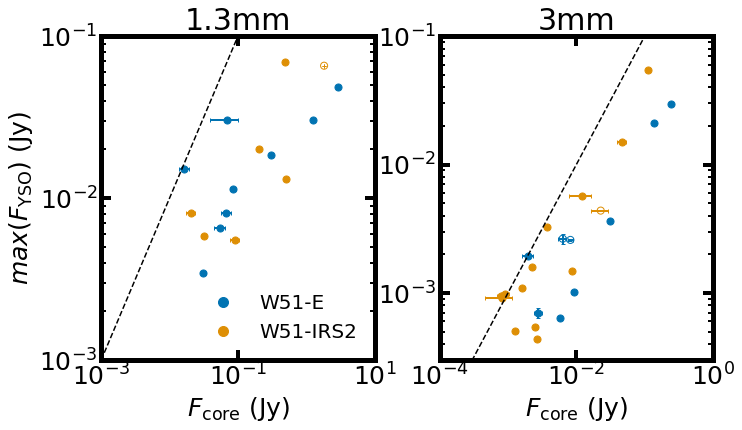

In [7]:
fig = plt.figure(figsize=(10,6))
ax5 = fig.add_axes([0.14,0.17,0.38,0.75])
ax6 = fig.add_axes([0.61,0.17,0.38,0.75])

plot_core_yso_max_frags(ax5, coreflux_w51e_b6_b6crit_b6fov, ysoflux_w51e_b6_b6crit_b6fov, corefluxerr_w51e_b6_b6crit_b6fov,  ysoflux_err_w51e_b6_b6crit_b6fov  ,color=cmap[0])
plot_core_yso_max_frags(ax6, coreflux_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov, corefluxerr_w51e_b3_b6b3crit_b3fov,  ysoflux_err_w51e_b3_b6b3crit_b3fov ,color=cmap[0])
plot_core_yso_max_frags(ax5, coreflux_w51n_b6_b6crit_b6fov, ysoflux_w51n_b6_b6crit_b6fov, corefluxerr_w51n_b6_b6crit_b6fov,  ysoflux_err_w51n_b6_b6crit_b6fov  ,color=cmap[1])
plot_core_yso_max_frags(ax6, coreflux_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov, corefluxerr_w51n_b3_b6b3crit_b3fov,  ysoflux_err_w51n_b3_b6b3crit_b3fov ,color=cmap[1])
ax5.plot([1e-3,1e1],[1e-3,1e1], ls='dashed', c='k')
ax6.plot([1e-5,5e-1],[1e-5,5e-1], ls='dashed', c='k')
                    
ax5.set_xscale('log')
ax5.set_yscale('log')
ax6.set_xscale('log')
ax6.set_yscale('log')
ax5.set_ylim(1e-3,1e-1)
ax5.set_xlim(1e-3,1e1)
ax6.set_ylim(3e-4,1e-1)
ax6.set_xlim(1e-4,1e0)
ax5.set_xlabel(r'$F_{\rm core}$ (Jy)')
ax6.set_xlabel(r'$F_{\rm core}$ (Jy)')
ax5.set_ylabel(r'$max(F_{\rm YSO})$ (Jy)')
#ax6.set_ylabel(r'$max(F_{\rm YSO, 3mm})$ (Jy)')

handles=[]
dummy_w51e = Line2D([0], [0], label='W51-E', marker='o', markersize=10, 
          markerfacecolor=cmap[0], linestyle='',markeredgecolor=cmap[0])
dummy_w51n = Line2D([0], [0], label='W51-IRS2', marker='o', markersize=10, 
          markerfacecolor=cmap[1], linestyle='',markeredgecolor=cmap[1])
handles.extend([dummy_w51e, dummy_w51n])
ax5.legend(handles=handles,fontsize=20, frameon=False)
ax5.set_title('1.3mm',fontsize=30)
ax6.set_title('3mm',fontsize=30)
plt.savefig('core_ysofluxmax.png')

ho
plot_core_yso_all_frags
0.04866729341968129 8.959612116856016e-07
0.00525196964259134 2.464781228649977e-07
0.013735573669970589 7.340319058057402e-05
0.0038943612257362485 2.1058354025756319e-07
0.030484202743520792 4.8195400663484055e-05
0.027670524183772176 4.438385006931635e-06
0.0030438763848371123 5.302869283763465e-09
0.012990891872368265 1.8656222243817732e-05
0.003509429297802894 5.208937555955896e-07
0.005748918988758183 2.2093286999699948e-07
0.018499174536012446 1.6242913644439816e-05
0.0027699303073490224 3.0899062059503815e-07
0.006613796923392954 2.2226029709622266e-06
0.011368408891696572 4.441477505672955e-07
0.005675774224116165 2.275770436493431e-05
0.006047791440506922 2.5920530668482873e-06
0.002726491873868333 8.848051432172161e-08
0.0041301448949383965 5.523143635809032e-07
0.0065009321576564895 6.87292483332548e-06
0.0027030793994496506 2.312537893650704e-07
0.008051749417145312 4.001759602232787e-06
0.0034324122592815343 1.6578535598692016e-07
0.002203870198

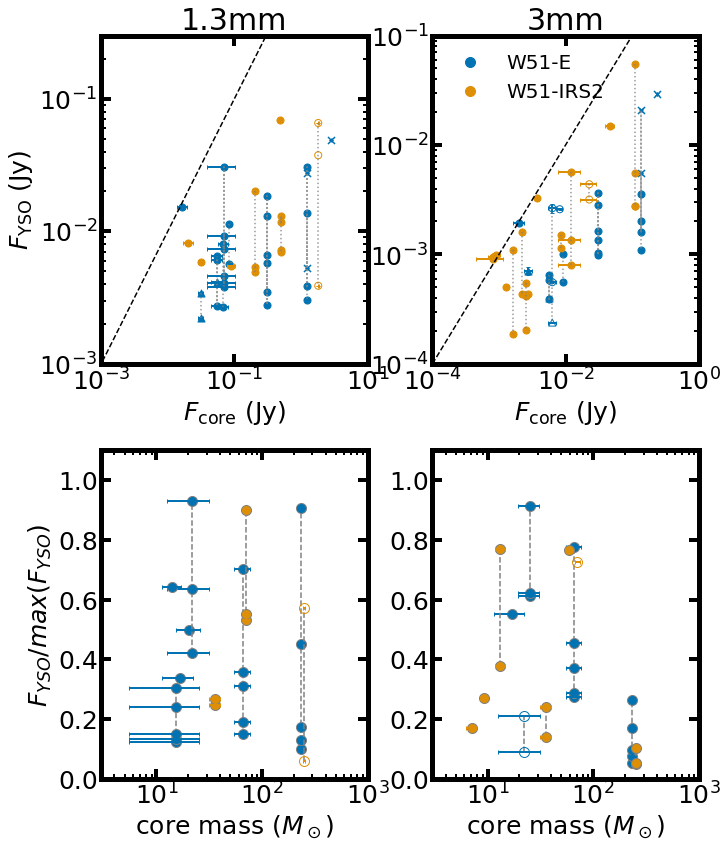

In [8]:
def plot_fluxratio_coremass(ax, coredats, ysodats, ysodats_err, coremass, coremasserr, color='c'):
    count=0
    for i, coredat in enumerate(coredats):
        
        if any(np.isfinite(ysodats[i])):
            lenx = len(ysodats[i])
            ysodat_sort = np.sort(ysodats[i])
            ysodat_sort_finite = ysodat_sort[np.isfinite(ysodat_sort)]

            ysodats_err_sort = ysodats_err[i][np.argsort(ysodats[i])]
            ysodats_err_sort_finite = ysodats_err[i][np.argsort(ysodats[i])]
            
            #ysodats_err_low_sort = ysodats_err_low[i][np.argsort(ysodats[i])]
            #ysodats_err_low_sort_finite = ysodats_err_low[i][np.isfinite(ysodats_err_low[i])]
            
            #ysodats_err_upp_sort = ysodats_err_upp[i][np.argsort(ysodats[i])]
            #ysodats_err_upp_sort_finite = ysodats_err_upp[i][np.isfinite(ysodats_err_upp[i])]

            if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                ax.plot(coremass[i]*np.ones(len(ysodat_sort_finite)-1), ysodat_sort_finite[:-1]/np.nanmax(ysodats[i]), color='gray',markeredgecolor=color, mfc='none',ls='dashed',marker='o', markersize=10)

                ax.errorbar(coremass[i]*np.ones(len(ysodat_sort_finite)-1), ysodat_sort_finite[:-1]/np.nanmax(ysodats[i]), 
                            xerr=coremasserr[i], 
                            #yerr=np.array(list(zip(ysodats_err_low_sort_finite[:-1], ysodats_err_upp_sort_finite[:-1]))).T,
                            capsize=2.0, elinewidth=2, ecolor=color,fmt='none')
                            
            else:
                ax.plot(coremass[i]*np.ones(len(ysodat_sort_finite)-1), ysodat_sort_finite[:-1]/np.nanmax(ysodats[i]), color='gray', mfc=color,ls='dashed',marker='o', markersize=10)
                ax.errorbar(coremass[i]*np.ones(len(ysodat_sort_finite)-1), ysodat_sort_finite[:-1]/np.nanmax(ysodats[i]), 
                            xerr=coremasserr[i], 
                            #yerr=np.array(list(zip(ysodats_err_low_sort_finite[:-1], ysodats_err_upp_sort_finite[:-1]))).T,
                            capsize=2.0, elinewidth=2, ecolor=color,fmt='none')
coretemp_catdata_w51e_b6_b6crit_b6fov = core_catdata_w51e_b6_b6crit_b6fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_catdata_w51n_b6_b6crit_b6fov = core_catdata_w51n_b6_b6crit_b6fov.get_temperature(Path.w51n_almaimf_coretemp)
coretemp_catdata_w51e_b6_b6b3crit_b3fov = core_catdata_w51e_b6_b6b3crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_catdata_w51n_b6_b6b3crit_b3fov = core_catdata_w51n_b6_b6b3crit_b3fov.get_temperature(Path.w51n_almaimf_coretemp)

coremass_w51e_b6crit_b6fov = core_catdata_w51e_b6_b6crit_b6fov.get_coremass(freqb6, kappa_b6, 5.41*u.kpc)
coremasserr_w51e_b6crit_b6fov = core_catdata_w51e_b6_b6crit_b6fov.get_coremasserr()

coremass_w51n_b6crit_b6fov = core_catdata_w51n_b6_b6crit_b6fov.get_coremass(freqb6, kappa_b6, 5.1*u.kpc)
coremasserr_w51n_b6crit_b6fov = core_catdata_w51n_b6_b6crit_b6fov.get_coremasserr()

coremass_w51e_b6b3crit_b3fov = core_catdata_w51e_b6_b6b3crit_b3fov.get_coremass(freqb6, kappa_b6, 5.41*u.kpc)
coremasserr_w51e_b6b3crit_b3fov = core_catdata_w51e_b6_b6b3crit_b3fov.get_coremasserr()

coremass_w51n_b6b3crit_b3fov = core_catdata_w51n_b6_b6b3crit_b3fov.get_coremass(freqb6, kappa_b6, 5.1*u.kpc)
coremasserr_w51n_b6b3crit_b3fov = core_catdata_w51n_b6_b6b3crit_b3fov.get_coremasserr()

fig = plt.figure(figsize=(10,12))
ax1 = fig.add_axes([0.14,0.1,0.37,0.38])
ax2 = fig.add_axes([0.6,0.1,0.37,0.38])

#ax3 = fig.add_axes([0.1,0.41,0.38,0.25])
#ax4 = fig.add_axes([0.58,0.41,0.38,0.25])

ax5 = fig.add_axes([0.14,0.58,0.37,0.38])
ax6 = fig.add_axes([0.6,0.58,0.37,0.38])

plot_fluxratio_coremass(ax1, coreflux_w51e_b6_b6crit_b6fov, ysoflux_w51e_b6_b6crit_b6fov,  ysoflux_err_w51e_b6_b6crit_b6fov,coremass_w51e_b6crit_b6fov,coremasserr_w51e_b6crit_b6fov,color=cmap[0])
plot_fluxratio_coremass(ax1, coreflux_w51n_b6_b6crit_b6fov, ysoflux_w51n_b6_b6crit_b6fov,  ysoflux_err_w51n_b6_b6crit_b6fov,coremass_w51n_b6crit_b6fov,coremasserr_w51n_b6crit_b6fov,color=cmap[1])
print('ho')

plot_fluxratio_coremass(ax2, coreflux_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov, ysoflux_err_w51e_b3_b6b3crit_b3fov, coremass_w51e_b6b3crit_b3fov,coremasserr_w51e_b6b3crit_b3fov,color=cmap[0])
plot_fluxratio_coremass(ax2, coreflux_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov, ysoflux_err_w51n_b3_b6b3crit_b3fov, coremass_w51n_b6b3crit_b3fov,coremasserr_w51n_b6b3crit_b3fov,color=cmap[1])

ax1.set_xscale('log')
ax2.set_xscale('log')
ax1.set_xlim(3,1e3)
ax2.set_xlim(3,1e3)
ax1.set_ylim(0,1.1)
ax2.set_ylim(0,1.1)
ax1.set_xlabel(r'core mass ($M_\odot$)')
ax2.set_xlabel(r'core mass ($M_\odot$)')
ax1.set_ylabel(r'$F_{YSO}/max(F_{YSO})$')
#ax2.set_ylabel(r'$F_{3mm}/max(F_{3mm})$')

plot_core_yso_all_frags(ax5, coreflux_w51e_b6_b6crit_b6fov, ysoflux_w51e_b6_b6crit_b6fov, corefluxerr_w51e_b6_b6crit_b6fov, ysoflux_err_w51e_b6_b6crit_b6fov, grouparr=ysogroup_w51e_b6crit_b6fov, color=cmap[0])
plot_core_yso_all_frags(ax6, coreflux_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov, corefluxerr_w51e_b3_b6b3crit_b3fov, ysoflux_err_w51e_b3_b6b3crit_b3fov, grouparr=ysogroup_w51e_b6b3crit_b3fov, color=cmap[0])
plot_core_yso_all_frags(ax5, coreflux_w51n_b6_b6crit_b6fov, ysoflux_w51n_b6_b6crit_b6fov, corefluxerr_w51n_b6_b6crit_b6fov, ysoflux_err_w51n_b6_b6crit_b6fov, grouparr=ysogroup_w51n_b6crit_b6fov,color=cmap[1])
plot_core_yso_all_frags(ax6, coreflux_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov, corefluxerr_w51n_b3_b6b3crit_b3fov, ysoflux_err_w51n_b3_b6b3crit_b3fov, grouparr=ysogroup_w51n_b6b3crit_b3fov,color=cmap[1])
ax5.set_xscale('log')
ax5.set_yscale('log')
ax6.set_xscale('log')
ax6.set_yscale('log')
ax5.set_ylim(1e-3,3e-1)
ax5.set_xlim(1e-3,10)
ax6.set_ylim(1e-4,1e-1)
ax6.set_xlim(1e-4,1)

ax5.set_xlabel(r'$F_{\rm core}$ (Jy)')
ax6.set_xlabel(r'$F_{\rm core}$ (Jy)')
ax5.set_ylabel(r'$F_{\rm YSO}$ (Jy)')
#ax6.set_ylabel(r'$F_{\rm YSO, 3mm}$ (Jy)')
ax6.legend(handles=handles,fontsize=20, frameon=False)
ax5.plot([1e-4,1],[1e-4,1], ls='dashed', c='k')
ax6.plot([1e-4,1],[1e-4,1], ls='dashed', c='k')
ax5.set_title('1.3mm',fontsize=30)
ax6.set_title('3mm',fontsize=30)
plt.savefig('core_ysofluxall.png')

0.8888194417315589
[0.88031714]
1.0520456263869928
[0.53076203]
1.5140673697032112
[0.50701374 0.4003361  0.39692453 0.48484821]
1.589339485446706
[1.02840887 0.47235117 0.30880987        nan]
1.8086459023258254
[1.01744893        nan]
1.9161419571628822
[0.47324971 0.63693614]
3.5304390661785967
[1.06117028 0.62916815 0.64514006 1.20546346 0.81155072 0.73530394]
7.345747068882783
[1.48874793 0.80045548 0.90182458 1.19034252 2.90110173 0.66450758]
9.757048734120374
[3.42872426]
hoho
0.5666392150213396
[0.61737559]
0.5693856338194704
[0.60472771]
0.6057392178157197
[0.62912118]
0.7174956445860838
[0.44964732]
0.728834686331544
[]
0.8054812226240906
[0.66213338 0.2732914 ]
0.9442457307290302
[0.79961383 0.41634602]
1.0049875621120892
[0.4669841  0.40999762 0.28657368]
1.036339712642529
[0.41782439]
1.2177027551911015
[1.13945324]
1.3925516148423367
[]
1.8608600162290554
[0.67534797 0.77237036]
2.1908902300206643
[1.5096992  0.73945066 0.56534928]
3.012640038238886
[1.3231836  1.12696692 

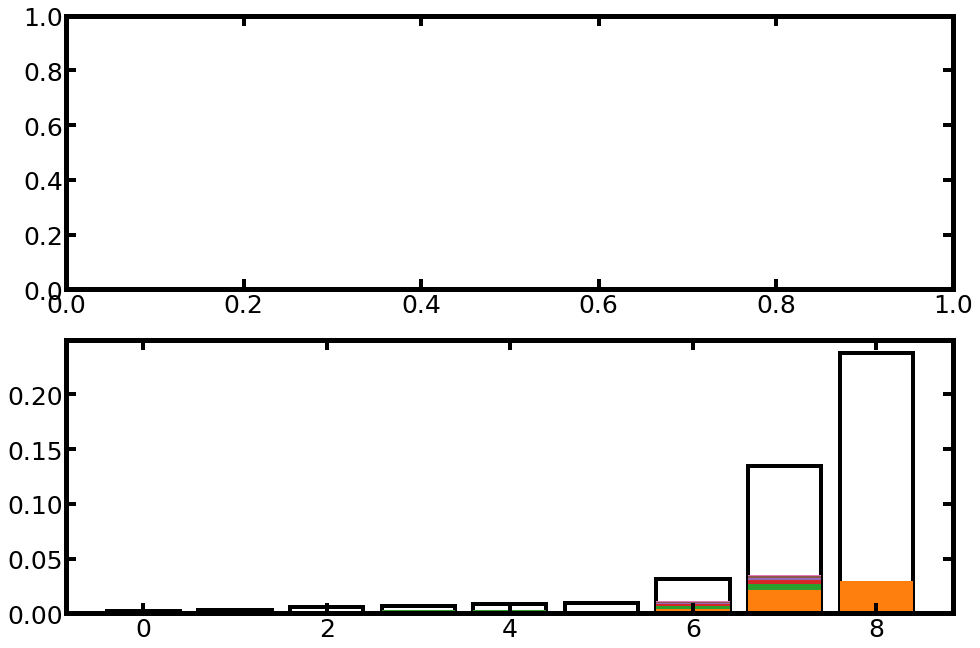

In [9]:
import seaborn as sns

fig = plt.figure(figsize=(14,10))
ax1 = fig.add_axes([0.1,0.1,0.88,0.38])
ax2 = fig.add_axes([0.1,0.55,0.88,0.38])

sort_w51e_b6 = np.argsort(coreflux_w51e_b6_b6crit_b6fov)
sort_w51e_b3 = np.argsort(coreflux_w51e_b3_b6b3crit_b3fov)

sort_w51n_b6 = np.argsort(coreflux_w51n_b6_b6crit_b6fov)
sort_w51n_b3 = np.argsort(coreflux_w51n_b3_b6b3crit_b3fov)

colors=sns.color_palette("tab10")


colorset = ['r','g','b','c','m','y','k']
hatchset = ['//','\\\\','||','--','++','**','..']

coreflux_w51e_sorted = coreflux_w51e_b3_b6b3crit_b3fov[sort_w51e_b3]
ysoflux_w51e_sorted = np.array(ysoflux_w51e_b3_b6b3crit_b3fov)[sort_w51e_b3]

coreflux_w51n_sorted = coreflux_w51n_b3_b6b3crit_b3fov[sort_w51n_b3]
ysoflux_w51n_sorted = np.array(ysoflux_w51n_b3_b6b3crit_b3fov)[sort_w51n_b3]

ax1.bar(np.arange(len(coreflux_w51e_sorted)), coreflux_w51e_sorted, facecolor='none', lw=4,  edgecolor='k')
for i in range(len(coreflux_w51e_sorted)):
    ysoflux_sorted_sorted = ysoflux_w51e_sorted[i][np.argsort(ysoflux_w51e_sorted[i])][::-1]
    cumysoflux = np.nancumsum(ysoflux_sorted_sorted)[::-1]
    print(np.sqrt(coreflux_w51e_sorted[i])*20)
    print(np.sqrt(ysoflux_w51e_sorted[i])*20)
    for j in range(len(ysoflux_sorted_sorted)): 
        #print(i,j,cumysoflux[j], colors[j])
        ax1.bar(i, cumysoflux[j], facecolor=colors[len(ysoflux_sorted_sorted)-j],  hatch=hatchset[len(ysoflux_sorted_sorted)-j], edgecolor='none')
print('hoho')
for i in range(len(coreflux_w51n_sorted)):
    ysoflux_sorted_sorted = ysoflux_w51n_sorted[i][np.argsort(ysoflux_w51n_sorted[i])][::-1]
    print(np.sqrt(coreflux_w51n_sorted[i])*20)
    print(np.sqrt(ysoflux_w51n_sorted[i])*20)


#ax1.set_yscale('log')
#ax1.bar(np.arange(len(coreflux_w51e_b6_b6crit_b6fov), ))






18 61
[1 6 6 1 2 4 2 2 6 4 1 0 1 1 1 1 1 0]
1.379895935351291 -0.18848037286478592 0.18381656736186036
-0.1861726820927497 -0.1538121741135315 0.1444638728562691


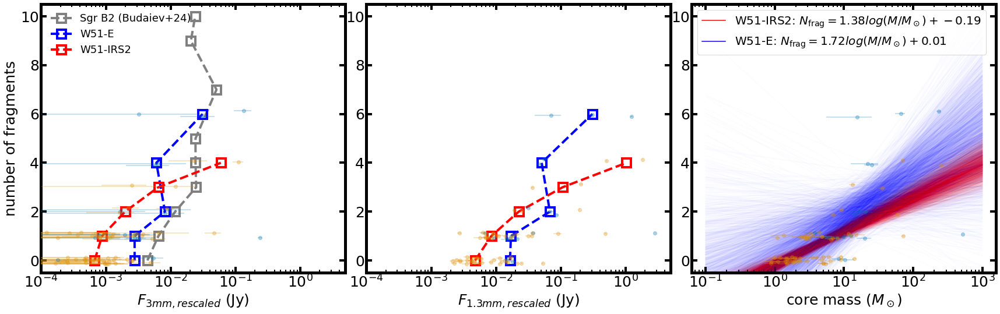

In [10]:
from scipy.optimize import curve_fit
import seaborn as sns
import linmix

cmap = sns.color_palette("colorblind")

def linear(x,a,b):
    return x*a+b
def linear2(x,a,b):
    return 10**x*a+b
fig = plt.figure(figsize=(25,8))
ax2 = fig.add_axes([0.07,0.15,0.29,0.8])
ax1 = fig.add_axes([0.38,0.15,0.29,0.8])
ax3 = fig.add_axes([0.69,0.15,0.29,0.8])

coretemp_w51e_b6_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51n_b6_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_temperature(Path.w51n_almaimf_coretemp)

coreflux_w51e_b6_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.flux[multiplicity_w51e_b6crit_b3fov[1]]
coreflux_w51e_b3_b6crit_b3fov = core_catdata_w51e_b3_b6crit_b3fov.flux[multiplicity_w51e_b6crit_b3fov[1]]
corefluxerr_w51e_b6_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.fluxerr[multiplicity_w51e_b6crit_b3fov[1]]
corefluxerr_w51e_b3_b6crit_b3fov = core_catdata_w51e_b3_b6crit_b3fov.fluxerr[multiplicity_w51e_b6crit_b3fov[1]]

coreflux_w51n_b6_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.flux[multiplicity_w51n_b6crit_b3fov[1]]
coreflux_w51n_b3_b6crit_b3fov = core_catdata_w51n_b3_b6crit_b3fov.flux[multiplicity_w51n_b6crit_b3fov[1]]
corefluxerr_w51n_b6_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.fluxerr[multiplicity_w51n_b6crit_b3fov[1]]
corefluxerr_w51n_b3_b6crit_b3fov = core_catdata_w51n_b3_b6crit_b3fov.fluxerr[multiplicity_w51n_b6crit_b3fov[1]]


coremass_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_coremass(freqb6, kappa_b6, 5.41*u.kpc)
coremass_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_coremass(freqb6, kappa_b6, 5.1*u.kpc)
coremass_err_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_coremasserr()
coremass_err_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_coremasserr()

print(len(coremass_w51e_b6crit_b3fov), len(coremass_w51n_b6crit_b3fov))

jeansmass_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_Jeansmass(dist=5410)
jeansmass_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_Jeansmass(dist=5100)

xarr = np.arange(10)
print(np.array(multiplicity_w51e_b6crit_b3fov[0]))
ax1.errorbar(coreflux_w51e_b6_b6crit_b3fov, np.array(multiplicity_w51e_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51e_b6_b6crit_b3fov,  c=cmap[0], fmt='o',zorder=50,alpha=0.3)
ax1.errorbar(coreflux_w51n_b6_b6crit_b3fov, np.array(multiplicity_w51n_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51n_b6_b6crit_b3fov, c=cmap[1],  fmt='o',zorder=50,alpha=0.3)



ax2.errorbar(coreflux_w51e_b3_b6crit_b3fov, np.array(multiplicity_w51e_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51e_b6_b6crit_b3fov,  c=cmap[0], fmt='o',zorder=50,alpha=0.3)
ax2.errorbar(coreflux_w51n_b3_b6crit_b3fov, np.array(multiplicity_w51n_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51n_b6_b6crit_b3fov, c=cmap[1],  fmt='o',zorder=50,alpha=0.3)

ax3.errorbar(coremass_w51e_b6crit_b3fov, np.array(multiplicity_w51e_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6crit_b3fov[0]))*0.3-0.15,xerr=coremass_err_w51e_b6crit_b3fov, c=cmap[0],  fmt='o',zorder=50,alpha=0.3)
ax3.errorbar(coremass_w51n_b6crit_b3fov, np.array(multiplicity_w51n_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6crit_b3fov[0]))*0.3-0.15,xerr=coremass_err_w51n_b6crit_b3fov, c=cmap[1],   fmt='o',zorder=50,alpha=0.3)


median_w51e_b3fov_b6flux = np.array([np.nanmedian(np.array(coreflux_w51e_b6_b6crit_b3fov)[np.where(multiplicity_w51e_b6crit_b3fov[0]==i)]) for i in xarr])
#median_w51e_b6fov_b6flux = np.array([np.nanmedian(np.array(w51e_b6fov_b6flux)[np.where(multiplicity_w51e_b6fov[4]==i)]) for i in xarr])
median_w51n_b3fov_b6flux = np.array([np.nanmedian(np.array(coreflux_w51n_b6_b6crit_b3fov)[np.where(multiplicity_w51n_b6crit_b3fov[0]==i)]) for i in xarr])
#median_w51n_b6fov_b6flux = np.array([np.nanmedian(np.array(w51n_b6fov_b6flux)[np.where(multiplicity_w51n_b6fov[4]==i)]) for i in xarr])

median_w51e_b3fov_b3flux = np.array([np.nanmedian(np.array(coreflux_w51e_b3_b6crit_b3fov)[np.where(multiplicity_w51e_b6crit_b3fov[0]==i)]) for i in xarr])
#median_w51e_b6fov_b3flux = np.array([np.nanmedian(np.array(w51e_b6fov_b3flux)[np.where(multiplicity_w51e_b6fov[4]==i)]) for i in xarr])
median_w51n_b3fov_b3flux = np.array([np.nanmedian(np.array(coreflux_w51n_b3_b6crit_b3fov)[np.where(multiplicity_w51n_b6crit_b3fov[0]==i)]) for i in xarr])
#median_w51n_b6fov_b3flux = np.array([np.nanmedian(np.array(w51n_b6fov_b3flux)[np.where(multiplicity_w51n_b6fov[4]==i)]) for i in xarr])

median_w51e_mass = np.array([np.nanmedian(np.array(coremass_w51e_b6crit_b3fov)[np.where(multiplicity_w51e_b6crit_b3fov[0]==i)]) for i in xarr])
median_w51n_mass = np.array([np.nanmedian(np.array(coremass_w51n_b6crit_b3fov)[np.where(multiplicity_w51n_b6crit_b3fov[0]==i)]) for i in xarr])


occurances_lowres = [10,  9,  7,  5,  5,  5,  4,  4,  4,  4,  4,  4,  3,  3,  3,  3,  3,
        3,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
lowres_flux = np.array([0.01059128, 0.00909196, 0.02260418, 0.06354622, 0.01073138,
       0.00907187, 0.01514028, 0.01298016, 0.0121241 , 0.0093319 ,
       0.00752502, 0.00507354, 0.04531774, 0.01804966, 0.01133546,
       0.01064564, 0.00771095, 0.00751052, 0.0919993 , 0.06882451,
       0.02418834, 0.00998853, 0.00849448, 0.00624354, 0.00603234,
       0.00553882, 0.00486414, 0.00470662, 0.00348881, 0.00348881,
       0.00209246, 0.00189364, 0.00170339, 0.00133012, 0.01273668,
       0.0123312 , 0.01032122, 0.00919014, 0.00690729, 0.00689153,
       0.00661672, 0.00623315, 0.00558779, 0.00552865, 0.0049822 ,
       0.00488167, 0.00384736, 0.00349865, 0.00336652, 0.00332265,
       0.00319572, 0.00298395, 0.00296533, 0.00292376, 0.00292221,
       0.00281395, 0.00277322, 0.00274509, 0.002736  , 0.00255715,
       0.00253562, 0.00249509, 0.00231837, 0.00220659, 0.00219206,
       0.00197808, 0.00192051, 0.00181068, 0.00169148, 0.00165056,
       0.0014714 , 0.00144944, 0.00136348, 0.0012477 , 0.00113799,
       0.00109437,0.00176712,0.00209246,0.00311928,0.00269714,0.00207316,0.00175978,
                            0.00368528,0.00193705,0.00133012,0.00146678, 0.0008578,0.00411188,
                            0.00181958, 0.0019389,0.0019389,0.00385688])
                   

xarr2 = np.unique(occurances_lowres)

medarr = np.zeros(len(xarr2))
for i,x in enumerate(xarr2):
    ind = np.where(occurances_lowres==x)
    medarr[i] = np.median(lowres_flux[ind])
ax1.plot(median_w51e_b3fov_b6flux[np.isfinite(median_w51e_b3fov_b6flux)], xarr[np.isfinite(median_w51e_b3fov_b6flux)],marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15, label='W51-E')
#ax1.plot(xarr[np.isfinite(median_w51e_b3fov_b6flux)], median_w51e_b3fov_b6flux[np.isfinite(median_w51e_b3fov_b6flux)], marker='s',  mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax1.plot(xarr[np.isfinite(median_w51e_b6fov_b6flux)], median_w51e_b6fov_b6flux[np.isfinite(median_w51e_b6fov_b6flux)], marker='s', mew=4,mec='mediumturquoise', mfc='none',ls='solid', c='mediumturquoise', lw=4,markersize=15)
#ax1.plot(xarr[np.isfinite(median_w51e_b6fov_b6flux)], median_w51e_b6fov_b6flux[np.isfinite(median_w51e_b6fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='solid', c='k', lw=6,markersize=20)
ax1.plot(median_w51n_b3fov_b6flux[np.isfinite(median_w51n_b3fov_b6flux)]*(5.1/5.41)**2,xarr[np.isfinite(median_w51n_b3fov_b6flux)],  marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4,markersize=15, label='W51-IRS2')
#ax1.plot(xarr[np.isfinite(median_w51n_b3fov_b6flux)], median_w51n_b3fov_b6flux[np.isfinite(median_w51n_b3fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax1.plot(xarr[np.isfinite(median_w51n_b6fov_b6flux)], median_w51n_b6fov_b6flux[np.isfinite(median_w51n_b6fov_b6flux)], marker='s', mew=4,mec='tan', mfc='none',ls='solid', c='tan', lw=4,markersize=15)
#ax1.plot(xarr[np.isfinite(median_w51n_b6fov_b6flux)], median_w51n_b6fov_b6flux[np.isfinite(median_w51n_b6fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='solid', c='k', lw=6,markersize=20)

ax2.plot(medarr*(8.13/5.41)**2, xarr2, marker='s', mew=4,mec='gray', mfc='none',ls='dashed', c='gray', lw=4 ,markersize=15, label='Sgr B2 (Budaiev+24)')

ax2.plot(median_w51e_b3fov_b3flux[np.isfinite(median_w51e_b3fov_b3flux)], xarr[np.isfinite(median_w51e_b3fov_b3flux)], marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15, label='W51-E')
#ax1.plot(xarr[np.isfinite(median_w51e_b3fov_b6flux)], median_w51e_b3fov_b6flux[np.isfinite(median_w51e_b3fov_b6flux)], marker='s',  mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax2.plot(xarr[np.isfinite(median_w51e_b6fov_b3flux)], median_w51e_b6fov_b3flux[np.isfinite(median_w51e_b6fov_b3flux)], marker='s', mew=4,mec='mediumturquoise', mfc='none',ls='solid', c='mediumturquoise', lw=4,markersize=15)
#ax1.plot(xarr[np.isfinite(median_w51e_b6fov_b6flux)], median_w51e_b6fov_b6flux[np.isfinite(median_w51e_b6fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='solid', c='k', lw=6,markersize=20)
ax2.plot(median_w51n_b3fov_b3flux[np.isfinite(median_w51n_b3fov_b3flux)]*(5.1/5.41)**2,xarr[np.isfinite(median_w51n_b3fov_b3flux)],  marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4,markersize=15, label='W51-IRS2')
#ax1.plot(xarr[np.isfinite(median_w51n_b3fov_b6flux)], median_w51n_b3fov_b6flux[np.isfinite(median_w51n_b3fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax2.plot(xarr[np.isfinite(median_w51n_b6fov_b3flux)], median_w51n_b6fov_b3flux[np.isfinite(median_w51n_b6fov_b3flux)], marker='s', mew=4,mec='tan', mfc='none',ls='solid', c='tan', lw=4,markersize=15)


#ax3.plot(median_w51e_mass[np.isfinite(median_w51e_mass)], xarr[np.isfinite(median_w51e_mass)], marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15)
#ax3.plot(median_w51n_mass[np.isfinite(median_w51n_mass)], xarr[np.isfinite(median_w51n_mass)],  marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4,markersize=15)

lm = linmix.LinMix(np.log10(coremass_w51n_b6crit_b3fov.value), multiplicity_w51n_b6crit_b3fov[0], coremass_err_w51n_b6crit_b3fov.value/coremass_w51n_b6crit_b3fov.value/np.log(10), np.zeros(len(multiplicity_w51n_b6crit_b3fov[0])), K=2,nchains=100)
lm.run_mcmc(silent=True)
slopes = [] ; intercepts=[]
for i in range(0, len(lm.chain), 100):
    xs = np.logspace(-1,3,100)
    ys = lm.chain[i]['alpha'] + np.log10(xs) * lm.chain[i]['beta']
    if i==0:
        ax3.plot(xs, ys, color='r', alpha=0.01)
    else:
        ax3.plot(xs, ys, color='r', alpha=0.01)
    slopes.append(lm.chain[i]['beta'])
    intercepts.append(lm.chain[i]['alpha'])
slopes_per = np.percentile(slopes,[16,50,84])
intercepts_per= np.percentile(intercepts,[16,50,84])


lm2 = linmix.LinMix(np.log10(coremass_w51e_b6crit_b3fov.value), multiplicity_w51e_b6crit_b3fov[0], coremass_err_w51e_b6crit_b3fov.value/coremass_w51e_b6crit_b3fov.value/np.log(10), np.zeros(len(multiplicity_w51e_b6crit_b3fov[0])), K=2,nchains=100)
lm2.run_mcmc(silent=True)
slopes2 = [] ; intercepts2=[]
for i in range(0, len(lm.chain), 100):
    xs = np.logspace(-1,3,100)
    ys = lm2.chain[i]['alpha'] + np.log10(xs) * lm2.chain[i]['beta']
    if i==0:
        ax3.plot(xs, ys, color='b', alpha=0.01)
    else:
        ax3.plot(xs, ys, color='b', alpha=0.01)
    slopes2.append(lm2.chain[i]['beta'])
    intercepts2.append(lm2.chain[i]['alpha'])    
slopes_per2 = np.percentile(slopes2,[16,50,84])
intercepts_per2= np.percentile(intercepts2,[16,50,84])

ax3.plot([0,0],[0,0],color='r',label=r'W51-IRS2: $N_{\rm frag}=%3.2f log(M/M_\odot)+%3.2f$'%(slopes_per[1],intercepts_per[1]))
ax3.plot([0,0],[0,0],color='b',label=r'W51-E: $N_{\rm frag}=%3.2f log(M/M_\odot)+%3.2f$'%(slopes_per2[1],intercepts_per2[1]))

print(slopes_per[1], slopes_per[0] - slopes_per[1], slopes_per[2]-slopes_per[1])
print(intercepts_per[1], intercepts_per[0] - intercepts_per[1], intercepts_per[2]-intercepts_per[1])
#popt, pcov = curve_fit(linear, np.log10(coremass_w51n_b6crit_b3fov.value), multiplicity_w51n_b6crit_b3fov[0])

#print(popt, pcov)
#xarr = np.linspace(0,3,100)
#ax3.plot(10**xarr, linear(xarr,*popt), ls='dotted', c='k',lw=5, label=r'$N_{\rm frag}=%3.2f log(M/M_\odot) %3.2f$'%(popt[0],popt[1]))

ax1.set_xlabel('$F_{1.3mm, rescaled}$ (Jy)')
ax2.set_xlabel('$F_{3mm, rescaled}$ (Jy)')
ax3.set_xlabel(r'core mass ($M_\odot$)')
ax2.set_ylabel('number of fragments')
#ax2.set_ylabel('number of fragments')
ax2.legend(fontsize=18, frameon=False, loc='upper left')
#ax2.legend(fontsize=18,loc='upper left')
ax1.set_xscale('log')
ax2.set_xscale('log')
ax3.set_xscale('log')
ax3.legend(fontsize=20, loc='upper left')


ax1.set_xlim(1e-4,5)
ax2.set_xlim(1e-4,5)
ax1.set_ylim(-0.5, 10.5)
ax2.set_ylim(-0.5, 10.5)
ax3.set_ylim(-0.5, 10.5)

plt.savefig('frag_coreflux.png')


18 61
[1 6 6 1 2 4 2 2 6 4 1 0 1 1 1 1 1 0]
[-0.18018754646784774, -0.2901264057321583, -0.2885627375657832, -0.1783888582846359, -0.3969761944404866, -0.15904530491090035, -0.21729583226950813, 0.06883333923381968, -0.08150936395896288, -0.23363406010027032, -0.15099884666569685, -0.12772847225435371, -0.26075990722116, -0.09075772760342626, 0.029063670769458816, 0.055708235175950194, -0.18285762495641059, -0.26494915451533974, -0.11552784000991817, -0.0809916605994968, 0.021984197223707452, -0.22626932596239058, -0.30631897774143013, -0.2550899404924474, -0.2892635397035109, -0.1911984352678208, -0.279866719934951, -0.1715867914096139, -0.28480281525663004, -0.1213611025938166, 0.04850707385577696, -0.17242926592408522, -0.43351026875995885, -0.2982725068810339, -0.34799555064379195, 0.08165927956227487, -0.21908301718911463, -0.2920498832993297, -0.28737974241267866, -0.02924215768905944, 0.024820553450629834, -0.1526365144014743, -0.10326271757492822, -0.3225160837843746, -0.044386

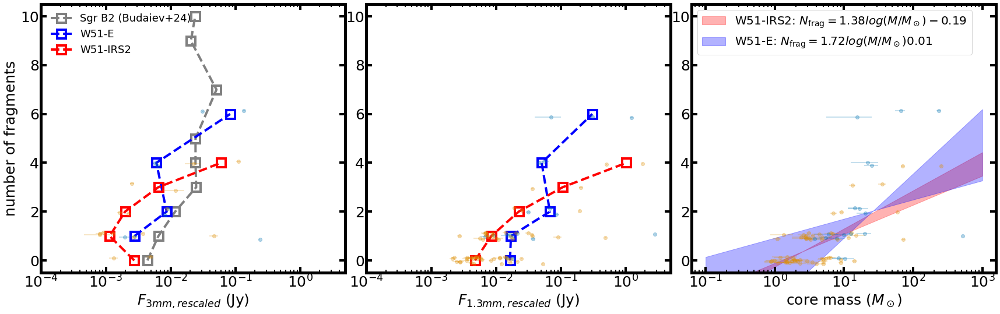

In [11]:
from scipy.optimize import curve_fit
import seaborn as sns
import linmix

cmap = sns.color_palette("colorblind")

def linear(x,a,b):
    return x*a+b
def linear2(x,a,b):
    return 10**x*a+b
fig = plt.figure(figsize=(25,8))
ax2 = fig.add_axes([0.07,0.15,0.29,0.8])
ax1 = fig.add_axes([0.38,0.15,0.29,0.8])
ax3 = fig.add_axes([0.69,0.15,0.29,0.8])

coretemp_w51e_b6_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51n_b6_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_temperature(Path.w51n_almaimf_coretemp)

coreflux_w51e_b6_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.flux[multiplicity_w51e_b6crit_b3fov[1]]
coreflux_w51e_b3_b6crit_b3fov = core_catdata_w51e_b3_b6crit_b3fov.flux[multiplicity_w51e_b6crit_b3fov[1]]
corefluxerr_w51e_b6_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.fluxerr[multiplicity_w51e_b6crit_b3fov[1]]
corefluxerr_w51e_b3_b6crit_b3fov = core_catdata_w51e_b3_b6crit_b3fov.fluxerr[multiplicity_w51e_b6crit_b3fov[1]]

coreflux_w51e_b3_b6b3crit_b3fov = core_catdata_w51e_b3_b6b3crit_b3fov.flux[multiplicity_w51e_b6b3crit_b3fov[1]]
corefluxerr_w51e_b3_b6b3crit_b3fov = core_catdata_w51e_b3_b6b3crit_b3fov.fluxerr[multiplicity_w51e_b6b3crit_b3fov[1]]

coreflux_w51n_b6_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.flux[multiplicity_w51n_b6crit_b3fov[1]]
coreflux_w51n_b3_b6crit_b3fov = core_catdata_w51n_b3_b6crit_b3fov.flux[multiplicity_w51n_b6crit_b3fov[1]]
corefluxerr_w51n_b6_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.fluxerr[multiplicity_w51n_b6crit_b3fov[1]]
corefluxerr_w51n_b3_b6crit_b3fov = core_catdata_w51n_b3_b6crit_b3fov.fluxerr[multiplicity_w51n_b6crit_b3fov[1]]

coreflux_w51n_b3_b6b3crit_b3fov = core_catdata_w51n_b3_b6b3crit_b3fov.flux[multiplicity_w51n_b6b3crit_b3fov[1]]
corefluxerr_w51n_b3_b6b3crit_b3fov = core_catdata_w51n_b3_b6b3crit_b3fov.fluxerr[multiplicity_w51n_b6b3crit_b3fov[1]]

coremass_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_coremass(freqb6, kappa_b6, 5.41*u.kpc)
coremass_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_coremass(freqb6, kappa_b6, 5.1*u.kpc)
coremass_err_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_coremasserr()
coremass_err_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_coremasserr()

print(len(coremass_w51e_b6crit_b3fov), len(coremass_w51n_b6crit_b3fov))

jeansmass_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_Jeansmass(dist=5410)
jeansmass_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_Jeansmass(dist=5100)

xarr = np.arange(10)
print(np.array(multiplicity_w51e_b6crit_b3fov[0]))
ax1.errorbar(coreflux_w51e_b6_b6crit_b3fov, np.array(multiplicity_w51e_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51e_b6_b6crit_b3fov,  c=cmap[0], fmt='o',zorder=50,alpha=0.3)
ax1.errorbar(coreflux_w51n_b6_b6crit_b3fov, np.array(multiplicity_w51n_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51n_b6_b6crit_b3fov, c=cmap[1],  fmt='o',zorder=50,alpha=0.3)

ax2.errorbar(coreflux_w51e_b3_b6b3crit_b3fov, np.array(multiplicity_w51e_b6b3crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6b3crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51e_b3_b6b3crit_b3fov,  c=cmap[0], fmt='o',zorder=50,alpha=0.3)
ax2.errorbar(coreflux_w51n_b3_b6b3crit_b3fov, np.array(multiplicity_w51n_b6b3crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6b3crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51n_b3_b6b3crit_b3fov, c=cmap[1],  fmt='o',zorder=50,alpha=0.3)

#ax2.errorbar(coreflux_w51e_b3_b6crit_b3fov, np.array(multiplicity_w51e_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51e_b6_b6crit_b3fov,  c=cmap[0], fmt='o',zorder=50,alpha=0.3)
#ax2.errorbar(coreflux_w51n_b3_b6crit_b3fov, np.array(multiplicity_w51n_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51n_b6_b6crit_b3fov, c=cmap[1],  fmt='o',zorder=50,alpha=0.3)
#ax2.errorbar(coreflux_w51e_b3_b6crit_b3fov, np.array(multiplicity_w51e_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51e_b6_b6crit_b3fov,  c=cmap[0], fmt='o',zorder=50,alpha=0.3)
#ax2.errorbar(coreflux_w51n_b3_b6crit_b3fov, np.array(multiplicity_w51n_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6crit_b3fov[0]))*0.3-0.15,xerr=corefluxerr_w51n_b6_b6crit_b3fov, c=cmap[1],  fmt='o',zorder=50,alpha=0.3)

ax3.errorbar(coremass_w51e_b6crit_b3fov, np.array(multiplicity_w51e_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51e_b6crit_b3fov[0]))*0.3-0.15,xerr=coremass_err_w51e_b6crit_b3fov, c=cmap[0],  fmt='o',zorder=50,alpha=0.3)
ax3.errorbar(coremass_w51n_b6crit_b3fov, np.array(multiplicity_w51n_b6crit_b3fov[0])+np.random.rand(len(multiplicity_w51n_b6crit_b3fov[0]))*0.3-0.15,xerr=coremass_err_w51n_b6crit_b3fov, c=cmap[1],   fmt='o',zorder=50,alpha=0.3)


median_w51e_b3fov_b6flux = np.array([np.nanmedian(np.array(coreflux_w51e_b6_b6crit_b3fov)[np.where(multiplicity_w51e_b6crit_b3fov[0]==i)]) for i in xarr])
#median_w51e_b6fov_b6flux = np.array([np.nanmedian(np.array(w51e_b6fov_b6flux)[np.where(multiplicity_w51e_b6fov[4]==i)]) for i in xarr])
median_w51n_b3fov_b6flux = np.array([np.nanmedian(np.array(coreflux_w51n_b6_b6crit_b3fov)[np.where(multiplicity_w51n_b6crit_b3fov[0]==i)]) for i in xarr])
#median_w51n_b6fov_b6flux = np.array([np.nanmedian(np.array(w51n_b6fov_b6flux)[np.where(multiplicity_w51n_b6fov[4]==i)]) for i in xarr])

#median_w51e_b3fov_b3flux = np.array([np.nanmedian(np.array(coreflux_w51e_b3_b6crit_b3fov)[np.where(multiplicity_w51e_b6crit_b3fov[0]==i)]) for i in xarr])
median_w51e_b3fov_b3flux = np.array([np.nanmedian(np.array(coreflux_w51e_b3_b6b3crit_b3fov)[np.where(multiplicity_w51e_b6b3crit_b3fov[0]==i)]) for i in xarr])

#median_w51e_b6fov_b3flux = np.array([np.nanmedian(np.array(w51e_b6fov_b3flux)[np.where(multiplicity_w51e_b6fov[4]==i)]) for i in xarr])
#median_w51n_b3fov_b3flux = np.array([np.nanmedian(np.array(coreflux_w51n_b3_b6crit_b3fov)[np.where(multiplicity_w51n_b6crit_b3fov[0]==i)]) for i in xarr])
median_w51n_b3fov_b3flux = np.array([np.nanmedian(np.array(coreflux_w51n_b3_b6b3crit_b3fov)[np.where(multiplicity_w51n_b6b3crit_b3fov[0]==i)]) for i in xarr])

#median_w51n_b6fov_b3flux = np.array([np.nanmedian(np.array(w51n_b6fov_b3flux)[np.where(multiplicity_w51n_b6fov[4]==i)]) for i in xarr])

median_w51e_mass = np.array([np.nanmedian(np.array(coremass_w51e_b6crit_b3fov)[np.where(multiplicity_w51e_b6crit_b3fov[0]==i)]) for i in xarr])
median_w51n_mass = np.array([np.nanmedian(np.array(coremass_w51n_b6crit_b3fov)[np.where(multiplicity_w51n_b6crit_b3fov[0]==i)]) for i in xarr])


occurances_lowres = [10,  9,  7,  5,  5,  5,  4,  4,  4,  4,  4,  4,  3,  3,  3,  3,  3,
        3,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
lowres_flux = np.array([0.01059128, 0.00909196, 0.02260418, 0.06354622, 0.01073138,
       0.00907187, 0.01514028, 0.01298016, 0.0121241 , 0.0093319 ,
       0.00752502, 0.00507354, 0.04531774, 0.01804966, 0.01133546,
       0.01064564, 0.00771095, 0.00751052, 0.0919993 , 0.06882451,
       0.02418834, 0.00998853, 0.00849448, 0.00624354, 0.00603234,
       0.00553882, 0.00486414, 0.00470662, 0.00348881, 0.00348881,
       0.00209246, 0.00189364, 0.00170339, 0.00133012, 0.01273668,
       0.0123312 , 0.01032122, 0.00919014, 0.00690729, 0.00689153,
       0.00661672, 0.00623315, 0.00558779, 0.00552865, 0.0049822 ,
       0.00488167, 0.00384736, 0.00349865, 0.00336652, 0.00332265,
       0.00319572, 0.00298395, 0.00296533, 0.00292376, 0.00292221,
       0.00281395, 0.00277322, 0.00274509, 0.002736  , 0.00255715,
       0.00253562, 0.00249509, 0.00231837, 0.00220659, 0.00219206,
       0.00197808, 0.00192051, 0.00181068, 0.00169148, 0.00165056,
       0.0014714 , 0.00144944, 0.00136348, 0.0012477 , 0.00113799,
       0.00109437,0.00176712,0.00209246,0.00311928,0.00269714,0.00207316,0.00175978,
                            0.00368528,0.00193705,0.00133012,0.00146678, 0.0008578,0.00411188,
                            0.00181958, 0.0019389,0.0019389,0.00385688])
                   

xarr2 = np.unique(occurances_lowres)

medarr = np.zeros(len(xarr2))
for i,x in enumerate(xarr2):
    ind = np.where(occurances_lowres==x)
    medarr[i] = np.median(lowres_flux[ind])
ax1.plot(median_w51e_b3fov_b6flux[np.isfinite(median_w51e_b3fov_b6flux)], xarr[np.isfinite(median_w51e_b3fov_b6flux)],marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15, label='W51-E')
#ax1.plot(xarr[np.isfinite(median_w51e_b3fov_b6flux)], median_w51e_b3fov_b6flux[np.isfinite(median_w51e_b3fov_b6flux)], marker='s',  mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax1.plot(xarr[np.isfinite(median_w51e_b6fov_b6flux)], median_w51e_b6fov_b6flux[np.isfinite(median_w51e_b6fov_b6flux)], marker='s', mew=4,mec='mediumturquoise', mfc='none',ls='solid', c='mediumturquoise', lw=4,markersize=15)
#ax1.plot(xarr[np.isfinite(median_w51e_b6fov_b6flux)], median_w51e_b6fov_b6flux[np.isfinite(median_w51e_b6fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='solid', c='k', lw=6,markersize=20)
ax1.plot(median_w51n_b3fov_b6flux[np.isfinite(median_w51n_b3fov_b6flux)]*(5.1/5.41)**2,xarr[np.isfinite(median_w51n_b3fov_b6flux)],  marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4,markersize=15, label='W51-IRS2')
#ax1.plot(xarr[np.isfinite(median_w51n_b3fov_b6flux)], median_w51n_b3fov_b6flux[np.isfinite(median_w51n_b3fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax1.plot(xarr[np.isfinite(median_w51n_b6fov_b6flux)], median_w51n_b6fov_b6flux[np.isfinite(median_w51n_b6fov_b6flux)], marker='s', mew=4,mec='tan', mfc='none',ls='solid', c='tan', lw=4,markersize=15)
#ax1.plot(xarr[np.isfinite(median_w51n_b6fov_b6flux)], median_w51n_b6fov_b6flux[np.isfinite(median_w51n_b6fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='solid', c='k', lw=6,markersize=20)

ax2.plot(medarr*(8.13/5.41)**2, xarr2, marker='s', mew=4,mec='gray', mfc='none',ls='dashed', c='gray', lw=4 ,markersize=15, label='Sgr B2 (Budaiev+24)')

ax2.plot(median_w51e_b3fov_b3flux[np.isfinite(median_w51e_b3fov_b3flux)], xarr[np.isfinite(median_w51e_b3fov_b3flux)], marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15, label='W51-E')
#ax2.plot(median_w51e_b3fov_b3flux[np.isfinite(median_w51e_b3fov_b3flux)], xarr[np.isfinite(median_w51e_b3fov_b3flux)], marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15, label='W51-E')
#ax1.plot(xarr[np.isfinite(median_w51e_b3fov_b6flux)], median_w51e_b3fov_b6flux[np.isfinite(median_w51e_b3fov_b6flux)], marker='s',  mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax2.plot(xarr[np.isfinite(median_w51e_b6fov_b3flux)], median_w51e_b6fov_b3flux[np.isfinite(median_w51e_b6fov_b3flux)], marker='s', mew=4,mec='mediumturquoise', mfc='none',ls='solid', c='mediumturquoise', lw=4,markersize=15)
#ax1.plot(xarr[np.isfinite(median_w51e_b6fov_b6flux)], median_w51e_b6fov_b6flux[np.isfinite(median_w51e_b6fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='solid', c='k', lw=6,markersize=20)
ax2.plot(median_w51n_b3fov_b3flux[np.isfinite(median_w51n_b3fov_b3flux)]*(5.1/5.41)**2,xarr[np.isfinite(median_w51n_b3fov_b3flux)],  marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4,markersize=15, label='W51-IRS2')
#ax2.plot(median_w51n_b3fov_b3flux[np.isfinite(median_w51n_b3fov_b3flux)]*(5.1/5.41)**2,xarr[np.isfinite(median_w51n_b3fov_b3flux)],  marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4,markersize=15, label='W51-IRS2')
#ax1.plot(xarr[np.isfinite(median_w51n_b3fov_b6flux)], median_w51n_b3fov_b6flux[np.isfinite(median_w51n_b3fov_b6flux)], marker='s', mew=4,mec='k', mfc='none',ls='dashed', c='k', lw=6,markersize=20)
#ax2.plot(xarr[np.isfinite(median_w51n_b6fov_b3flux)], median_w51n_b6fov_b3flux[np.isfinite(median_w51n_b6fov_b3flux)], marker='s', mew=4,mec='tan', mfc='none',ls='solid', c='tan', lw=4,markersize=15)


#ax3.plot(median_w51e_mass[np.isfinite(median_w51e_mass)], xarr[np.isfinite(median_w51e_mass)], marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15)
#ax3.plot(median_w51n_mass[np.isfinite(median_w51n_mass)], xarr[np.isfinite(median_w51n_mass)],  marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4,markersize=15)


slopes_per = np.percentile(slopes,[16,50,84])
per_idx = [np.argmin(np.abs(slopes_per[i]-slopes)) for i in range(3)]
print(intercepts)
print(per_idx)
intercepts_percentile = np.array(intercepts)[per_idx]

xs = np.logspace(-1,3,100)

ax3.fill_between(xs, intercepts_percentile[0] + np.log10(xs) * slopes_per[0], intercepts_percentile[2] + np.log10(xs) * slopes_per[2], color='r', alpha=0.3, label=r'W51-IRS2: $N_{\rm frag}=%3.2f log(M/M_\odot)%3.2f$'%(slopes_per[1],intercepts_per[1]))


slopes_per2 = np.percentile(slopes2,[16,50,84])
per_idx2 = [np.argmin(np.abs(slopes_per2[i]-slopes2)) for i in range(3)]
intercepts_percentile2 = np.array(intercepts2)[per_idx2]

xs = np.logspace(-1,3,100)

ax3.fill_between(xs, intercepts_percentile2[0] + np.log10(xs) * slopes_per2[0], intercepts_percentile2[2] + np.log10(xs) * slopes_per2[2], color='b', alpha=0.3, label=r'W51-E: $N_{\rm frag}=%3.2f log(M/M_\odot)%3.2f$'%(slopes_per2[1],intercepts_per2[1]))


print(slopes_per[1], slopes_per[0] - slopes_per[1], slopes_per[2]-slopes_per[1])
print(intercepts_per[1], intercepts_per[0] - intercepts_per[1], intercepts_per[2]-intercepts_per[1])
#popt, pcov = curve_fit(linear, np.log10(coremass_w51n_b6crit_b3fov.value), multiplicity_w51n_b6crit_b3fov[0])

#print(popt, pcov)
#xarr = np.linspace(0,3,100)
#ax3.plot(10**xarr, linear(xarr,*popt), ls='dotted', c='k',lw=5, label=r'$N_{\rm frag}=%3.2f log(M/M_\odot) %3.2f$'%(popt[0],popt[1]))

ax1.set_xlabel('$F_{1.3mm, rescaled}$ (Jy)')
ax2.set_xlabel('$F_{3mm, rescaled}$ (Jy)')
ax3.set_xlabel(r'core mass ($M_\odot$)')
ax2.set_ylabel('number of fragments')
#ax2.set_ylabel('number of fragments')
ax2.legend(fontsize=18, frameon=False, loc='upper left')
#ax2.legend(fontsize=18,loc='upper left')
ax1.set_xscale('log')
ax2.set_xscale('log')
ax3.set_xscale('log')
ax3.legend(fontsize=20, loc='upper left')


ax1.set_xlim(1e-4,5)
ax2.set_xlim(1e-4,5)
ax1.set_ylim(-0.5, 10.5)
ax2.set_ylim(-0.5, 10.5)
ax3.set_ylim(-0.5, 10.5)

plt.savefig('frag_coreflux.png')


plot_core_yso_all_frags
74.3581466048325 0.013474053706232923
14.043284758128117 0.0003153518010101991
4.761292175505526 0.004542154024313543
5.152940264071296 0.0006506660677287158
8.978226922105135 0.0022535609993707627
53.30531953257406 0.0035614997492080364
2.798066026618314 3.152573129882521e-05
7.135563695327944 0.00015301014050677196
2.5070896716840863 0.003436390991352203
2.637152584206991 0.0008191273659191293
9.204801740326415 0.003990379565141213
4.173085390918059 0.001825483018900693
3.4256507149034827 0.0018329986267881352
2.176106959270694 0.0008833479990814866
6.55874729377176 0.0005666570865758652
6.693217592077987 0.017159713577631977
1.4138236025577924 4.058140571732828e-05
0.604291017081603 4.8612954434767454e-05
1.419201542518216 7.787290333406555e-05
2.5707386128255965 2.1109702542152204e-05
0.9406861940979714 1.458723974853614e-05
0.9917052826488627 0.00011950355786615812
3.6463525656828564 0.00011978027165180874
5.747689605349047 0.0034658337237081388
1.833545869

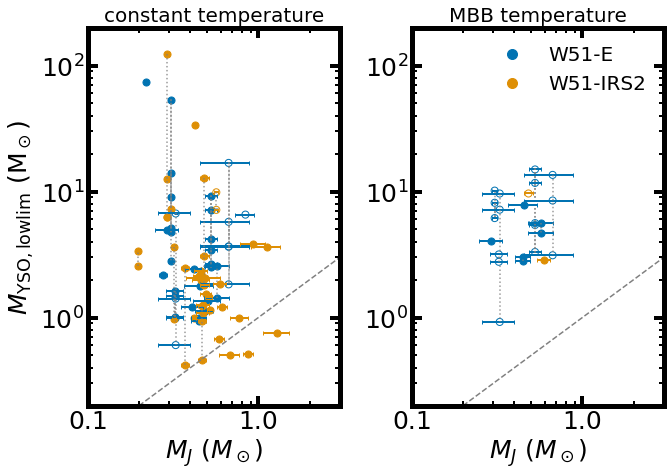

In [12]:
from matplotlib import ticker

fig = plt.figure(figsize=(10,7))
ax1 = fig.add_axes([0.15,0.17,0.35,0.75])
ax2 = fig.add_axes([0.6,0.17,0.35,0.75])
coretemp_catdata_w51e_b6_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_catdata_w51n_b6_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_temperature(Path.w51n_almaimf_coretemp)

coremass_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_coremass(freqb6, kappa_b6, 5.41*u.kpc)
coremass_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_coremass(freqb6, kappa_b6, 5.1*u.kpc)
coremass_err_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_coremasserr()
coremass_err_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_coremasserr()

jeansmass_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_Jeansmass(dist=5410)
jeansmass_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_Jeansmass(dist=5100)
jeansmasserr_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_Jeansmasserr(dist=5410)
jeansmasserr_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_Jeansmasserr(dist=5100)

BEmass_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_BE_mass(dist=5410)
BEmass_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_BE_mass(dist=5100)
BEmasserr_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_BE_masserr(dist=5410)
BEmasserr_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_BE_masserr(dist=5100)

ysomass_constT_w51e = catalog_w51e_yso['constT_mass']
ysomass_constT_w51n = catalog_w51n_yso['constT_mass']
ysomass_MBBT_w51e = catalog_w51e_yso['MBBT_mass']
ysomass_MBBT_w51n = catalog_w51n_yso['MBBT_mass']

ysomass_err_constT_w51e = catalog_w51e_yso['constT_mass_err']
ysomass_err_constT_w51n = catalog_w51n_yso['constT_mass_err']
ysomass_err_MBBT_w51e = catalog_w51e_yso['MBBT_mass_err']
ysomass_err_MBBT_w51n = catalog_w51n_yso['MBBT_mass_err']

ysomass_constT_w51e_b6crit_b3fov = [ysomass_constT_w51e[ind] for ind in multiplicity_w51e_b6crit_b3fov[2]]
ysomass_constT_w51n_b6crit_b3fov = [ysomass_constT_w51n[ind] for ind in multiplicity_w51n_b6crit_b3fov[2]]
ysomass_err_constT_w51e_b6crit_b3fov = [ysomass_err_constT_w51e[ind] for ind in multiplicity_w51e_b6crit_b3fov[2]]
ysomass_err_constT_w51n_b6crit_b3fov = [ysomass_err_constT_w51n[ind] for ind in multiplicity_w51n_b6crit_b3fov[2]]

ysomass_MBBT_w51e_b6crit_b3fov = [ysomass_MBBT_w51e[ind] for ind in multiplicity_w51e_b6crit_b3fov[2]]
ysomass_MBBT_w51n_b6crit_b3fov = [ysomass_MBBT_w51n[ind] for ind in multiplicity_w51n_b6crit_b3fov[2]]
ysomass_err_MBBT_w51e_b6crit_b3fov = [ysomass_err_MBBT_w51e[ind] for ind in multiplicity_w51e_b6crit_b3fov[2]]
ysomass_err_MBBT_w51n_b6crit_b3fov = [ysomass_err_MBBT_w51n[ind] for ind in multiplicity_w51n_b6crit_b3fov[2]]


ax1.set_xscale('log')
ax2.set_xscale('log')
ax1.set_xlim(0.1,3)
ax2.set_xlim(0.1,3)
ax1.set_ylim(0.2,2e2)
ax2.set_ylim(0.2,2e2)
ax1.set_xlabel(r'$M_J$ ($M_\odot$)')
ax2.set_xlabel(r'$M_J$ ($M_\odot$)')
ax1.set_ylabel(r'$M_{\rm YSO}$')
#protostellarind_w51e_b3fov_woff = [i for i, ind in enumerate(ysoindarr_w51e_b3fov_woff) if len(ind)>0]
#protostellarind_w51n_b3fov_woff = [i for i, ind in enumerate(ysoindarr_w51n_b3fov_woff) if len(ind)>0]
#plot_core_yso_all_frags(ax5, coreflux_w51e_b6_b6fov_woff, ysoflux_w51e_b6_woff, corefluxerr_w51e_b6_woff,  ysoflux_err_w51e_b6_woff, color=cmap[0])
plot_core_yso_all_frags(ax1, jeansmass_w51e_b6crit_b3fov, ysomass_constT_w51e_b6crit_b3fov,   jeansmasserr_w51e_b6crit_b3fov, ysomass_err_constT_w51e_b6crit_b3fov, color=cmap[0])
plot_core_yso_all_frags(ax1, jeansmass_w51n_b6crit_b3fov, ysomass_constT_w51n_b6crit_b3fov,  jeansmasserr_w51n_b6crit_b3fov, ysomass_err_constT_w51n_b6crit_b3fov, color=cmap[1])
plot_core_yso_all_frags(ax2, jeansmass_w51e_b6crit_b3fov, ysomass_MBBT_w51e_b6crit_b3fov,  jeansmasserr_w51e_b6crit_b3fov, ysomass_err_MBBT_w51e_b6crit_b3fov,color=cmap[0])
plot_core_yso_all_frags(ax2, jeansmass_w51n_b6crit_b3fov, ysomass_MBBT_w51n_b6crit_b3fov,   jeansmasserr_w51n_b6crit_b3fov, ysomass_err_MBBT_w51n_b6crit_b3fov,color=cmap[1])

ax1.set_xscale('log')
ax1.set_yscale('log')
ax2.set_xscale('log')
ax2.set_yscale('log')
#ax5.set_ylim(1e-3,3e-1)
#ax5.set_xlim(1e-2,5)
#ax6.set_ylim(1e-4,1e-1)
#ax6.set_xlim(5e-4,5e-1)

ax1.set_xlabel(r'$M_{J}$ $(M_\odot)$')
ax2.set_xlabel(r'$M_{J}$ $(M_\odot)$')
ax1.set_ylabel(r'$M_{\rm YSO, lowlim}$ (M$_\odot$)')
#ax6.set_ylabel(r'$F_{\rm YSO, 3mm}$ (Jy)')
ax2.legend(handles=handles,fontsize=20, frameon=False)
ax1.set_title('constant temperature',fontsize=20)
ax1.set_xticks([0.1,1])
ax2.set_xticks([0.1,1])
ax1.plot([0.1,3],[0.1,3], ls='dashed', c='gray')
ax2.plot([0.1,3],[0.1,3], ls='dashed', c='gray')


ax2.set_title('MBB temperature',fontsize=20)
ax1.xaxis.set_major_formatter(ticker.ScalarFormatter())
ax1.xaxis.set_minor_formatter(ticker.NullFormatter())
ax2.xaxis.set_major_formatter(ticker.ScalarFormatter())
ax2.xaxis.set_minor_formatter(ticker.NullFormatter())
plt.savefig('jeans.png')

plot_core_yso_all_frags
74.3581466048325 0.013474053706232923
14.043284758128117 0.0003153518010101991
4.761292175505526 0.004542154024313543
5.152940264071296 0.0006506660677287158
8.978226922105135 0.0022535609993707627
53.30531953257406 0.0035614997492080364
2.798066026618314 3.152573129882521e-05
7.135563695327944 0.00015301014050677196
2.5070896716840863 0.003436390991352203
2.637152584206991 0.0008191273659191293
9.204801740326415 0.003990379565141213
4.173085390918059 0.001825483018900693
3.4256507149034827 0.0018329986267881352
2.176106959270694 0.0008833479990814866
6.55874729377176 0.0005666570865758652
6.693217592077987 0.017159713577631977
1.4138236025577924 4.058140571732828e-05
0.604291017081603 4.8612954434767454e-05
1.419201542518216 7.787290333406555e-05
2.5707386128255965 2.1109702542152204e-05
0.9406861940979714 1.458723974853614e-05
0.9917052826488627 0.00011950355786615812
3.6463525656828564 0.00011978027165180874
5.747689605349047 0.0034658337237081388
1.833545869

3.0791620474734187 1.4693922298093515e-05
1.7998976797758823 2.1173203964979975e-05
7.311511257139029 0.005599230349347373
0.9831090999338054 0.00011134466073144994
3.600598807602502 2.911515708704719e-05
0.9761643939550744 0.001798671990501983
2.2288597970095987 5.592782282795109e-05
2.468909133034574 0.000440711105338057
0.42059690317715565 0.006949958172813169
1.2280564441925639 0.0002174378276411037
0.9466224917953147 0.0002481867450701859
0.46247337552391626 0.00041462681741139137
1.1385658599628719 0.0006562686721627692
1.4565402822459443 0.0007403895849244481
1.8554085048846547 0.00017084724345001694
2.1464118261521326 6.779772631410196e-06
2.358897165818809 0.00034227428777825034
3.820977316639363 8.271338199946485e-05
0.6783646587512457 0.0001496689325145511
1.2654523573878946 0.00019370770469749878
1.9747678960148098 1.1902105400116856e-05
0.5052312611402341 0.00030940882225344996
0.993153533753973 6.678332139364187e-05
0.5088468763691049 7.17522873221771e-05
1.20670648530467

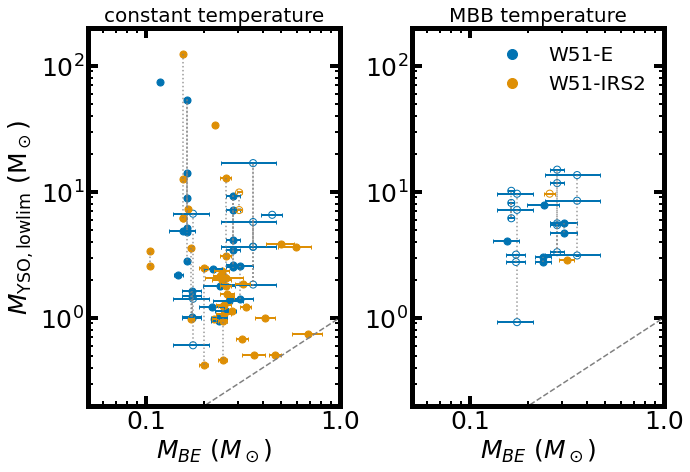

In [13]:
fig = plt.figure(figsize=(10,7))
ax1 = fig.add_axes([0.15,0.17,0.35,0.75])
ax2 = fig.add_axes([0.6,0.17,0.35,0.75])

ax1.set_xscale('log')
ax2.set_xscale('log')
ax1.set_xlim(0.05,1)
ax2.set_xlim(0.05,1)
ax1.set_ylim(0.2,2e2)
ax2.set_ylim(0.2,2e2)
ax1.set_xlabel(r'$M_J$ ($M_\odot$)')
ax2.set_xlabel(r'$M_J$ ($M_\odot$)')
ax1.set_ylabel(r'$M_{\rm YSO}$')
#protostellarind_w51e_b3fov_woff = [i for i, ind in enumerate(ysoindarr_w51e_b3fov_woff) if len(ind)>0]
#protostellarind_w51n_b3fov_woff = [i for i, ind in enumerate(ysoindarr_w51n_b3fov_woff) if len(ind)>0]
#plot_core_yso_all_frags(ax5, coreflux_w51e_b6_b6fov_woff, ysoflux_w51e_b6_woff, corefluxerr_w51e_b6_woff,  ysoflux_err_w51e_b6_woff, color=cmap[0])
plot_core_yso_all_frags(ax1, BEmass_w51e_b6crit_b3fov, ysomass_constT_w51e_b6crit_b3fov,   BEmasserr_w51e_b6crit_b3fov, ysomass_err_constT_w51e_b6crit_b3fov, color=cmap[0])
plot_core_yso_all_frags(ax1, BEmass_w51n_b6crit_b3fov, ysomass_constT_w51n_b6crit_b3fov,  BEmasserr_w51n_b6crit_b3fov, ysomass_err_constT_w51n_b6crit_b3fov, color=cmap[1])
plot_core_yso_all_frags(ax2, BEmass_w51e_b6crit_b3fov, ysomass_MBBT_w51e_b6crit_b3fov,  BEmasserr_w51e_b6crit_b3fov, ysomass_err_MBBT_w51e_b6crit_b3fov,color=cmap[0])
plot_core_yso_all_frags(ax2, BEmass_w51n_b6crit_b3fov, ysomass_MBBT_w51n_b6crit_b3fov,   BEmasserr_w51n_b6crit_b3fov, ysomass_err_MBBT_w51n_b6crit_b3fov,color=cmap[1])

ax1.set_xscale('log')
ax1.set_yscale('log')
ax2.set_xscale('log')
ax2.set_yscale('log')
#ax5.set_ylim(1e-3,3e-1)
#ax5.set_xlim(1e-2,5)
#ax6.set_ylim(1e-4,1e-1)
#ax6.set_xlim(5e-4,5e-1)

ax1.set_xlabel(r'$M_{BE}$ $(M_\odot)$')
ax2.set_xlabel(r'$M_{BE}$ $(M_\odot)$')
ax1.set_ylabel(r'$M_{\rm YSO, lowlim}$ (M$_\odot$)')
#ax6.set_ylabel(r'$F_{\rm YSO, 3mm}$ (Jy)')
ax2.legend(handles=handles,fontsize=20, frameon=False)
ax1.set_title('constant temperature',fontsize=20)
ax1.set_xticks([0.1,1])
ax2.set_xticks([0.1,1])
ax1.plot([0.1,3],[0.1,3], ls='dashed', c='gray')
ax2.plot([0.1,3],[0.1,3], ls='dashed', c='gray')


ax2.set_title('MBB temperature',fontsize=20)
ax1.xaxis.set_major_formatter(ticker.ScalarFormatter())
ax1.xaxis.set_minor_formatter(ticker.NullFormatter())
ax2.xaxis.set_major_formatter(ticker.ScalarFormatter())
ax2.xaxis.set_minor_formatter(ticker.NullFormatter())
plt.savefig('BE.png')

print(BEmass_w51e_b6crit_b3fov/jeansmass_w51e_b6crit_b3fov)
print(BEmass_w51n_b6crit_b3fov/jeansmass_w51n_b6crit_b3fov)


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


0.05108738675987805 0.005780292104979516 0.07794530810835665
0.0 0.0 0.15632312014802435
2 32 5
0.40700000000000003 1.2323071857292724
0.1836842105263158


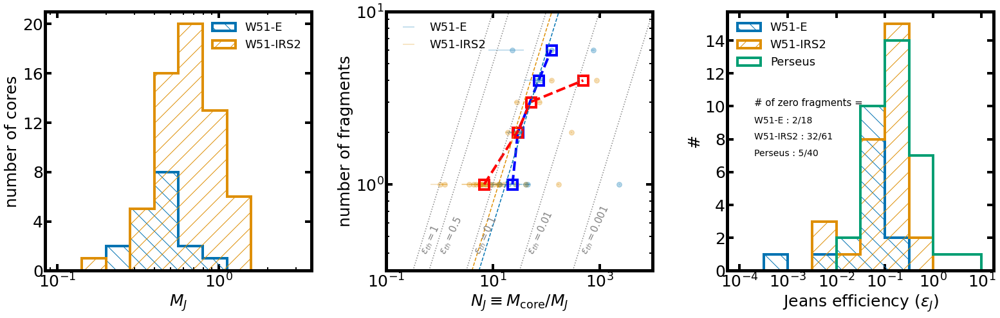

In [14]:
fig = plt.figure(figsize=(23,7))
ax3 = fig.add_axes([0.07,0.15,0.25,0.8])
ax1 = fig.add_axes([0.39,0.15,0.25,0.8])
ax2 = fig.add_axes([0.71,0.15,0.25,0.8])
bins = np.logspace(-1, 0.5, 11)
ax3.hist(jeansmass_w51e_b6crit_b3fov.value,  bins=bins,histtype='step', color=cmap[0], label='W51-E', hatch='\\', lw=4)
ax3.hist(jeansmass_w51n_b6crit_b3fov.value,  bins=bins,histtype='step', color=cmap[1], label='W51-IRS2', hatch='/', lw=4)
ax3.set_xlabel('$M_J$')
ax3.set_xscale('log')
ax3.set_ylabel('number of cores')
ax3.legend(fontsize=18, frameon=False)
ax3.set_yticks([0,4,8,12,16,20])
jeans_number_w51e = coremass_w51e_b6crit_b3fov/jeansmass_w51e_b6crit_b3fov
jeans_number_w51n = coremass_w51n_b6crit_b3fov/jeansmass_w51n_b6crit_b3fov
ax1.scatter(jeans_number_w51e, multiplicity_w51e_b6crit_b3fov[0], s=60,c=cmap[0],alpha=0.3)
ax1.scatter(jeans_number_w51n, multiplicity_w51n_b6crit_b3fov[0], s=60,c=cmap[1],alpha=0.3)

ax1.errorbar(jeans_number_w51e, multiplicity_w51e_b6crit_b3fov[0], 
            xerr = coremass_err_w51e_b6crit_b3fov/jeansmass_w51e_b6crit_b3fov, c=cmap[0], fmt='none',label='W51-E',alpha=0.3)
ax1.errorbar(jeans_number_w51n, multiplicity_w51n_b6crit_b3fov[0], 
            xerr = coremass_err_w51n_b6crit_b3fov/jeansmass_w51n_b6crit_b3fov, c=cmap[1], fmt='none',label='W51-IRS2',alpha=0.3)


xarr = np.arange(9)+1

median_w51e_ratio = np.array([np.nanmedian(jeans_number_w51e[np.where(multiplicity_w51e_b6crit_b3fov[0]==i)]) for i in xarr])
median_w51n_ratio = np.array([np.nanmedian(jeans_number_w51n[np.where(multiplicity_w51n_b6crit_b3fov[0]==i)]) for i in xarr])

ax1.plot(median_w51e_ratio[np.isfinite(median_w51e_ratio)], xarr[np.isfinite(median_w51e_ratio)],marker='s', mew=4,mec='b', mfc='none',ls='dashed', c='b', lw=4 ,markersize=15)
ax1.plot(median_w51n_ratio[np.isfinite(median_w51n_ratio)], xarr[np.isfinite(median_w51n_ratio)],marker='s', mew=4,mec='r', mfc='none',ls='dashed', c='r', lw=4 ,markersize=15, )
w51e_average = np.average(multiplicity_w51e_b6crit_b3fov[0]/jeans_number_w51e)
w51n_average = np.average(multiplicity_w51n_b6crit_b3fov[0]/jeans_number_w51n)

#median_w51e_ratio = np.array([np.nanmedian(coremass_w51e_selected[np.where(multiplicity_w51e_b3fov[4]==i)]/bemass_w51e_selected[np.where(multiplicity_w51e_b3fov[4]==i)]) for i in xarr])
#median_w51n_ratio = np.array([np.nanmedian(coremass_w51n_selected[np.where(multiplicity_w51n_b3fov[4]==i)]/bemass_w51n_selected[np.where(multiplicity_w51n_b3fov[4]==i)]) for i in xarr])
#ax1.plot(median_w51e_ratio[np.isfinite(median_w51e_ratio)], xarr[np.isfinite(median_w51e_ratio)],marker='s', mew=4,mec='mediumturquoise', mfc='none',ls='dashed', c='mediumturquoise', lw=4 ,markersize=15, label='W51-E')
#ax1.plot(median_w51n_ratio[np.isfinite(median_w51n_ratio)], xarr[np.isfinite(median_w51n_ratio)],marker='s', mew=4,mec='tan', mfc='none',ls='dashed', c='tan', lw=4 ,markersize=15, label='W51-IRS2')

ax1.set_xlabel(r'$N_{J}\equiv M_{\rm core}/M_{J}$')
ax1.set_ylabel('number of fragments')
ax1.legend(fontsize=18, frameon=False)
ax1.set_xscale('log')
ax1.set_yscale('log')
ax1.set_ylim(0.9,10)
ax1.plot([10**-0.5,1e3],[10**-0.5,1e3], ls='dotted',c='gray')
ax1.plot([10**-0.5/0.5,1e3/0.5],[10**-0.5,1e3], ls='dotted',c='gray')
ax1.plot([10**-0.5/0.1,1e3/0.1],[10**-0.5,1e3], ls='dotted',c='gray')
ax1.plot([10**-0.5/0.01,1e3/0.01],[10**-0.5,1e3], ls='dotted',c='gray')
ax1.plot([10**-0.5/0.001,1e3/0.001],[10**-0.5,1e3], ls='dotted',c='gray')

ax1.plot([10**-0.5/w51e_average,1e3/w51e_average],[10**-0.5,1e3], ls='dashed',c=cmap[0])
ax1.plot([10**-0.5/w51n_average,1e3/w51n_average],[10**-0.5,1e3], ls='dashed',c=cmap[1])

ax1.text(0.4, 0.4, r'$\epsilon_{th}=1$',fontsize=15, color='gray',rotation=65)
ax1.text(0.9, 0.4, r'$\epsilon_{th}=0.5$',fontsize=15, color='gray',rotation=65)
ax1.text(4, 0.4, r'$\epsilon_{th}=0.1$',fontsize=15, color='gray',rotation=65)
ax1.text(40, 0.4, r'$\epsilon_{th}=0.01$',fontsize=15, color='gray',rotation=65)
ax1.text(400, 0.4, r'$\epsilon_{th}=0.001$',fontsize=15, color='gray',rotation=65)

jeans_efficiency_w51e = multiplicity_w51e_b6crit_b3fov[0]/jeans_number_w51e
jeans_efficiency_w51n = multiplicity_w51n_b6crit_b3fov[0]/jeans_number_w51n
print(np.median(jeans_efficiency_w51e), np.percentile(jeans_efficiency_w51e, 16), np.percentile(jeans_efficiency_w51e, 84))
print(np.median(jeans_efficiency_w51n), np.percentile(jeans_efficiency_w51n, 16), np.percentile(jeans_efficiency_w51n, 84))


ax1.set_xlim(1e-1,1e4)
ax1.set_ylim(10**-0.5,10)

pokhrel18 = np.array([0.14, 0.07, 0.08, 0.23, 0.53, 0, 1.38, 0.18, 0, 0, 0.09, 0.79, 0.03, 0.07, 0.28, 0.1,0.01,
            0.1, 0.04, 0.1, 0.27, 0.37, 0.63, 0.44, 0.18, 0.08, 0.0, 0.04, 0.1, 0.04, 0.6, 0.06, 0.26,
            0.23, 0.06,0.14, 0, 7.92, 0.44, 0.2])
pokhrel182 = [0.14, 0.07, 0.08, 0.23, 0.53, 0.0,  0.18, 0, 0, 0.09, 0.79, 0.03, 0.07, 0.28, 0.1,0.01,
            0.1, 0.04, 0.1, 0.27, 0.37, 0.63, 0.44, 0.18, 0.08, 0.0, 0.04, 0.1, 0.04, 0.6, 0.06, 0.26,
            0.23, 0.06,0.14, 0, 0.44, 0.2]
bins = np.logspace(-4,1,11)
zerocount_w51e = len(np.where( np.array(multiplicity_w51e_b6crit_b3fov[0])==0)[0])
zerocount_w51n = len(np.where( np.array(multiplicity_w51n_b6crit_b3fov[0])==0)[0])
zerocount_pokhrel = len(np.where(pokhrel18==0.0)[0])
print(zerocount_w51e, zerocount_w51n, zerocount_pokhrel)
ax2.hist(jeans_efficiency_w51e,  bins=bins,histtype='step', color=cmap[0], label='W51-E', hatch='\\', lw=4)
ax2.hist(jeans_efficiency_w51n,  bins=bins,histtype='step', color=cmap[1], label='W51-IRS2', hatch='/',lw=4)
ax2.hist(pokhrel18, bins=bins, histtype='step', color=cmap[2],lw=4, label='Perseus' )
ax2.legend(fontsize=18,loc='upper left', frameon=False)
ax2.set_xscale('log')
ax2.set_xlabel(r'Jeans efficiency ($\epsilon_J$)')
ax2.set_ylabel('#')
ax2.set_xticks([1e-4,1e-3,1e-2,1e-1,1e0,1e1])
ax2.text(2e-4,10, '# of zero fragments = ',fontsize=15) 
ax2.text(2e-4,9, 'W51-E : %d/%d'%(zerocount_w51e, len(jeans_efficiency_w51e)),fontsize=14)
ax2.text(2e-4,8, 'W51-IRS2 : %d/%d'%(zerocount_w51n, len(jeans_efficiency_w51n)),fontsize=14)
ax2.text(2e-4,7, 'Perseus : %d/%d'%(zerocount_pokhrel, len(pokhrel18)),fontsize=14)

print(np.average(pokhrel18), np.std(pokhrel18))
print(np.average(pokhrel182))
plt.savefig('jeans_analysis.png')


29
32
16
2
0.015927837711071313 0.0038131054645116347 0.0038131054645116347


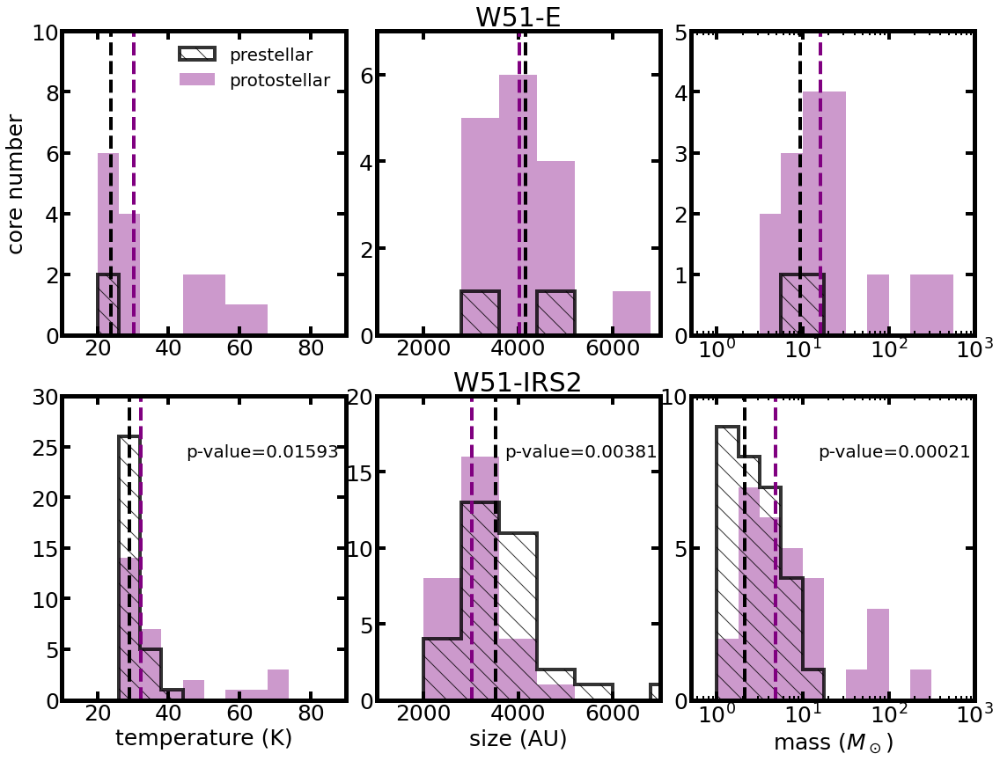

In [15]:
from scipy import stats
def flatten(xss):
    return [x for xs in xss for x in xs]
prestellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[3]
prestellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[3]
protostellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[4]
protostellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[4]



w51e_isincore_b3fov = np.zeros(len(yso_xsky_w51e),dtype=bool)
w51e_isincore_b3fov[flatten(multiplicity_w51e_b6crit_b3fov[2])]=True
catalog_w51e_yso['inincore_b3fov'] = w51e_isincore_b3fov

w51n_isincore_b3fov = np.zeros(len(yso_xsky_w51n),dtype=bool)
w51n_isincore_b3fov[flatten(multiplicity_w51n_b6crit_b3fov[2])]=True
catalog_w51n_yso['inincore_b3fov'] = w51n_isincore_b3fov
catalog_w51e_yso.write(Path.w51e_dendro_matched_catalog, format='fits', overwrite=True)
catalog_w51n_yso.write(Path.w51n_dendro_matched_catalog, format='fits', overwrite=True)

coretemp_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_temperature(Path.w51n_almaimf_coretemp)

coremass_w51e_b6crit_b3fov_prestellar = coremass_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov]
coremass_w51n_b6crit_b3fov_prestellar = coremass_w51n_b6crit_b3fov[prestellar_w51n_b6crit_b3fov]
coremass_w51e_b6crit_b3fov_protostellar = coremass_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov]
coremass_w51n_b6crit_b3fov_protostellar = coremass_w51n_b6crit_b3fov[protostellar_w51n_b6crit_b3fov]

coremass_err_w51e_b6crit_b3fov_prestellar = coremass_err_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov]
coremass_err_w51n_b6crit_b3fov_prestellar = coremass_err_w51n_b6crit_b3fov[prestellar_w51n_b6crit_b3fov]
coremass_err_w51e_b6crit_b3fov_protostellar = coremass_err_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov]
coremass_err_w51n_b6crit_b3fov_protostellar = coremass_err_w51n_b6crit_b3fov[protostellar_w51n_b6crit_b3fov]

coretemp_w51e_b6crit_b3fov_prestellar = coretemp_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov]
coretemp_w51n_b6crit_b3fov_prestellar = coretemp_w51n_b6crit_b3fov[prestellar_w51n_b6crit_b3fov]
coretemp_w51e_b6crit_b3fov_protostellar = coretemp_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov]
coretemp_w51n_b6crit_b3fov_protostellar = coretemp_w51n_b6crit_b3fov[protostellar_w51n_b6crit_b3fov]

coresize_w51e_b6crit_b3fov_prestellar = core_catdata_w51e_b6_b6crit_b3fov.size[prestellar_w51e_b6crit_b3fov]*5410
coresize_w51n_b6crit_b3fov_prestellar = core_catdata_w51n_b6_b6crit_b3fov.size[prestellar_w51n_b6crit_b3fov]*5100
coresize_w51e_b6crit_b3fov_protostellar = core_catdata_w51e_b6_b6crit_b3fov.size[protostellar_w51e_b6crit_b3fov]*5410
coresize_w51n_b6crit_b3fov_protostellar = core_catdata_w51n_b6_b6crit_b3fov.size[protostellar_w51n_b6crit_b3fov]*5100
print(len(coresize_w51n_b6crit_b3fov_protostellar))
print(len(coresize_w51n_b6crit_b3fov_prestellar))
print(len(coresize_w51e_b6crit_b3fov_protostellar))
print(len(coresize_w51e_b6crit_b3fov_prestellar))




fig = plt.figure(figsize=(16,12))

ax1 = fig.add_axes([0.08,0.07,0.28,0.4])
ax2 = fig.add_axes([0.39,0.07,0.28,0.4])
ax3 = fig.add_axes([0.7,0.07,0.28,0.4])
ax4 = fig.add_axes([0.08,0.55,0.28,0.4])
ax5 = fig.add_axes([0.39,0.55,0.28,0.4])
ax6 = fig.add_axes([0.7,0.55,0.28,0.4])

fluxbins=np.logspace(-0.5,1,num=11)

massbins=np.logspace(0,3,num=13)
sizebins=np.linspace(2000,10000,num=11)
tempbins=np.linspace(20,80,num=11)

ax3.hist(coremass_w51n_b6crit_b3fov_prestellar.value,bins=massbins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax3.hist(coremass_w51n_b6crit_b3fov_protostellar.value,bins=massbins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax2.hist(coresize_w51n_b6crit_b3fov_prestellar,bins=sizebins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax2.hist(coresize_w51n_b6crit_b3fov_protostellar,bins=sizebins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax1.hist(coretemp_w51n_b6crit_b3fov_prestellar,bins=tempbins, alpha=0.8,histtype='step', facecolor='none', color='k',  hatch='\\',label='prestellar',lw=4)
ax1.hist(coretemp_w51n_b6crit_b3fov_protostellar,bins=tempbins, alpha=0.4, color='purple', label='protostellar',lw=4)

ax4.hist(coretemp_w51e_b6crit_b3fov_prestellar ,bins=tempbins, alpha=0.8,histtype='step', facecolor='none', color='k',  hatch='\\',label='prestellar',lw=4)
ax4.hist(coretemp_w51e_b6crit_b3fov_protostellar,bins=tempbins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax5.hist(coresize_w51e_b6crit_b3fov_prestellar,bins=sizebins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax5.hist(coresize_w51e_b6crit_b3fov_protostellar,bins=sizebins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax6.hist(coremass_w51e_b6crit_b3fov_prestellar.value,bins=massbins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax6.hist(coremass_w51e_b6crit_b3fov_protostellar.value,bins=massbins, alpha=0.4, color='purple', label='protostellar',lw=4)

ax1.vlines(np.nanmedian(coretemp_w51n_b6crit_b3fov_prestellar), 0, 30, color='k', linestyle='dashed', lw=4)
ax1.vlines(np.nanmedian(coretemp_w51n_b6crit_b3fov_protostellar), 0, 30, color='purple', linestyle='dashed', lw=4)
ax2.vlines(np.nanmedian(coresize_w51n_b6crit_b3fov_prestellar), 0, 20, color='k', linestyle='dashed', lw=4)
ax2.vlines(np.nanmedian(coresize_w51n_b6crit_b3fov_protostellar), 0, 20, color='purple', linestyle='dashed', lw=4)
ax3.vlines(np.nanmedian(coremass_w51n_b6crit_b3fov_prestellar.value), 0, 10, color='k', linestyle='dashed', lw=4)
ax3.vlines(np.nanmedian(coremass_w51n_b6crit_b3fov_protostellar.value), 0, 10, color='purple', linestyle='dashed', lw=4)
ax4.vlines(np.nanmedian(coretemp_w51e_b6crit_b3fov_prestellar), 0, 10, color='k', linestyle='dashed', lw=4)
ax4.vlines(np.nanmedian(coretemp_w51e_b6crit_b3fov_protostellar), 0, 10, color='purple', linestyle='dashed', lw=4)
ax5.vlines(np.nanmedian(coresize_w51e_b6crit_b3fov_prestellar), 0, 7, color='k', linestyle='dashed', lw=4)
ax5.vlines(np.nanmedian(coresize_w51e_b6crit_b3fov_protostellar), 0, 7, color='purple', linestyle='dashed', lw=4)
ax6.vlines(np.nanmedian(coremass_w51e_b6crit_b3fov_prestellar.value), 0, 5, color='k', linestyle='dashed', lw=4)
ax6.vlines(np.nanmedian(coremass_w51e_b6crit_b3fov_protostellar.value), 0, 5, color='purple', linestyle='dashed', lw=4)
print(stats.ks_2samp(coretemp_w51n_b6crit_b3fov_prestellar, coretemp_w51n_b6crit_b3fov_protostellar).pvalue,
      stats.ks_2samp(coresize_w51n_b6crit_b3fov_prestellar, coresize_w51n_b6crit_b3fov_protostellar).pvalue,
      stats.ks_2samp(coresize_w51n_b6crit_b3fov_prestellar.value, coresize_w51n_b6crit_b3fov_protostellar.value).pvalue)
ax1.text(45, 24, 'p-value=%6.5f'%stats.ks_2samp(coretemp_w51n_b6crit_b3fov_prestellar, coretemp_w51n_b6crit_b3fov_protostellar).pvalue,fontsize=20)
ax2.text(3700, 16, 'p-value=%6.5f'%stats.ks_2samp(coresize_w51n_b6crit_b3fov_prestellar, coresize_w51n_b6crit_b3fov_protostellar).pvalue,fontsize=20)
ax3.text(15,8, 'p-value=%6.5f'%stats.ks_2samp(coremass_w51n_b6crit_b3fov_prestellar.value, coremass_w51n_b6crit_b3fov_protostellar.value).pvalue,fontsize=20)


ax2.set_xlabel('size (AU)')
ax1.set_xlabel('temperature (K)')
ax3.set_xlabel(r'mass $(M_\odot)$')

ax4.set_ylabel('core number')
ax2.set_title('W51-IRS2',fontsize=30)
ax5.set_title('W51-E',fontsize=30)

ax3.set_xscale('log')
ax6.set_xscale('log')
ax3.set_xticks([1e0,1e1,1e2,1e3])
ax6.set_xticks([1e0,1e1,1e2,1e3])

ax4.legend(fontsize=20, frameon=False)
ax1.set_xlim(10,90)
ax4.set_xlim(10,90)
ax2.set_xlim(1000,7000)
ax5.set_xlim(1000,7000)
ax3.set_xlim(0.5, 1000)
ax6.set_xlim(0.5, 1000)
ax1.set_ylim(0,30)
ax2.set_ylim(0,20)
ax3.set_ylim(0,10)
ax4.set_ylim(0,10)
ax5.set_ylim(0,7)
ax6.set_ylim(0,5)
ax3.set_yticks([0,5,10])
plt.savefig('prestellar_protostellar.png')

29
32
16
2
0.015927837711071313 0.0038131054645116347 0.0038131054645116347 7.323359657585016e-07
[3.53346573 3.06546176 3.30664533 2.81911917 2.76065337 2.862136
 2.42168585 1.0746125  3.18235483 2.81034942 2.61370636 1.33909965]


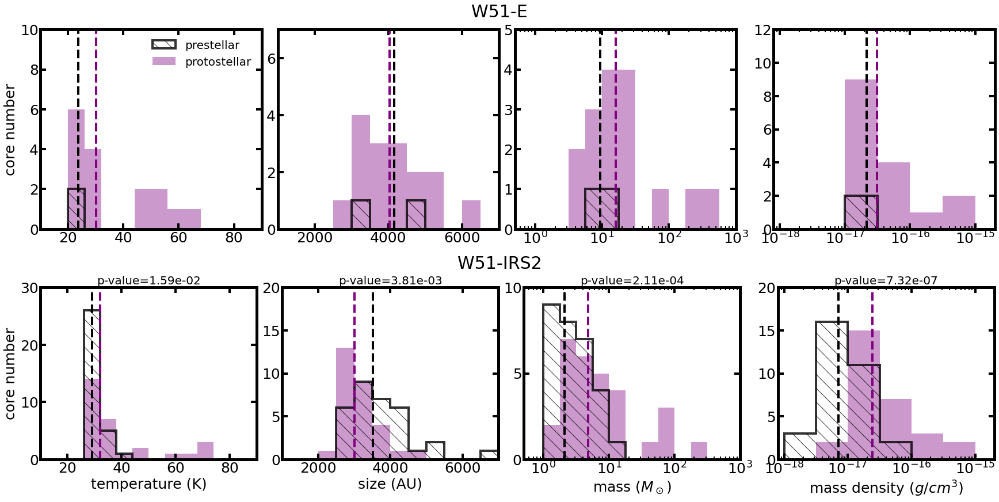

In [16]:
from scipy import stats
def flatten(xss):
    return [x for xs in xss for x in xs]
prestellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[3]
prestellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[3]
protostellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[4]
protostellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[4]

w51e_isincore_b3fov = np.zeros(len(yso_xsky_w51e),dtype=bool)
w51e_isincore_b3fov[flatten(multiplicity_w51e_b6crit_b3fov[2])]=True
catalog_w51e_yso['inincore_b3fov'] = w51e_isincore_b3fov

w51n_isincore_b3fov = np.zeros(len(yso_xsky_w51n),dtype=bool)
w51n_isincore_b3fov[flatten(multiplicity_w51n_b6crit_b3fov[2])]=True
catalog_w51n_yso['inincore_b3fov'] = w51n_isincore_b3fov
catalog_w51e_yso.write(Path.w51e_dendro_matched_catalog, format='fits', overwrite=True)
catalog_w51n_yso.write(Path.w51n_dendro_matched_catalog, format='fits', overwrite=True)

coretemp_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.get_temperature(Path.w51n_almaimf_coretemp)

coremass_w51e_b6crit_b3fov_prestellar = coremass_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov]
coremass_w51n_b6crit_b3fov_prestellar = coremass_w51n_b6crit_b3fov[prestellar_w51n_b6crit_b3fov]
coremass_w51e_b6crit_b3fov_protostellar = coremass_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov]
coremass_w51n_b6crit_b3fov_protostellar = coremass_w51n_b6crit_b3fov[protostellar_w51n_b6crit_b3fov]

coremass_err_w51e_b6crit_b3fov_prestellar = coremass_err_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov]
coremass_err_w51n_b6crit_b3fov_prestellar = coremass_err_w51n_b6crit_b3fov[prestellar_w51n_b6crit_b3fov]
coremass_err_w51e_b6crit_b3fov_protostellar = coremass_err_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov]
coremass_err_w51n_b6crit_b3fov_protostellar = coremass_err_w51n_b6crit_b3fov[protostellar_w51n_b6crit_b3fov]

coretemp_w51e_b6crit_b3fov_prestellar = coretemp_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov]
coretemp_w51n_b6crit_b3fov_prestellar = coretemp_w51n_b6crit_b3fov[prestellar_w51n_b6crit_b3fov]
coretemp_w51e_b6crit_b3fov_protostellar = coretemp_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov]
coretemp_w51n_b6crit_b3fov_protostellar = coretemp_w51n_b6crit_b3fov[protostellar_w51n_b6crit_b3fov]


coresize_w51e_b6crit_b3fov_prestellar = core_catdata_w51e_b6_b6crit_b3fov.size[prestellar_w51e_b6crit_b3fov]*5410
coresize_w51n_b6crit_b3fov_prestellar = core_catdata_w51n_b6_b6crit_b3fov.size[prestellar_w51n_b6crit_b3fov]*5100
coresize_w51e_b6crit_b3fov_protostellar = core_catdata_w51e_b6_b6crit_b3fov.size[protostellar_w51e_b6crit_b3fov]*5410
coresize_w51n_b6crit_b3fov_protostellar = core_catdata_w51n_b6_b6crit_b3fov.size[protostellar_w51n_b6crit_b3fov]*5100

coredensity_w51e_b6crit_b3fov_prestellar = coremass_w51e_b6crit_b3fov_prestellar.value * 1.989e33 / (4*np.pi/3*coresize_w51e_b6crit_b3fov_prestellar**3) /(1.496e13)**3
coredensity_w51n_b6crit_b3fov_prestellar = coremass_w51n_b6crit_b3fov_prestellar.value * 1.989e33 / (4*np.pi/3*coresize_w51n_b6crit_b3fov_prestellar**3) /(1.496e13)**3
coredensity_w51e_b6crit_b3fov_protostellar = coremass_w51e_b6crit_b3fov_protostellar.value * 1.989e33 / (4*np.pi/3*coresize_w51e_b6crit_b3fov_protostellar**3) /(1.496e13)**3
coredensity_w51n_b6crit_b3fov_protostellar = coremass_w51n_b6crit_b3fov_protostellar.value * 1.989e33 / (4*np.pi/3*coresize_w51n_b6crit_b3fov_protostellar**3) /(1.496e13)**3

print(len(coresize_w51n_b6crit_b3fov_protostellar))
print(len(coresize_w51n_b6crit_b3fov_prestellar))
print(len(coresize_w51e_b6crit_b3fov_protostellar))
print(len(coresize_w51e_b6crit_b3fov_prestellar))


fig = plt.figure(figsize=(24,12),layout='constrained')
subfigs = fig.subfigures(2,1)
subfigs[1].suptitle('W51-IRS2',fontsize=30)
subfigs[0].suptitle('W51-E',fontsize=30)
axesrow1 = subfigs[0].subplots(nrows=1, ncols=4)
ax4 = axesrow1[0]
ax5 = axesrow1[1]
ax6 = axesrow1[2]
ax8 = axesrow1[3]
axesrow2 = subfigs[1].subplots(nrows=1, ncols=4)
ax1 = axesrow2[0]
ax2 = axesrow2[1]
ax3 = axesrow2[2]
ax7 = axesrow2[3]
        

"""
ax4 = subfigs[0].add_axes([0.05,0.08,0.2,0.4])
ax5 = subfigs[0].add_axes([0.29,0.08,0.2,0.4])
ax6 = subfigs[0].add_axes([0.53,0.08,0.2,0.4])
ax8 = subfigs[0].add_axes([0.77,0.08,0.2,0.4])

ax1 = subfigs[1].add_axes([0.05,0.56,0.2,0.4])
ax2 = subfigs[1].add_axes([0.29,0.56,0.2,0.4])
ax3 = subfigs[1].add_axes([0.53,0.56,0.2,0.4])
ax7 = subfigs[1].add_axes([0.77,0.56,0.2,0.4])
"""
fluxbins=np.logspace(-0.5,1,num=11)

massbins=np.logspace(0,3,num=13)
sizebins=np.linspace(2000,10000,num=17)
tempbins=np.linspace(20,80,num=11)
denbins = np.logspace(-19,-14,num=11)

ax7.hist(coredensity_w51n_b6crit_b3fov_prestellar,bins=denbins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax7.hist(coredensity_w51n_b6crit_b3fov_protostellar,bins=denbins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax3.hist(coremass_w51n_b6crit_b3fov_prestellar.value,bins=massbins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax3.hist(coremass_w51n_b6crit_b3fov_protostellar.value,bins=massbins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax2.hist(coresize_w51n_b6crit_b3fov_prestellar,bins=sizebins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax2.hist(coresize_w51n_b6crit_b3fov_protostellar,bins=sizebins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax1.hist(coretemp_w51n_b6crit_b3fov_prestellar,bins=tempbins, alpha=0.8,histtype='step', facecolor='none', color='k',  hatch='\\',label='prestellar',lw=4)
ax1.hist(coretemp_w51n_b6crit_b3fov_protostellar,bins=tempbins, alpha=0.4, color='purple', label='protostellar',lw=4)

ax4.hist(coretemp_w51e_b6crit_b3fov_prestellar ,bins=tempbins, alpha=0.8,histtype='step', facecolor='none', color='k',  hatch='\\',label='prestellar',lw=4)
ax4.hist(coretemp_w51e_b6crit_b3fov_protostellar,bins=tempbins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax5.hist(coresize_w51e_b6crit_b3fov_prestellar,bins=sizebins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax5.hist(coresize_w51e_b6crit_b3fov_protostellar,bins=sizebins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax6.hist(coremass_w51e_b6crit_b3fov_prestellar.value,bins=massbins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax6.hist(coremass_w51e_b6crit_b3fov_protostellar.value,bins=massbins, alpha=0.4, color='purple', label='protostellar',lw=4)
ax8.hist(coredensity_w51e_b6crit_b3fov_prestellar,bins=denbins, alpha=0.8,histtype='step', facecolor='none', color='k', hatch='\\',label='prestellar',lw=4)
ax8.hist(coredensity_w51e_b6crit_b3fov_protostellar,bins=denbins, alpha=0.4, color='purple', label='protostellar',lw=4)



ax1.vlines(np.nanmedian(coretemp_w51n_b6crit_b3fov_prestellar), 0, 30, color='k', linestyle='dashed', lw=4)
ax1.vlines(np.nanmedian(coretemp_w51n_b6crit_b3fov_protostellar), 0, 30, color='purple', linestyle='dashed', lw=4)
ax2.vlines(np.nanmedian(coresize_w51n_b6crit_b3fov_prestellar), 0, 20, color='k', linestyle='dashed', lw=4)
ax2.vlines(np.nanmedian(coresize_w51n_b6crit_b3fov_protostellar), 0, 20, color='purple', linestyle='dashed', lw=4)
ax3.vlines(np.nanmedian(coremass_w51n_b6crit_b3fov_prestellar.value), 0, 10, color='k', linestyle='dashed', lw=4)
ax3.vlines(np.nanmedian(coremass_w51n_b6crit_b3fov_protostellar.value), 0, 10, color='purple', linestyle='dashed', lw=4)
ax4.vlines(np.nanmedian(coretemp_w51e_b6crit_b3fov_prestellar), 0, 10, color='k', linestyle='dashed', lw=4)
ax4.vlines(np.nanmedian(coretemp_w51e_b6crit_b3fov_protostellar), 0, 10, color='purple', linestyle='dashed', lw=4)
ax5.vlines(np.nanmedian(coresize_w51e_b6crit_b3fov_prestellar), 0, 7, color='k', linestyle='dashed', lw=4)
ax5.vlines(np.nanmedian(coresize_w51e_b6crit_b3fov_protostellar), 0, 7, color='purple', linestyle='dashed', lw=4)
ax6.vlines(np.nanmedian(coremass_w51e_b6crit_b3fov_prestellar.value), 0, 5, color='k', linestyle='dashed', lw=4)
ax6.vlines(np.nanmedian(coremass_w51e_b6crit_b3fov_protostellar.value), 0, 5, color='purple', linestyle='dashed', lw=4)
ax7.vlines(np.nanmedian(coredensity_w51n_b6crit_b3fov_prestellar), 0, 20, color='k', linestyle='dashed', lw=4)
ax7.vlines(np.nanmedian(coredensity_w51n_b6crit_b3fov_protostellar), 0, 20, color='purple', linestyle='dashed', lw=4)
ax8.vlines(np.nanmedian(coredensity_w51e_b6crit_b3fov_prestellar), 0, 12, color='k', linestyle='dashed', lw=4)
ax8.vlines(np.nanmedian(coredensity_w51e_b6crit_b3fov_protostellar), 0, 12, color='purple', linestyle='dashed', lw=4)

print(stats.ks_2samp(coretemp_w51n_b6crit_b3fov_prestellar, coretemp_w51n_b6crit_b3fov_protostellar).pvalue,
      stats.ks_2samp(coresize_w51n_b6crit_b3fov_prestellar, coresize_w51n_b6crit_b3fov_protostellar).pvalue,
      stats.ks_2samp(coresize_w51n_b6crit_b3fov_prestellar.value, coresize_w51n_b6crit_b3fov_protostellar.value).pvalue,
      stats.ks_2samp(coredensity_w51n_b6crit_b3fov_prestellar, coredensity_w51n_b6crit_b3fov_protostellar).pvalue)
ax1.set_title('p-value=%3.2e'%stats.ks_2samp(coretemp_w51n_b6crit_b3fov_prestellar, coretemp_w51n_b6crit_b3fov_protostellar).pvalue,fontsize=20)
ax2.set_title('p-value=%3.2e'%stats.ks_2samp(coresize_w51n_b6crit_b3fov_prestellar, coresize_w51n_b6crit_b3fov_protostellar).pvalue,fontsize=20)
ax3.set_title('p-value=%3.2e'%stats.ks_2samp(coremass_w51n_b6crit_b3fov_prestellar.value, coremass_w51n_b6crit_b3fov_protostellar.value).pvalue,fontsize=20)
ax7.set_title('p-value=%3.2e'%stats.ks_2samp(coredensity_w51n_b6crit_b3fov_prestellar, coredensity_w51n_b6crit_b3fov_protostellar).pvalue,fontsize=20)
print(coremass_w51n_b6crit_b3fov_protostellar.value[np.where(coremass_w51n_b6crit_b3fov_protostellar.value<3.83)[0]])
ax2.set_xlabel('size (AU)')
ax1.set_xlabel('temperature (K)')
ax3.set_xlabel(r'mass $(M_\odot)$')
ax7.set_xlabel('mass density ($g/cm^3$)')
ax4.set_ylabel('core number')
ax1.set_ylabel('core number')
#ax2.set_title('W51-IRS2',fontsize=30)
#ax5.set_title('W51-E',fontsize=30)

ax3.set_xscale('log')
ax6.set_xscale('log')
ax3.set_xticks([1e0,1e1,1e2,1e3])
ax6.set_xticks([1e0,1e1,1e2,1e3])

ax4.legend(fontsize=20, frameon=False)
ax1.set_xlim(10,90)
ax4.set_xlim(10,90)
ax2.set_xlim(1000,7000)
ax5.set_xlim(1000,7000)
ax3.set_xlim(0.5, 1000)
ax6.set_xlim(0.5, 1000)
ax1.set_ylim(0,30)
ax2.set_ylim(0,20)
ax3.set_ylim(0,10)
ax4.set_ylim(0,10)
ax5.set_ylim(0,7)
ax6.set_ylim(0,5)
ax7.set_xlim(8e-19,2e-15)
ax8.set_xlim(8e-19,2e-15)
ax8.set_ylim(0,12)
ax7.set_ylim(0,20)

ax7.set_xscale('log')
ax8.set_xscale('log')
ax3.set_yticks([0,5,10])
plt.savefig('proto_vs_pre.png')

In [17]:
no_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.no[multiplicity_w51e_b6crit_b3fov[1]]
no_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.no[multiplicity_w51n_b6crit_b3fov[1]]

[8, 12, 14, 17, 18, 19, 21, 23, 26, 27, 28, 29, 33, 35, 41, 42, 43, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60]
[0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 13, 15, 16, 20, 22, 24, 25, 30, 31, 32, 34, 36, 37, 38, 39, 40, 44, 54]
61


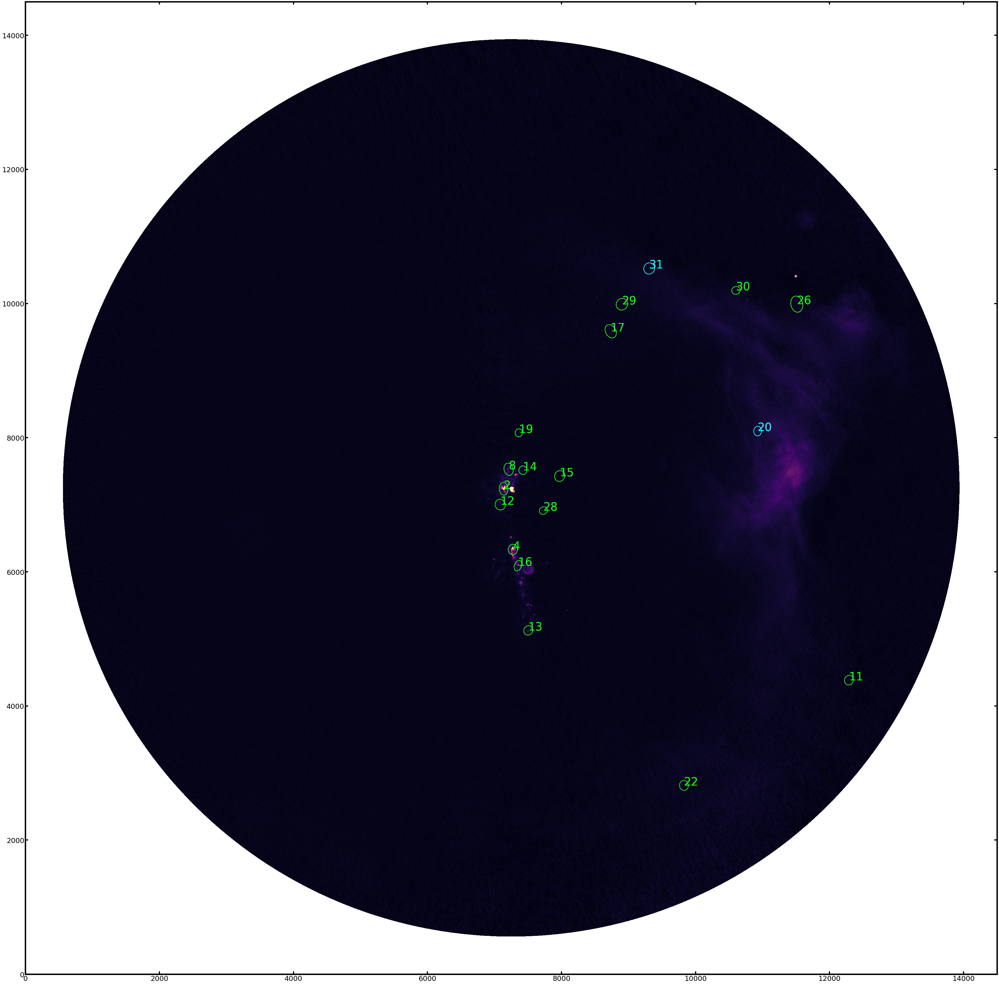

In [18]:
print(prestellar_w51n_b6crit_b3fov)
print(protostellar_w51n_b6crit_b3fov)
print(len(core_catdata_w51n_b6_b6crit_b3fov.sky_ra))

from matplotlib.patches import Rectangle, Ellipse

def plot_cores(ax, skypos, afwhm, bfwhm, theta, hdrhr, beam_almaimf,color='cyan', lw=2, label=None,fontsize=40):
    wcsNB = WCS(hdrhr,naxis=2)
    scalehr = wcsNB.proj_plane_pixel_scales()[0]
    xypos = wcsNB.wcs_world2pix(skypos,0)

    for i in range(len(xypos)):
        meanbeamsize = (beam_almaimf.major.value+beam_almaimf.minor.value)/4
        major = (afwhm[i]/3600+meanbeamsize)/scalehr.value
        minor = (bfwhm[i]/3600+meanbeamsize)/scalehr.value
        pa = 90+theta[i]
        ellipse = Ellipse(xypos[i],width=major,height=minor,facecolor='none',
                          angle=180-pa,edgecolor=color,lw=lw) 
        ax.add_patch(ellipse)
        if label is not None:
            if isinstance(label[i],u.Quantity):
                ax.text(xypos[i][0],xypos[i][1],'%3.2f'%label[i].value,color=color,fontsize=8) 
            else:
                ax.text(xypos[i][0],xypos[i][1],label[i],color=color,fontsize=fontsize)


fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.imshow(image_b3_w51e, cmap='inferno',origin='lower', vmin=-0.000103489713773963128,vmax=0.002216252472302186)

skypos_w51e_b6_b6crit_b3fov = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra, core_catdata_w51e_b6_b6crit_b3fov.sky_dec)).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov, core_catdata_w51e_b6_b6crit_b3fov.afwhm, core_catdata_w51e_b6_b6crit_b3fov.bfwhm, core_catdata_w51e_b6_b6crit_b3fov.theta, 
           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='w', lw=2, label=no_w51e_b6crit_b3fov)

skypos_w51e_b6_b6crit_b3fov_prestellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.sky_dec[prestellar_w51e_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], 
           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='cyan', lw=2, label=no_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov])

skypos_w51e_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.sky_dec[protostellar_w51e_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_protostellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[protostellar_w51e_b6crit_b3fov], 
           hdrB3_w51e_hr, beamb6_w51e_almaimf, color='lime', lw=2, label=no_w51e_b6crit_b3fov[protostellar_w51e_b6crit_b3fov])
plt.savefig('core_no_w51e_b3.png')


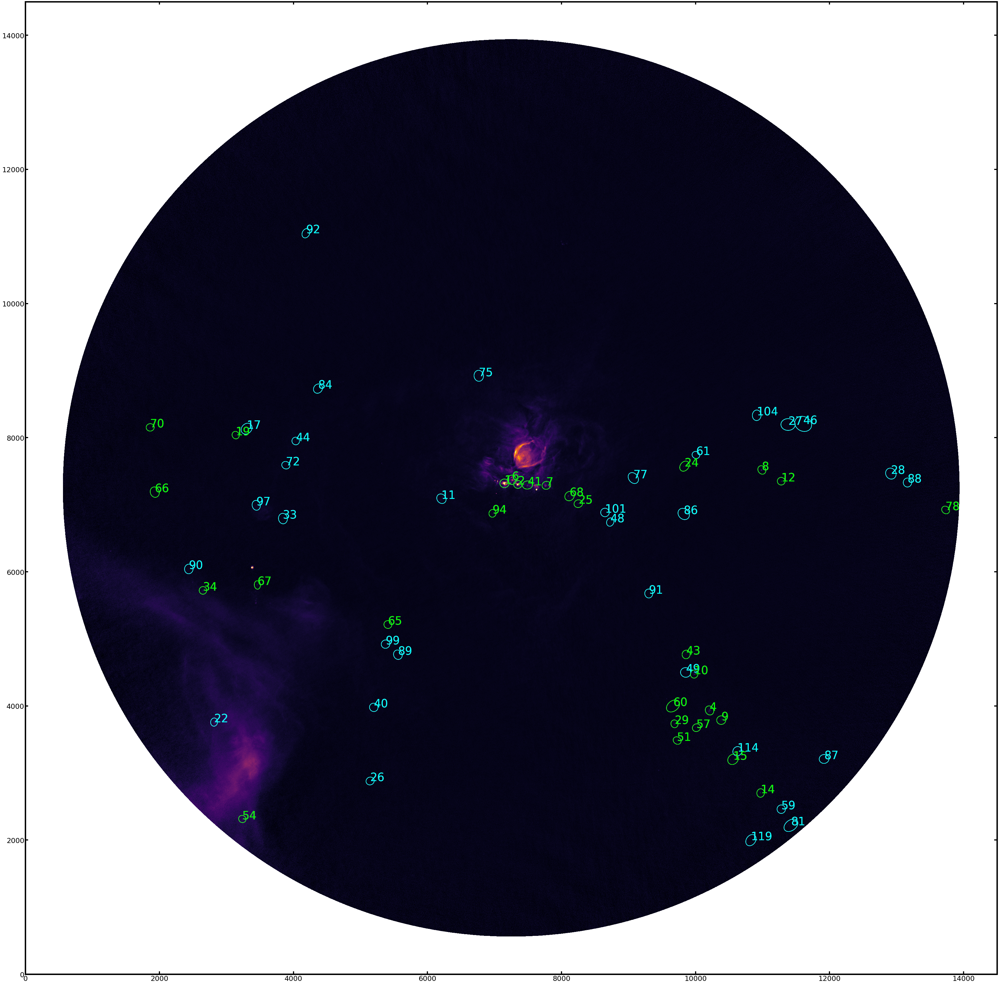

In [19]:
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.imshow(image_b3_w51n, cmap='inferno',origin='lower', vmin=-0.000103489713773963128,vmax=0.002216252472302186)
 
skypos_w51n_b6_b6crit_b3fov = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra, core_catdata_w51n_b6_b6crit_b3fov.sky_dec)).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov, core_catdata_w51n_b6_b6crit_b3fov.afwhm, core_catdata_w51n_b6_b6crit_b3fov.bfwhm, core_catdata_w51n_b6_b6crit_b3fov.theta, 
           hdrB3_w51n_hr, beamb6_w51n_almaimf, color='w', lw=2, label=no_w51n_b6crit_b3fov)

skypos_w51n_b6_b6crit_b3fov_prestellar = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.sky_dec[prestellar_w51n_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_prestellar, core_catdata_w51n_b6_b6crit_b3fov.afwhm[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.bfwhm[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.theta[prestellar_w51n_b6crit_b3fov], 
           hdrB3_w51n_hr, beamb6_w51n_almaimf, color='cyan', lw=2, label=no_w51n_b6crit_b3fov[prestellar_w51n_b6crit_b3fov])

skypos_w51n_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.sky_dec[protostellar_w51n_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_protostellar, core_catdata_w51n_b6_b6crit_b3fov.afwhm[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.bfwhm[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.theta[protostellar_w51n_b6crit_b3fov], 
           hdrB3_w51n_hr, beamb6_w51n_almaimf, color='lime', lw=2, label=no_w51n_b6crit_b3fov[protostellar_w51n_b6crit_b3fov])
plt.savefig('core_no_w51n_b3.png')

BootstrapResult(confidence_interval=ConfidenceInterval(low=-0.8555384606498503, high=0.1099275653262626), standard_error=0.26578756114294905)
BootstrapResult(confidence_interval=ConfidenceInterval(low=-0.7635409930017333, high=-0.12456186307075699), standard_error=0.18894124313174002)
BootstrapResult(confidence_interval=ConfidenceInterval(low=2.288964725354359e-06, high=0.7167247107186415), standard_error=0.22789878344115352)
BootstrapResult(confidence_interval=ConfidenceInterval(low=1.138828208297295e-05, high=0.3902323912089263), standard_error=0.14815573181016967)


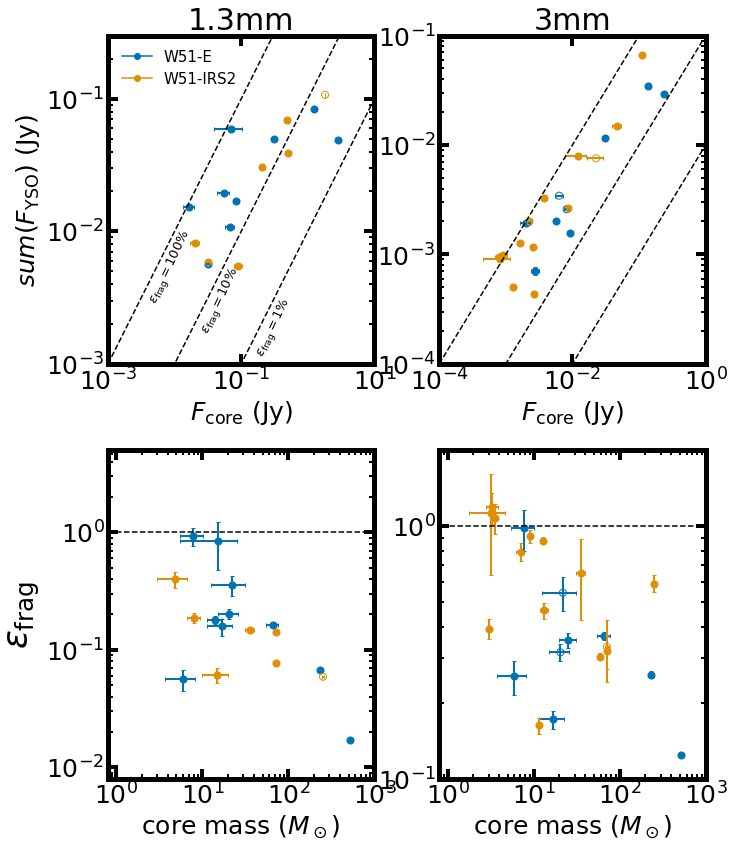

In [20]:
from matplotlib.lines import Line2D
from scipy.stats import pearsonr, bootstrap, spearmanr

def plot_core_to_yso(ax, coredats, ysodats,coredats_err,ysodats_err, coremass, coremasserr, grouparr=None, color='c'):
    epsilonset = []
    coremassset=[]
    indexset=[]
    epsilonerrset = []
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            finiteind = np.isfinite(ysodats[i])
            if any(np.isfinite(ysodats[i])):
                #yerrset = add_asym.add_asym(ysodats[i][finiteind], ysodats[i][finiteind]-ysodats_err_low[i][finiteind], ysodats_err_high[i][finiteind]-ysodats[i][finiteind], order=1)

                epsilon = np.nansum(ysodats[i])/coredat
                sumerr = np.linalg.norm(ysodats_err[i][finiteind])
                epsilonerr = epsilon * np.sqrt((sumerr/np.nansum(ysodats[i]))**2+(coredats_err[i]/coredat)**2)
                #epsilonset.append(yerrset[0]/coredat)
                coremassset.append(coremass[i].value)
                epsilonset.append(epsilon)
                epsilonerrset.append(epsilonerr)
              
                indexset.append(i)
                """
                if any(~np.isfinite(ysodats[i])):            
                   #ax.scatter(coremass[i], yerrset[0]/coredat,color=color, marker='o', facecolor='none',s=50)
                else:
                    #ax.scatter(coremass[i], yerrset[0]/coredat,color=color,s=50) 
                """
                if grouparr is None:
                    marker='o'
                else:
                    if grouparr[i]==0:
                        marker='o'
                    elif grouparr[i]==1:
                        marker='^'
                    elif grouparr[i]==2:
                        marker='x'
                if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                    #ax.plot(coremass[i]*np.ones(len(ysodat_sort_finite)-1), ysodat_sort_finite[:-1]/np.nanmax(ysodats[i]), color='gray', mfc=color,ls='dashed',marker='o', markersize=10)
                    ax.scatter(coremass[i], epsilon, color=color,s=50, marker=marker, facecolor='none')
                    ax.errorbar(coremass[i], epsilon, 
                                xerr=coremasserr[i], 
                                yerr=epsilonerr,
                                #yerr=np.array(list(zip(ysodats_err_low_sort_finite[:-1], ysodats_err_upp_sort_finite[:-1]))).T,
                                capsize=2.0, elinewidth=2, ecolor=color,fmt='none')
                            
                else:
                    ax.scatter(coremass[i], epsilon, color=color,s=50, marker=marker)

                    #ax.plot(coremass[i]*np.ones(len(ysodat_sort_finite)-1), ysodat_sort_finite[:-1]/np.nanmax(ysodats[i]), color='gray',markeredgecolor=color, mfc='none',ls='dashed',marker='o', markersize=10)
                    ax.errorbar(coremass[i], epsilon, 
                                xerr=coremasserr[i], 
                                yerr=epsilonerr,
                                #yerr=np.array(list(zip(ysodats_err_low_sort_finite[:-1], ysodats_err_upp_sort_finite[:-1]))).T,
                                capsize=2.0, elinewidth=2, ecolor=color,fmt='none')
                    
        
    
    #ax.errorbar(coremass[indexset], epsilonset,xerr=coremasserr[indexset],
    #        linestyle='',capsize=2.0, elinewidth=2, ecolor=color)
    
  
    return coremassset, epsilonset


   

def plot_eps_coremass(ax, epsdir, ysodats, coredat, coremass, coremasserr, grouparr=None, color='k'):
    idxarr=[]
    epsilonset = []
    coremassset=[]
    eps_med = np.loadtxt(epsdir+'_eps_med.dat')
    eps_low = np.loadtxt(epsdir+'_eps_low.dat')
    eps_upp = np.loadtxt(epsdir+'_eps_upp.dat')
    j=0
    for i,ysodat in enumerate(ysodats):
        if len(ysodat)>0:
            if any(np.isfinite(ysodats[i])):
                finiteind = np.isfinite(ysodats[i])

                print(i, eps_med[j], np.sum(ysodats[i][finiteind])/coredat[i])
                epsilonset.append(eps_med[j])
                coremassset.append(coremass[i].value)
                idxarr.append(i)
                j=j+1
        
    ax.errorbar(coremass[idxarr], eps_med,xerr=coremasserr[idxarr],
                yerr=np.array(list(zip(eps_med - eps_low, 
                                                eps_upp -eps_med))).T,
            linestyle='',capsize=2.0, elinewidth=2, ecolor=color, fmt='o')
    if grouparr is not None:
        markers = []
        for i in range(len(idxarr)):
            if len(ysodat)>0:
                if any(np.isfinite(ysodats[i])):
                    if grouparr[i]==0:
                        markers.append('o')
                    elif grouparr[i]==1:
                        markers.append('^')
                    elif grouparr[i]==2:
                        markers.append('x')
        ax.scatter(coremass[idxarr], eps_med,color=color,s=50, marker=markers, facecolor='none')

    else:        
        ax.scatter(coremass[idxarr], eps_med,color=color,s=50, marker='o', facecolor='none')

    
    return coremassset, epsilonset
    
def pearson_for_bootstrap1(x, y):
    a = pearsonr(x, y)[0]
    return a
def pearson_for_bootstrap2(x, y):
    a = pearsonr(x, y)[1]
    return a 

def spearman_for_bootstrap1(x, y):
    a = spearmanr(x, y, nan_policy='omit')[0]
    return a
def spearman_for_bootstrap2(x, y):
    a = spearmanr(x, y, nan_policy='omit')[1]
    return a                
fig = plt.figure(figsize=(10,12))
ax3 = fig.add_axes([0.14,0.1,0.37,0.38])
ax4 = fig.add_axes([0.6,0.1,0.37,0.38])

#ax3 = fig.add_axes([0.1,0.41,0.38,0.25])
#ax4 = fig.add_axes([0.58,0.41,0.38,0.25])

ax1 = fig.add_axes([0.14,0.58,0.37,0.38])
ax2 = fig.add_axes([0.6,0.58,0.37,0.38])


plot_core_yso_sum_frags(ax1, coreflux_w51e_b6_b6crit_b6fov, ysoflux_w51e_b6_b6crit_b6fov, corefluxerr_w51e_b6_b6crit_b6fov,  ysoflux_err_w51e_b6_b6crit_b6fov,color=cmap[0])
plot_core_yso_sum_frags(ax2, coreflux_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov, corefluxerr_w51e_b3_b6b3crit_b3fov,  ysoflux_err_w51e_b3_b6b3crit_b3fov  ,color=cmap[0])
plot_core_yso_sum_frags(ax1, coreflux_w51n_b6_b6crit_b6fov, ysoflux_w51n_b6_b6crit_b6fov, corefluxerr_w51n_b6_b6crit_b6fov,  ysoflux_err_w51n_b6_b6crit_b6fov  ,color=cmap[1])
plot_core_yso_sum_frags(ax2, coreflux_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov, corefluxerr_w51n_b3_b6b3crit_b3fov,  ysoflux_err_w51n_b3_b6b3crit_b3fov   , color=cmap[1])
#coremass_w51e_b6, eps_w51e_b6 = plot_core_to_yso(ax3, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff, corefluxerr_w51e_b6_woff,  ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff, coremass_w51e_b6_woff, coremasserr_w51e_b6_woff,color=cmap[0])
#coremass_w51e_b3, eps_w51e_b3 = plot_core_to_yso(ax4, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff, corefluxerr_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff, coremass_w51e_b3_woff ,coremasserr_w51e_b3_woff,color=cmap[0])
#coremass_w51n_b6, eps_w51n_b6 = plot_core_to_yso(ax3, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff, corefluxerr_w51n_b6_woff,  ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff,  coremass_w51n_b6_woff,coremasserr_w51n_b6_woff,color=cmap[1])
#coremass_w51n_b3, eps_w51n_b3 = plot_core_to_yso(ax4, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff, corefluxerr_w51n_b3_woff,  ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff, coremass_w51n_b3_woff,coremasserr_w51n_b3_woff, 
#                        color=cmap[1])

#coremass_w51e_b6, eps_w51e_b6 = plot_eps_coremass(ax3, '/home/t.yoo/w51/catalogue/comparison_almaimf/w51e_b6', ysoflux_w51e_b6_b6crit_b3fov, coreflux_w51e_b6_b6crit_b3fov,coremass_w51e_b6fov_woff, coremasserr_w51e_b6fov_woff,color=cmap[0])
#coremass_w51e_b3, eps_w51e_b3 = plot_eps_coremass(ax4, '/home/t.yoo/w51/catalogue/comparison_almaimf/w51e_b3', ysoflux_w51e_b3_b3fov_woff, coreflux_w51e_b3_b3fov_woff,coremass_w51e_b3fov_woff, coremasserr_w51e_b3fov_woff,color=cmap[0])
#coremass_w51n_b6, eps_w51n_b6 = plot_eps_coremass(ax3, '/home/t.yoo/w51/catalogue/comparison_almaimf/w51n_b6', ysoflux_w51n_b6_b6fov_woff, coreflux_w51n_b6_b6fov_woff,coremass_w51n_b6fov_woff, coremasserr_w51n_b6fov_woff,color=cmap[1])
#coremass_w51n_b3, eps_w51n_b3 = plot_eps_coremass(ax4, '/home/t.yoo/w51/catalogue/comparison_almaimf/w51n_b3', ysoflux_w51n_b3_b6b3crit_b3fov, coreflux_w51n_b3_b6b3crit_b3fov,coremass_w51n_b6b3crit_b3fov, coremasserr_w51n_b6b3crit_b3fov,color=cmap[1])

coremass_w51e_b6, eps_w51e_b6 = plot_core_to_yso(ax3, coreflux_w51e_b6_b6crit_b6fov, ysoflux_w51e_b6_b6crit_b6fov, corefluxerr_w51e_b6_b6crit_b6fov,  ysoflux_err_w51e_b6_b6crit_b6fov, coremass_w51e_b6crit_b6fov, coremasserr_w51e_b6crit_b6fov,  color=cmap[0])
coremass_w51e_b3, eps_w51e_b3 = plot_core_to_yso(ax4,   coreflux_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov, corefluxerr_w51e_b3_b6b3crit_b3fov,  ysoflux_err_w51e_b3_b6b3crit_b3fov ,coremass_w51e_b6b3crit_b3fov, coremasserr_w51e_b6b3crit_b3fov,color=cmap[0])
coremass_w51n_b6, eps_w51n_b6 = plot_core_to_yso(ax3,   coreflux_w51n_b6_b6crit_b6fov, ysoflux_w51n_b6_b6crit_b6fov, corefluxerr_w51n_b6_b6crit_b6fov,  ysoflux_err_w51n_b6_b6crit_b6fov  ,coremass_w51n_b6crit_b6fov, coremasserr_w51n_b6crit_b6fov,color=cmap[1])
coremass_w51n_b3, eps_w51n_b3 = plot_core_to_yso(ax4,   coreflux_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov, corefluxerr_w51n_b3_b6b3crit_b3fov,  ysoflux_err_w51n_b3_b6b3crit_b3fov, coremass_w51n_b6b3crit_b3fov, coremasserr_w51n_b6b3crit_b3fov,color=cmap[1])

eps_b6 = np.append(eps_w51e_b6, eps_w51n_b6)
eps_b3 = np.append(eps_w51e_b3, eps_w51n_b3)

coremass_b6 = np.append(coremass_w51e_b6, coremass_w51n_b6)
coremass_b3 = np.append(coremass_w51e_b3, coremass_w51n_b3)
rng = np.random.default_rng()
rng2 = np.random.default_rng()

res_b6 = bootstrap((np.log10(coremass_b6)[np.isfinite(eps_b6)], np.log10(eps_b6)[np.isfinite(eps_b6)]), spearman_for_bootstrap1, confidence_level = 0.9, paired=True, vectorized=False, random_state=rng, n_resamples=1000) 
res_p_b6 = bootstrap((np.log10(coremass_b6)[np.isfinite(eps_b6)], np.log10(eps_b6)[np.isfinite(eps_b6)]), spearman_for_bootstrap2, confidence_level = 0.9, paired=True, vectorized=False, random_state=rng, n_resamples=1000) 

res_b3 = bootstrap((np.log10(coremass_b3)[np.isfinite(eps_b3)], np.log10(eps_b3)[np.isfinite(eps_b3)]), spearman_for_bootstrap1, confidence_level = 0.9, paired=True, vectorized=False, random_state=rng2, n_resamples=1000) 
res_p_b3 = bootstrap((np.log10(coremass_b3)[np.isfinite(eps_b3)], np.log10(eps_b3)[np.isfinite(eps_b3)]), spearman_for_bootstrap2, confidence_level = 0.9, paired=True, vectorized=False, random_state=rng2, n_resamples=1000) 


print(res_b6)
print(res_b3)
print(res_p_b6)
print(res_p_b3)
ax1.set_xscale('log')
ax1.set_yscale('log')
ax2.set_xscale('log')
ax2.set_yscale('log')
ax1.set_ylim(1e-3,3e-1)
ax1.set_xlim(1e-3,1e1)
ax2.set_ylim(1e-4,1e-1)
ax2.set_xlim(1e-4,1e0)
ax1.set_xlabel(r'$F_{\rm core}$ (Jy)')
ax2.set_xlabel(r'$F_{\rm core}$ (Jy)')
ax1.set_ylabel(r'$sum(F_{\rm YSO})$ (Jy)')
#ax2.set_ylabel(r'$sum(F_{\rm YSO, 3mm})$ (Jy)')
handles, labels = plt.gca().get_legend_handles_labels()

point1 = Line2D([0], [0], label='W51-E', marker='o',color=cmap[0])
point2 = Line2D([0], [0], label='W51-IRS2', marker='o',color=cmap[1])               
handles.extend([point1,point2])

ax1.legend(fontsize=15,handles=handles, frameon=False)
ax1.plot([1e-3,1e1],[1e-3,1e1], ls='dashed', c='k')
ax2.plot([1e-4,1e0],[1e-4,1e0], ls='dashed', c='k')

ax1.plot([1e-3,1e1],[1e-4,1e0], ls='dashed', c='k')
ax2.plot([1e-4,1e0],[1e-5,1e-1], ls='dashed', c='k')

ax1.plot([1e-3,1e1],[1e-5,1e-1], ls='dashed', c='k')
ax2.plot([1e-4,1e0],[1e-6,1e-2], ls='dashed', c='k')

ax3.set_xscale('log')
ax3.set_yscale('log')
ax4.set_xscale('log')
ax4.set_yscale('log')

ax3.set_ylabel(r'$\epsilon_{\rm frag}$', fontsize=35)
#ax4.set_ylabel(r'$\epsilon_{\rm frag, 3mm}$', fontsize=35)
ax3.set_xlabel(r'core mass ($M_\odot$)')
ax4.set_xlabel(r'core mass ($M_\odot$)')

ax3.plot([1,1e3],[1,1],ls='dashed',c='k')
ax4.plot([0.1,1e3],[1,1],ls='dashed',c='k')

ax3.set_xlim(0.8,1e3)
ax4.set_xlim(0.8,1e3)
ax3.set_ylim(8e-3,5)
ax4.set_ylim(0.1,2)

ax1.text(3.7e-3,3e-3,r'$\epsilon_{\rm frag}=100\%$', rotation=65,fontsize=13)
ax1.text(2.2e-2,1.8e-3,r'$\epsilon_{\rm frag}=10\%$', rotation=65,fontsize=13)
ax1.text(1.5e-1,1.2e-3,r'$\epsilon_{\rm frag}=1\%$', rotation=65,fontsize=13)
ax1.set_title('1.3mm',fontsize=30)
ax2.set_title('3mm',fontsize=30)
plt.savefig('epsilon_frag.png')

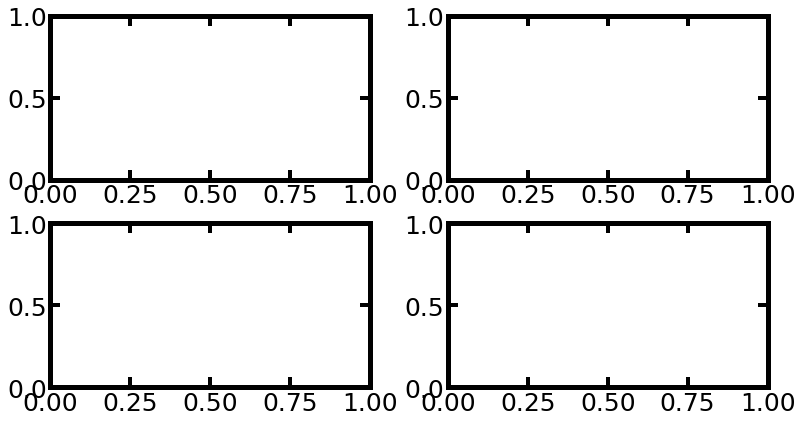

In [21]:
fig = plt.figure(figsize=(12,6))
ax3 = fig.add_axes([0.14,0.1,0.37,0.38])
ax4 = fig.add_axes([0.6,0.1,0.37,0.38])
ax1 = fig.add_axes([0.14,0.58,0.37,0.38])
ax2 = fig.add_axes([0.6,0.58,0.37,0.38])

#ax1.hist(res_b3.bootstrap_distribution[1], bins=25, density=True)
#ax2.hist(res_b6.bootstrap_distribution[1], bins=25, density=True)
#ax3.hist(res_b3.bootstrap_distribution[0], bins=25, density=True)
#ax4.hist(res_b6.bootstrap_distribution[0], bins=25, density=True)
#ax1.set_xscale('log')
#ax2.set_xscale('log')


In [22]:
def plot_core_to_yso2(ax, coredats, ysodats, coredats_err,ysodats_err_low, ysodats_err_high, coremass,  color='c'):
    epsilonset = []
    indexset=[]
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            finiteind = np.isfinite(ysodats[i])
            yerrset = add_asym.add_asym(ysodats[i][finiteind], ysodats[i][finiteind]-ysodats_err_low[i][finiteind], ysodats_err_high[i][finiteind]-ysodats[i][finiteind], order=1)
            epsilonset.append(yerrset[0]/coredat)
            indexset.append(i)
            if any(~np.isfinite(ysodats[i])):            
                ax.scatter(coremass[i], yerrset[0]/coredat,color=color, marker='o', facecolor='none',s=50)
            else:
                ax.scatter(coremass[i], yerrset[0]/coredat,color=color,s=50)
    
                
def plot_core_nfrag(ax, coredats, ysodats, coredats_err,ysodats_err_low, ysodats_err_high, coremass,  color='c'):
    epsilonset = []
    indexset=[]
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            finiteind = np.isfinite(ysodats[i])
            yerrset = add_asym.add_asym(ysodats[i][finiteind], ysodats[i][finiteind]-ysodats_err_low[i][finiteind], ysodats_err_high[i][finiteind]-ysodats[i][finiteind], order=1)
            epsilonset.append(yerrset[0]/coredat)
            indexset.append(i)
            if any(~np.isfinite(ysodats[i])):            
                ax.scatter(coremass[i], len(ysodats[i]),color=color, marker='o', facecolor='none',s=50)
            else:
                ax.scatter(coremass[i], len(ysodats[i]),color=color,s=50) 
                
def plot_epsilon_nfrag(ax, coredats, ysodats, coredats_err,ysodats_err_low, ysodats_err_high, color='c'):
    epsilonset = []
    indexset=[]
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            finiteind = np.isfinite(ysodats[i])
            yerrset = add_asym.add_asym(ysodats[i][finiteind], ysodats[i][finiteind]-ysodats_err_low[i][finiteind], ysodats_err_high[i][finiteind]-ysodats[i][finiteind], order=1)
            epsilonset.append(yerrset[0]/coredat)
            indexset.append(i)
            if any(~np.isfinite(ysodats[i])):            
                ax.scatter(len(ysodats[i]), yerrset[0]/coredat,color=color, marker='o', facecolor='none',s=50)
            else:
                ax.scatter(len(ysodats[i]), yerrset[0]/coredat,color=color,s=50) 
    
    #ax.errorbar(coremass[indexset], epsilonset,xerr=coremasserr[indexset],
    #        linestyle='',capsize=2.0, elinewidth=2, ecolor=color)
""" 
fig = plt.figure(figsize=(10,15))
ax3 = fig.add_axes([0.11,0.08,0.4,0.25])
ax4 = fig.add_axes([0.59,0.08,0.4,0.25])
ax1 = fig.add_axes([0.11,0.4,0.4,0.25])
ax2 = fig.add_axes([0.59,0.4,0.4,0.25])  
ax5 = fig.add_axes([0.11,0.72,0.4,0.25])
ax6 = fig.add_axes([0.59,0.72,0.4,0.25])  

plot_epsilon_nfrag(ax5, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff, corefluxerr_w51e_b6_woff,  ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff,color=cmap[0])
plot_epsilon_nfrag(ax6, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff, corefluxerr_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff  ,color=cmap[0])
plot_epsilon_nfrag(ax5, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff, corefluxerr_w51n_b6_woff,  ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff  ,color=cmap[1])
plot_epsilon_nfrag(ax6, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff, corefluxerr_w51n_b3_woff,  ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff  , 
                        color=cmap[1])
plot_core_nfrag(ax3, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff, corefluxerr_w51e_b6_woff,  ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff,coretemp_w51e_b6_woff,color=cmap[0])
plot_core_nfrag(ax4, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff, corefluxerr_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff  ,coretemp_w51e_b3_woff,color=cmap[0])
plot_core_nfrag(ax3, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff, corefluxerr_w51n_b6_woff,  ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff  ,coretemp_w51n_b6_woff,color=cmap[1])
plot_core_nfrag(ax4, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff, corefluxerr_w51n_b3_woff,  ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff  ,coretemp_w51n_b3_woff, 
                        color=cmap[1])
plot_core_to_yso2(ax1, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff, corefluxerr_w51e_b6_woff,  ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff, coretemp_w51e_b6_woff, color=cmap[0])
plot_core_to_yso2(ax2, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff, corefluxerr_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff, coretemp_w51e_b3_woff ,color=cmap[0])
plot_core_to_yso2(ax1, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff, corefluxerr_w51n_b6_woff,  ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff,  coretemp_w51n_b6_woff,color=cmap[1])
plot_core_to_yso2(ax2, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff, corefluxerr_w51n_b3_woff,  ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff, coretemp_w51n_b3_woff, 
                        color=cmap[1])
ax5.set_title('1.3mm',fontsize=30)
ax6.set_title('3mm',fontsize=30)
ax5.set_xlabel('$N_{frag}$')
ax6.set_xlabel('$N_{frag}$')
ax5.set_ylabel(r'$\epsilon_{frag}$',fontsize=30)
#ax6.set_ylabel(r'$\epsilon_{frag, 3mm}$')
ax3.set_xlabel('$T_{core}$')
ax4.set_xlabel('$T_{core}$')
ax3.set_xlim(10,90)
ax4.set_xlim(10,90)
ax1.set_xlim(10,90)
ax2.set_xlim(10,90)
ax5.set_xlim(0,7)
ax6.set_xlim(0,7)
ax5.set_ylim(-0.05,1.5)
ax6.set_ylim(-0.05,1.5)
ax1.set_ylim(-0.05,1.5)
ax2.set_ylim(-0.05,1.5)
ax3.set_ylim(0,7)
ax4.set_ylim(0,7)
ax5.set_xticks([0,2,4,6])
ax6.set_xticks([0,2,4,6])
ax5.set_yticks([0,0.5,1,1.5])
ax6.set_yticks([0,0.5,1,1.5])

ax6.legend(fontsize=15,handles=handles, frameon=False)
ax3.set_ylabel('$N_{frag}$')
#ax4.set_ylabel('$N_{frag}$')
ax1.set_xlabel('$T_{core}$')
ax2.set_xlabel('$T_{core}$')
ax1.set_ylabel(r'$\epsilon_{frag}$',fontsize=30)
#ax2.set_ylabel(r'$\epsilon_{frag, 3mm}$')
plt.savefig('epsilon_nfrag.png')
"""

" \nfig = plt.figure(figsize=(10,15))\nax3 = fig.add_axes([0.11,0.08,0.4,0.25])\nax4 = fig.add_axes([0.59,0.08,0.4,0.25])\nax1 = fig.add_axes([0.11,0.4,0.4,0.25])\nax2 = fig.add_axes([0.59,0.4,0.4,0.25])  \nax5 = fig.add_axes([0.11,0.72,0.4,0.25])\nax6 = fig.add_axes([0.59,0.72,0.4,0.25])  \n\nplot_epsilon_nfrag(ax5, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff, corefluxerr_w51e_b6_woff,  ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff,color=cmap[0])\nplot_epsilon_nfrag(ax6, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff, corefluxerr_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff  ,color=cmap[0])\nplot_epsilon_nfrag(ax5, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff, corefluxerr_w51n_b6_woff,  ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff  ,color=cmap[1])\nplot_epsilon_nfrag(ax6, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff, corefluxerr_w51n_b3_woff,  ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff  , \n                        color=cmap[1

In [23]:
"""
fig = plt.figure(figsize=(10,6))
ax5 = fig.add_axes([0.14,0.17,0.38,0.75])
ax6 = fig.add_axes([0.61,0.17,0.38,0.75])
def plot_core_yso_max_frags2(ax, coredats, ysodats, ysodats_err_low, ysodats_err_high, color='c'):
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            if any(np.isfinite(ysodats[i])):
                maxidx = np.nanargmax(ysodats[i])
                ax.errorbar(coredat, np.nanmax(ysodats[i]),  
                                yerr=np.array([[ysodats[i][maxidx] - ysodats_err_low[i][maxidx], 
                                                ysodats_err_high[i][maxidx] - ysodats[i][maxidx]]]).T,
                            capsize=2.0, elinewidth=2, ecolor=color)
                ax.scatter(coredat, np.nanmax(ysodats[i]),color=color,s=50)
plot_core_yso_max_frags2(ax5, coretemp_w51e_b6_woff, ysoflux_w51e_b6_woff,   ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff,color=cmap[0])
plot_core_yso_max_frags2(ax6, coretemp_w51e_b3_woff, ysoflux_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff  ,color=cmap[0])
plot_core_yso_max_frags2(ax5, coretemp_w51n_b6_woff, ysoflux_w51n_b6_woff,   ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff  ,color=cmap[1])
plot_core_yso_max_frags2(ax6, coretemp_w51n_b3_woff, ysoflux_w51n_b3_woff,   ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff  ,   color=cmap[1])
#ax5.plot([1e-2,5],[1e-2,5], ls='dashed', c='k')
#ax6.plot([5e-4,5e-1],[5e-4,5e-1], ls='dashed', c='k')
                    
#ax5.set_xscale('log')
ax5.set_yscale('log')
#ax6.set_xscale('log')
ax6.set_yscale('log')
ax5.set_ylim(1e-3,3e-1)
#ax5.set_xlim(1e-2,5)
ax6.set_ylim(1e-4,1e-1)

#ax6.set_xlim(5e-4,5e-1)
ax5.set_xlabel(r'$T_{\rm core}$ (K)')
ax6.set_xlabel(r'$T_{\rm core}$ (K)')
ax5.set_ylabel(r'$max(F_{\rm YSO})$ (Jy)')
#ax6.set_ylabel(r'$max(F_{\rm YSO, 3mm})$ (Jy)')

handles=[]
dummy_w51e = Line2D([0], [0], label='W51-E', marker='o', markersize=10, 
          markerfacecolor=cmap[0], linestyle='',markeredgecolor=cmap[0])
dummy_w51n = Line2D([0], [0], label='W51-IRS2', marker='o', markersize=10, 
          markerfacecolor=cmap[1], linestyle='',markeredgecolor=cmap[1])
handles.extend([dummy_w51e, dummy_w51n])
ax5.legend(handles=handles,fontsize=20, frameon=False)
ax5.set_title('1.3mm',fontsize=30)
ax6.set_title('3mm',fontsize=30)
"""


"\nfig = plt.figure(figsize=(10,6))\nax5 = fig.add_axes([0.14,0.17,0.38,0.75])\nax6 = fig.add_axes([0.61,0.17,0.38,0.75])\ndef plot_core_yso_max_frags2(ax, coredats, ysodats, ysodats_err_low, ysodats_err_high, color='c'):\n    for i, coredat in enumerate(coredats):\n        \n        if len(ysodats[i])>0:\n            lenx = len(ysodats[i])\n            if any(np.isfinite(ysodats[i])):\n                maxidx = np.nanargmax(ysodats[i])\n                ax.errorbar(coredat, np.nanmax(ysodats[i]),  \n                                yerr=np.array([[ysodats[i][maxidx] - ysodats_err_low[i][maxidx], \n                                                ysodats_err_high[i][maxidx] - ysodats[i][maxidx]]]).T,\n                            capsize=2.0, elinewidth=2, ecolor=color)\n                ax.scatter(coredat, np.nanmax(ysodats[i]),color=color,s=50)\nplot_core_yso_max_frags2(ax5, coretemp_w51e_b6_woff, ysoflux_w51e_b6_woff,   ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff,color=cmap[0

[2, 4, 16]
2
[2, 4, 16]
4
[1, 2, 6, 7, 10]
1
[1, 2, 6, 7, 10]
2
[1, 2, 6, 7, 10]
6
[1, 2, 6, 7, 10]
7
[1, 2, 6, 7, 10]
10


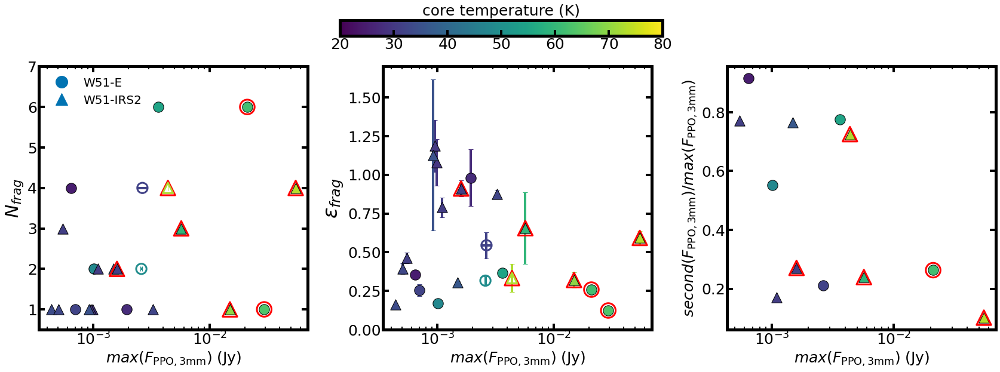

In [29]:
import seaborn as sns
import matplotlib
import matplotlib.cm as cm
from mpl_toolkits.axes_grid1.inset_locator import inset_axes



def plot_maxyso_frag2(ax1, ax2, ax3,cax, coredats, coredats_err, ysodats, ysodats_err,coretemp, marker='o', core_no=None, ind_red=None, ind_white=None):
    cmap = sns.color_palette("viridis", as_cmap=True)
    norm = matplotlib.colors.Normalize(vmin=20, vmax=80, clip=True)
   
    mapper = cm.ScalarMappable(norm=norm, cmap=cmap)
    color = np.array([(mapper.to_rgba(v)) for v in coretemp])
    
    
    
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            finiteind = np.isfinite(ysodats[i])
            lenx = len(ysodats[i])
            epsilon = np.nansum(ysodats[i])/coredat
            sumerr = np.linalg.norm(ysodats_err[i][finiteind])
            epsilonerr = epsilon * np.sqrt((sumerr/np.nansum(ysodats[i]))**2+(coredats_err[i]/coredat)**2)
            if any(np.isfinite(ysodats[i])):
                maxidx = np.nanargmax(ysodats[i])
                ax1.errorbar(np.nanmax(ysodats[i]), lenx, 
                                xerr=ysodats_err[i][maxidx],
                            capsize=4.0, elinewidth=4, color=color[i])
                if core_no[i] in ind_red:
                        ax1.scatter(np.nanmax(ysodats[i]), lenx, color='r',  facecolor='none',s=600,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
                #if core_no[i] in ind_white:
                #        ax1.scatter(np.nanmax(ysodats[i]), lenx, color='cyan',  facecolor='none',s=600,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
                if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                    ax1.scatter(np.nanmax(ysodats[i]), lenx, color=color[i],  facecolor='none',s=300,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
                   
                else:
                    ax1.scatter(np.nanmax(ysodats[i]), lenx, edgecolors='k',color=color[i],s=300, marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50)
                    
                ax2.errorbar(np.nanmax(ysodats[i]), epsilon, 
                                xerr=ysodats_err[i][maxidx],
                             yerr=epsilonerr,
                            capsize=4.0, elinewidth=4, color=color[i])
                if core_no[i] in ind_red:
                    
                    print(core_no[i])
                    ax2.scatter(np.nanmax(ysodats[i]), epsilon, color='r',  facecolor='none',s=600,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
                #if core_no[i] in ind_white:
                #    ax2.scatter(np.nanmax(ysodats[i]), epsilon, color='cyan',  facecolor='none',s=600,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
                if len(np.where(np.isfinite(ysodats[i])==True)[0])!=len(ysodats[i]):
                    pp=ax2.scatter(np.nanmax(ysodats[i]), epsilon, color=color[i],  facecolor='none',s=300,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
                else:
                    pp=ax2.scatter(np.nanmax(ysodats[i]), epsilon, edgecolors='k',color=color[i],s=300, marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50)
                
                if len(np.where(np.isfinite(ysodats[i])==True)[0])>1:
                    ysodats_finite = ysodats[i][np.isfinite(ysodats[i])]
                    ysodats_sort = np.sort(ysodats_finite)
                    ax3.scatter(np.nanmax(ysodats[i]), ysodats_sort[-2]/np.nanmax(ysodats[i]), color=color[i], edgecolors='k', s=300, marker=marker, vmin=20, vmax=80, cmap=cmap )
                    if core_no[i] in ind_red:
                        ax3.scatter(np.nanmax(ysodats[i]), ysodats_sort[-2]/np.nanmax(ysodats[i]), color='r',  facecolor='none',s=600,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
                    #if core_no[i] in ind_white:
                    #    ax3.scatter(np.nanmax(ysodats[i]), ysodats_sort[-2]/np.nanmax(ysodats[i]), color='cyan',  facecolor='none',s=600,marker=marker,vmin=20,vmax=80,cmap=cmap,zorder=50, lw=3)
               
   
    axcbr = fig.colorbar(mapper, cax=cax, orientation="horizontal", norm=norm, ticks=[20,30,40,50,60,70,80])

    axcbr.set_label('core temperature (K)', labelpad=-80)

hot_cores_w51e = [2,4,16]
hot_cores_intermediate_w51e = [13]
hot_cores_w51n = [1,2,6,7,10]
hot_cores_intermediate_w51n = [15,25,67]
fig = plt.figure(figsize=(25,9))
ax1 = fig.add_axes([0.07,0.13,0.25,0.68])
ax2 = fig.add_axes([0.39,0.13,0.25,0.68])
ax3 = fig.add_axes([0.71,0.13,0.25,0.68])
cax = fig.add_axes([0.35, 0.89, 0.3, 0.04])

coretemp_w51e_b6b3crit_b3fov = core_catdata_w51e_b3_b6b3crit_b3fov.get_temperature(Path.w51e_almaimf_coretemp)
coretemp_w51n_b6b3crit_b3fov = core_catdata_w51n_b3_b6b3crit_b3fov.get_temperature(Path.w51n_almaimf_coretemp)

no_w51e_b6b3crit_b3fov = core_catdata_w51e_b6_b6b3crit_b3fov.no[multiplicity_w51e_b6b3crit_b3fov[1]]
no_w51n_b6b3crit_b3fov = core_catdata_w51n_b6_b6b3crit_b3fov.no[multiplicity_w51n_b6b3crit_b3fov[1]]
plot_maxyso_frag2(ax1, ax2,ax3,  cax, coreflux_w51e_b3_b6b3crit_b3fov,  corefluxerr_w51e_b3_b6b3crit_b3fov, ysoflux_w51e_b3_b6b3crit_b3fov,  ysoflux_err_w51e_b3_b6b3crit_b3fov,  coretemp_w51e_b6b3crit_b3fov, marker='o',core_no=no_w51e_b6b3crit_b3fov, ind_red=hot_cores_w51e, ind_white=hot_cores_intermediate_w51e)
plot_maxyso_frag2(ax1, ax2,ax3,  cax,coreflux_w51n_b3_b6b3crit_b3fov, corefluxerr_w51n_b3_b6b3crit_b3fov, ysoflux_w51n_b3_b6b3crit_b3fov,   ysoflux_err_w51n_b3_b6b3crit_b3fov,  coretemp_w51n_b6b3crit_b3fov, marker='^', core_no=no_w51n_b6b3crit_b3fov, ind_red=hot_cores_w51n, ind_white=hot_cores_intermediate_w51n)

ax1.set_xscale('log')
ax2.set_xscale('log')
ax3.set_xscale('log')
ax3.set_xlabel(r'$max(F_{\rm PPO, 3mm})$ (Jy)')

ax2.set_xlabel(r'$max(F_{\rm PPO, 3mm})$ (Jy)')
ax1.set_xlabel(r'$max(F_{\rm PPO, 3mm})$ (Jy)')
ax1.set_ylabel('$N_{frag}$',fontsize=30)
ax2.set_ylabel(r'$\epsilon_{frag}$',fontsize=34)
ax3.set_ylabel(r'$second(F_{\rm PPO, 3mm})/max(F_{\rm PPO, 3mm})$')

handles=[]
dummy_w51e = Line2D([0], [0], label='W51-E', marker='o', markersize=20, 
          markerfacecolor=cmap[0], linestyle='',markeredgecolor=cmap[0])
dummy_w51n = Line2D([0], [0], label='W51-IRS2', marker='^', markersize=20, 
          markerfacecolor=cmap[0], linestyle='',markeredgecolor=cmap[0])
handles.extend([dummy_w51e, dummy_w51n])
ax1.legend(handles=handles,fontsize=20, frameon=False)
ax1.set_ylim(0.5,7)
ax2.set_ylim(0,1.7)
plt.savefig('n_frag_e_frag.png')

NameError: name 'coreflux_w51e_b6_woff' is not defined

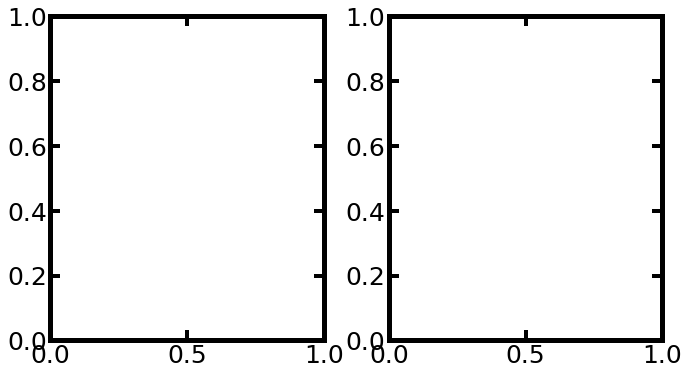

In [25]:
def plot_core_yso_max_nfrags(ax, coredats,ysodats, ysodats_err_low, ysodats_err_high, color='c'):
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            if any(np.isfinite(ysodats[i])):
                maxidx = np.nanargmax(ysodats[i])
                ax.errorbar(np.nanmax(ysodats[i]), len(ysodats[i]), 
                                xerr=np.array([[ysodats[i][maxidx] - ysodats_err_low[i][maxidx], 
                                                ysodats_err_high[i][maxidx] - ysodats[i][maxidx]]]).T,
                            capsize=2.0, elinewidth=2, ecolor=color)
                ax.scatter(np.nanmax(ysodats[i]),len(ysodats[i]),color=color,s=50)
                
fig = plt.figure(figsize=(10,6))
ax5 = fig.add_axes([0.14,0.17,0.38,0.75])
ax6 = fig.add_axes([0.61,0.17,0.38,0.75])

plot_core_yso_max_nfrags(ax5, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff,   ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff,color=cmap[0])
plot_core_yso_max_nfrags(ax6, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff  ,color=cmap[0])
plot_core_yso_max_nfrags(ax5, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff,   ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff  ,color=cmap[1])
plot_core_yso_max_nfrags(ax6, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff,   ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff  ,   color=cmap[1])
#ax5.plot([1e-2,5],[1e-2,5], ls='dashed', c='k')
#ax6.plot([5e-4,5e-1],[5e-4,5e-1], ls='dashed', c='k')
                    
ax5.set_xscale('log')
#ax5.set_yscale('log')
ax6.set_xscale('log')
#ax6.set_yscale('log')
#ax5.set_ylim(1e-3,3e-1)
#ax5.set_xlim(1e-2,5)
#ax6.set_ylim(1e-4,1e-1)

#ax6.set_xlim(5e-4,5e-1)
ax5.set_xlabel(r'$max(F_{\rm YSO, 1.3mm})$ (Jy)')
ax6.set_xlabel(r'$max(F_{\rm YSO, 3mm})$ (Jy)')
#ax6.set_ylabel(r'$max(F_{\rm YSO, 3mm})$ (Jy)')
ax5.set_ylabel('$N_{frag}$')
ax6.set_ylabel('$N_{frag}$')
handles=[]
dummy_w51e = Line2D([0], [0], label='W51-E', marker='o', markersize=10, 
          markerfacecolor=cmap[0], linestyle='',markeredgecolor=cmap[0])
dummy_w51n = Line2D([0], [0], label='W51-IRS2', marker='o', markersize=10, 
          markerfacecolor=cmap[1], linestyle='',markeredgecolor=cmap[1])
handles.extend([dummy_w51e, dummy_w51n])
ax5.legend(handles=handles,fontsize=20, frameon=False)
ax5.set_title('1.3mm',fontsize=30)
ax6.set_title('3mm',fontsize=30)
                

In [ ]:
def plot_core_yso_max_efrags(ax, coredats,ysodats, ysodats_err_low, ysodats_err_high, color='c'):
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            if any(np.isfinite(ysodats[i])):
                maxidx = np.nanargmax(ysodats[i])
                ax.errorbar(np.nanmax(ysodats[i]), len(ysodats[i]), 
                                xerr=np.array([[ysodats[i][maxidx] - ysodats_err_low[i][maxidx], 
                                                ysodats_err_high[i][maxidx] - ysodats[i][maxidx]]]).T,
                            capsize=2.0, elinewidth=2, ecolor=color)
                ax.scatter(np.nanmax(ysodats[i]),len(ysodats[i]),color=color,s=50)
plot_core_yso_max_efrags(ax5, coreflux_w51e_b6_woff, ysoflux_w51e_b6_woff,   ysoflux_lowerr_w51e_b6_woff, ysoflux_upperr_w51e_b6_woff,color=cmap[0])
plot_core_yso_max_efrags(ax6, coreflux_w51e_b3_woff, ysoflux_w51e_b3_woff,  ysoflux_lowerr_w51e_b3_woff, ysoflux_upperr_w51e_b3_woff  ,color=cmap[0])
plot_core_yso_max_efrags(ax5, coreflux_w51n_b6_woff, ysoflux_w51n_b6_woff,   ysoflux_lowerr_w51n_b6_woff, ysoflux_upperr_w51n_b6_woff  ,color=cmap[1])
plot_core_yso_max_efrags(ax6, coreflux_w51n_b3_woff, ysoflux_w51n_b3_woff,   ysoflux_lowerr_w51n_b3_woff, ysoflux_upperr_w51n_b3_woff  ,   color=cmap[1])


In [ ]:
def plot_core_eps_nfrag(ax, coredats, ysodats, coredats_err,ysodats_err_low, ysodats_err_high, coremass,  color='c'):
    epsilonset = []
    indexset=[]
    for i, coredat in enumerate(coredats):
        
        if len(ysodats[i])>0:
            lenx = len(ysodats[i])
            finiteind = np.isfinite(ysodats[i])
            yerrset = add_asym.add_asym(ysodats[i][finiteind], ysodats[i][finiteind]-ysodats_err_low[i][finiteind], ysodats_err_high[i][finiteind]-ysodats[i][finiteind], order=1)
            epsilonset.append(yerrset[0]/coredat)
            indexset.append(i)
            if any(~np.isfinite(ysodats[i])):            
                ax.scatter(coremass[i], len(ysodats[i]),color=color, marker='o', facecolor='none',s=50)
            else:
                ax.scatter(coremass[i], len(ysodats[i]),color=color,s=50)
fig = plt.figure(figsize=(10,12))
ax3 = fig.add_axes([0.14,0.1,0.37,0.38])
ax4 = fig.add_axes([0.6,0.1,0.37,0.38])

#ax3 = fig.add_axes([0.1,0.41,0.38,0.25])
#ax4 = fig.add_axes([0.58,0.41,0.38,0.25])

ax1 = fig.add_axes([0.14,0.58,0.37,0.38])
ax2 = fig.add_axes([0.6,0.58,0.37,0.38])









In [ ]:
ysosize_b6_w51e = np.sqrt(catalog_w51e_yso['deconvolved_major_b6'].value * catalog_w51e_yso['deconvolved_minor_b6'].value) * 2 / 2.355 * np.pi/180 * 5.41*1000*206265*4.84814e-6
ysosize_b3_w51e = np.sqrt(catalog_w51e_yso['deconvolved_major_b3'].value * catalog_w51e_yso['deconvolved_minor_b3'].value)* 2 / 2.355 * np.pi/180 * 5.41*1000*206265*4.84814e-6
ysosize_b6_w51n = np.sqrt(catalog_w51n_yso['deconvolved_major_b6'].value * catalog_w51n_yso['deconvolved_minor_b6'].value)* 2 / 2.355 * np.pi/180 * 5.1*1000*206265*4.84814e-6
ysosize_b3_w51n = np.sqrt(catalog_w51n_yso['deconvolved_major_b3'].value * catalog_w51n_yso['deconvolved_minor_b3'].value)* 2 / 2.355 * np.pi/180 * 5.1*1000*206265*4.84814e-6

ysosize_b6_w51e_min = np.min(ysosize_b6_w51e[ysosize_b6_w51e>0])
ysosize_b3_w51e_min = np.min(ysosize_b3_w51e[ysosize_b3_w51e>0])
ysosize_b6_w51n_min = np.min(ysosize_b6_w51n[ysosize_b6_w51n>0])
ysosize_b3_w51n_min = np.min(ysosize_b6_w51n[ysosize_b3_w51n>0])

w51e_unresolved = np.logical_or(ysosize_b6_w51e==0, ysosize_b6_w51e==0)
w51n_unresolved = np.logical_or(ysosize_b6_w51n==0, ysosize_b6_w51n==0)

ysosize_b6_w51e[ysosize_b6_w51e==0] = ysosize_b6_w51e_min/2
ysosize_b3_w51e[ysosize_b3_w51e==0] = ysosize_b3_w51e_min/2
ysosize_b6_w51n[ysosize_b6_w51n==0] = ysosize_b6_w51n_min/2
ysosize_b3_w51n[ysosize_b3_w51n==0] = ysosize_b3_w51n_min/2


print(ysosize_b6_w51e_min,ysosize_b3_w51e_min,ysosize_b6_w51n_min,ysosize_b3_w51n_min)

def get_avg_sizes(b3size, b6size):
    avgsize=[]
    for i in range(len(b6size)):
        b6size_selected = b6size[i]
        b3size_selected = b3size[i]
        print(i,b6size_selected,b3size_selected)
        if not np.isfinite(b6size_selected):
            b6size_selected = b3size_selected
        if not np.isfinite(b3size_selected):
            b3size_selected = b6size_selected
        print(i,b6size_selected,b3size_selected)

        avgsize.append(np.mean([b6size_selected, b3size_selected]))
    
    return np.array(avgsize)
    
#find sources of which sizes are nan (undetected) or 0 (not resolved)
ysosize_avg_w51e = get_avg_sizes(ysosize_b3_w51e, ysosize_b6_w51e)
ysosize_avg_w51n = get_avg_sizes(ysosize_b3_w51n, ysosize_b6_w51n)

print(ysosize_b6_w51e.mask)


#ysosize_avg_w51e = np.mean(np.vstack((ysosize_b6_w51e, ysosize_b3_w51e)),axis=0)
#ysosize_avg_w51n = np.mean(np.vstack((ysosize_b6_w51n, ysosize_b3_w51n)),axis=0)

ysosize_w51e_b6_woff = [ysosize_b6_w51e[ind].data for ind in ysoindarr_w51e_woff]
ysosize_w51e_b3_woff = [ysosize_b3_w51e[ind].data for ind in ysoindarr_w51e_woff_b3] 
print(len(ysosize_w51e_b6_woff))

ysosize_w51n_b6_woff = [ysosize_b6_w51n[ind].data for ind in ysoindarr_w51n_woff]
ysosize_w51n_b3_woff = [ysosize_b3_w51n[ind].data for ind in ysoindarr_w51n_woff_b3]

ysosize_w51e_avg_woff = [ysosize_avg_w51e[ind].data for ind in ysoindarr_w51e_woff]
ysosize_w51n_avg_woff = [ysosize_avg_w51n[ind].data for ind in ysoindarr_w51n_woff]

ysosize_w51e_avg_wff = [ysosize_avg_w51e[ind].data for ind in ysoindarr_w51e_wff]
ysosize_w51n_avg_wff = [ysosize_avg_w51n[ind].data for ind in ysoindarr_w51n_b6fov_wff]




ysosize_w51e_b6_woff_flat = [item for sublist in ysosize_w51e_b6_woff for item in sublist]
ysosize_w51e_b3_woff_flat = [item for sublist in ysosize_w51e_b3_woff for item in sublist]
ysosize_w51n_b6_woff_flat = [item for sublist in ysosize_w51n_b6_woff for item in sublist]
ysosize_w51n_b3_woff_flat = [item for sublist in ysosize_w51n_b3_woff for item in sublist]

fluxratio_w51e_b6_woff_flat = [ysoflux/coreflux_w51e_b6_woff[i] for i, sublist in enumerate(ysoflux_w51e_b6_woff) for ysoflux in sublist]
fluxratio_w51e_b3_woff_flat = [ysoflux/coreflux_w51e_b3_woff[i] for i, sublist in enumerate(ysoflux_w51e_b3_woff) for ysoflux in sublist]
fluxratio_w51n_b6_woff_flat = [ysoflux/coreflux_w51n_b6_woff[i] for i, sublist in enumerate(ysoflux_w51n_b6_woff) for ysoflux in sublist]
fluxratio_w51n_b3_woff_flat = [ysoflux/coreflux_w51n_b3_woff[i] for i, sublist in enumerate(ysoflux_w51n_b3_woff) for ysoflux in sublist]

fig = plt.figure(figsize=(16,6))
ax1 = fig.add_axes([0.1,0.17,0.38,0.75])
ax2 = fig.add_axes([0.58,0.17,0.38,0.75])


ax1.scatter(ysosize_w51e_b6_woff_flat, fluxratio_w51e_b6_woff_flat, c=cmap[0])
ax1.scatter(ysosize_w51n_b6_woff_flat, fluxratio_w51n_b6_woff_flat, c=cmap[1])
ax2.scatter(ysosize_w51e_b3_woff_flat, fluxratio_w51e_b3_woff_flat, c=cmap[0])
ax2.scatter(ysosize_w51n_b3_woff_flat, fluxratio_w51n_b3_woff_flat, c=cmap[1])

ax1.set_xlabel('deconvolved size (au)')
ax1.set_ylabel('$F_{YSO, 1.3mm}/F_{core, 1.3mm}$')

ax2.set_xlabel('deconvolved size (au)')
ax2.set_ylabel('$F_{YSO, 3mm}/F_{core, 3mm}$')



In [ ]:
import csv
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.cm as cm

def plot_core_yso_frag_rates(ax, coredats, ysodats, color='r', marker='o'):
    #coredats, ysodats -> size
    print(len(coredats),len(ysodats))
    for i, coredat in enumerate(coredats):
        if len(ysodats[i])>0:
            phi_2d = np.log(len(ysodats[i])) / np.log(coredat/np.mean(ysodats[i]))
            phi_3d = phi_2d / 0.7
            print(len(ysodats[i]), coredat, np.mean(ysodats[i]), phi_3d)
            ax.scatter(coredat, phi_3d, color=color,s=30, marker=marker)
            

dat = np.loadtxt(open("../model/fragmentation_table.csv", "rb"), delimiter=",", skiprows=1)
scale_tab = dat[:,0]
fig = plt.figure(figsize=(10,8))
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])

cmap2=sns.color_palette("viridis", as_cmap=True)

norm = mpl.colors.Normalize(vmin=0, vmax=9, clip=True)
mapper = cm.ScalarMappable(norm=norm, cmap=cmap2)
color= np.array([(mapper.to_rgba(v)) for v in range(9)])
#cmap2= plt.get_cmap('bkr',9)
xiarr = [-1.0, -0.75, -0.5, -0.25, 0, 0.25, 0.5, 0.75, 1.0]
for i in range(9):
    xscale = 10 * 1.5
    yscale = 8*2
    ax1.plot(scale_tab, dat[:,i+1], color=color[i])
    ind = np.argmin(np.abs(scale_tab-0.04))
    rotn = np.arctan2((dat[ind+1,i+1]-dat[ind,i+1])*yscale, 
                      (np.log10(scale_tab[ind+1])-np.log10(scale_tab[ind]))*xscale)*(180)/np.pi+180
    ax1.annotate(r'$\xi=%3.2f$'%xiarr[i], xy=(0.04,dat[ind,i+1]-0.1), rotation=rotn, fontsize=20, annotation_clip=True)
    print(i,dat[ind,i+1], rotn)

    print(cmap2(i))

coresize_w51e_b6_woff = size_w51e_b6[coreindarr_w51e_b6fov_woff]
coresize_w51e_b3_woff = size_w51e_b3[coreindarr_w51e_b3fov_woff]

coresize_w51n_b6_woff = size_w51n_b6[coreindarr_w51n_b6fov_woff]
coresize_w51n_b3_woff = size_w51n_b3[coreindarr_w51n_b3fov_woff]
print(ysosize_w51e_b6_woff)

#ysosize_w51e_avg_woff = np.nanmean(np.vstack([ysosize_w51e_b6_woff, ysosize_w51e_b3_woff])*4.84814e-6, axis=1)
#ysosize_w51n_avg_woff = np.nanmean(np.vstack([ysosize_w51n_b6_woff, ysosize_w51n_b3_woff])*4.84814e-6, axis=1)

coresize_w51e_b6_wff = size_w51e_b6[coreindarr_w51e_wff]
coresize_w51e_b3_wff = size_w51e_b3[coreindarr_w51e_b3fov_wff]

coresize_w51n_b6_wff = size_w51n_b6[coreindarr_w51n_b6fov_wff]
coresize_w51n_b3_wff = size_w51n_b3[coreindarr_w51n_b3fov_wff]

#ysosize_w51e_avg_wff = np.nanmean(np.vstack([ysosize_w51e_b6_wff, ysosize_w51e_b3_wff])*4.84814e-6, axis=1)
#ysosize_w51n_avg_wff = np.nanmean(np.vstack([ysosize_w51n_b6_wff, ysosize_w51n_b3_wff])*4.84814e-6, axis=1)

plot_core_yso_frag_rates(ax1, coresize_w51e_b6_woff*4.84814e-6, ysosize_w51e_avg_woff, color=cmap[0])
plot_core_yso_frag_rates(ax1, coresize_w51n_b6_woff*4.84814e-6, ysosize_w51n_avg_woff, color=cmap[1])
plot_core_yso_frag_rates(ax1, coresize_w51e_b6_wff*4.84814e-6, ysosize_w51e_avg_wff, color=cmap[0], marker='x')
plot_core_yso_frag_rates(ax1, coresize_w51n_b6_wff*4.84814e-6, ysosize_w51n_avg_wff, color=cmap[1], marker='x')
ax1.hlines(5e-5,1,-1,color='k',ls='dashed',lw=3)
ax1.set_xscale('log')
ax1.set_xlabel('R (pc)')
ax1.set_ylabel(r'$\phi$ (fragmentation rate)')
ax1.set_ylim(-0.5,1.5)
ax1.set_xlim(1e-3,1e-1)